In [5]:
import os
import numpy as np
import matplotlib.pyplot as plt
from tqdm import tqdm  # performance timing

# Building on Keras
from keras.layers import Input
from keras.models import Model, Sequential
from keras.layers.core import Dense, Dropout
from keras.layers.advanced_activations import LeakyReLU
from keras.datasets import fashion_mnist
from keras.optimizers import Adam
from keras import initializers

In [2]:
np.random.seed(10)
random_dim = 100
 
def load_minst_data():
    # load the data - we'll use Fashion MNIST, for a change of pace
    (x_train, y_train), (x_test, y_test) = fashion_mnist.load_data()
    # normalize our inputs to be in the range[-1, 1] 
    x_train = (x_train.astype(np.float32) - 127.5)/127.5
    # convert x_train with a shape of (60000, 28, 28) to (60000, 784) so we have
    # 784 columns per row
    x_train = x_train.reshape(60000, 784)
    return (x_train, y_train, x_test, y_test)

In [3]:
def get_discriminator(optimizer):
    discriminator = Sequential()
    discriminator.add(Dense(
        1024, input_dim=784,
        kernel_initializer=initializers.RandomNormal(stddev=0.02)))
    discriminator.add(LeakyReLU(0.2))
    discriminator.add(Dropout(0.3))
 
    discriminator.add(Dense(512))
    discriminator.add(LeakyReLU(0.2))
    discriminator.add(Dropout(0.3))
 
    discriminator.add(Dense(256))
    discriminator.add(LeakyReLU(0.2))
    discriminator.add(Dropout(0.3))
 
    discriminator.add(Dense(1, activation='sigmoid'))
    discriminator.compile(loss='binary_crossentropy', optimizer=optimizer)
    return discriminator

def get_generator(optimizer):
    generator = Sequential()
    generator.add(Dense(
        256, input_dim=random_dim,
        kernel_initializer=initializers.RandomNormal(stddev=0.02)))
    generator.add(LeakyReLU(0.2))
 
    generator.add(Dense(512))
    generator.add(LeakyReLU(0.2))
 
    generator.add(Dense(1024))
    generator.add(LeakyReLU(0.2))
 
    generator.add(Dense(784, activation='tanh'))
    generator.compile(loss='binary_crossentropy', optimizer=optimizer)
    return generator

def get_gan_network(discriminator, random_dim, generator, optimizer):
    # We initially set trainable to False since we only want to train either the 
    # generator or discriminator at a time
    discriminator.trainable = False
    # gan input (noise) will be 100-dimensional vectors
    gan_input = Input(shape=(random_dim,))
    # the output of the generator (an image)
    x = generator(gan_input)
    # get the output of the discriminator (probability if the image is real/not)
    gan_output = discriminator(x)
    gan = Model(inputs=gan_input, outputs=gan_output)
    gan.compile(loss='binary_crossentropy', optimizer=optimizer)
    return gan

def plot_generated_images(epoch, generator, examples=100, dim=(10, 10),
                          figsize=(10, 10)):
    noise = np.random.normal(0, 1, size=[examples, random_dim])
    generated_images = generator.predict(noise)
    generated_images = generated_images.reshape(examples, 28, 28)
 
    plt.figure(figsize=figsize)
    for i in range(generated_images.shape[0]):
        plt.subplot(dim[0], dim[1], i+1)
        plt.imshow(generated_images[i], interpolation='nearest', cmap='gray_r')
        plt.axis('off')
    plt.tight_layout()
    plt.savefig('gan_generated_image_epoch_%d.png' % epoch)

--------------- Epoch 1 ---------------


100%|████████████████████████████████████████████████████████████████████████████████| 937/937 [00:24<00:00, 37.89it/s]


--------------- Epoch 2 ---------------


100%|████████████████████████████████████████████████████████████████████████████████| 937/937 [00:10<00:00, 90.37it/s]


--------------- Epoch 3 ---------------


100%|████████████████████████████████████████████████████████████████████████████████| 937/937 [00:10<00:00, 90.21it/s]


--------------- Epoch 4 ---------------


100%|████████████████████████████████████████████████████████████████████████████████| 937/937 [00:10<00:00, 91.57it/s]


--------------- Epoch 5 ---------------


100%|████████████████████████████████████████████████████████████████████████████████| 937/937 [00:10<00:00, 89.89it/s]


--------------- Epoch 6 ---------------


100%|████████████████████████████████████████████████████████████████████████████████| 937/937 [00:10<00:00, 90.27it/s]


--------------- Epoch 7 ---------------


100%|████████████████████████████████████████████████████████████████████████████████| 937/937 [00:10<00:00, 89.94it/s]


--------------- Epoch 8 ---------------


100%|████████████████████████████████████████████████████████████████████████████████| 937/937 [00:10<00:00, 89.84it/s]


--------------- Epoch 9 ---------------


100%|████████████████████████████████████████████████████████████████████████████████| 937/937 [00:10<00:00, 88.51it/s]


--------------- Epoch 10 ---------------


100%|████████████████████████████████████████████████████████████████████████████████| 937/937 [00:10<00:00, 90.64it/s]


--------------- Epoch 11 ---------------


 56%|█████████████████████████████████████████████                                   | 528/937 [00:05<00:04, 91.20it/s]


KeyboardInterrupt: 

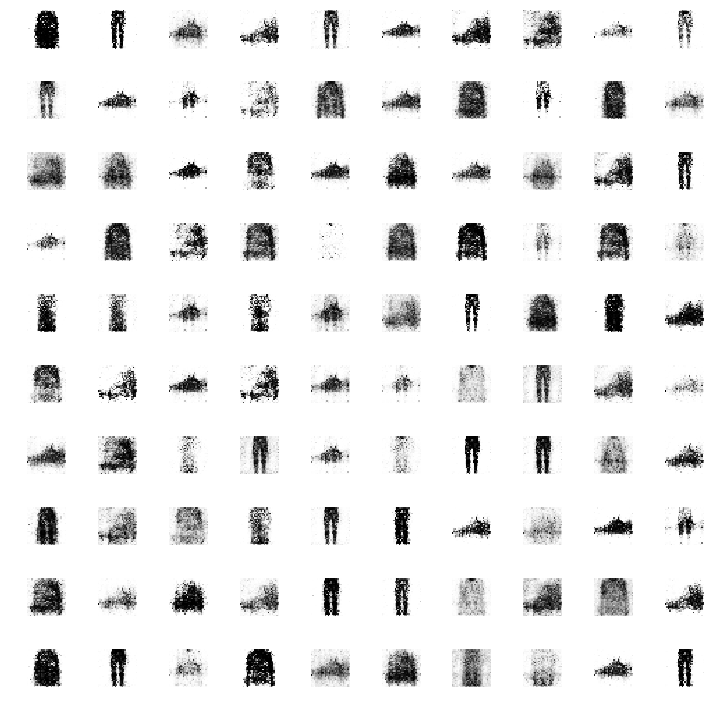

In [61]:
x_train, y_train, x_test, y_test = load_minst_data()
def train(epochs=1, batch_size=128, x_train=x_train):
    # Get the training and testing data
    # Split the training data into batches of size 128
    batch_count = x_train.shape[0] // batch_size
 
    # Build our GAN netowrk
    adam = Adam(lr=0.0002, beta_1=0.5)
    generator = get_generator(adam)
    discriminator = get_discriminator(adam)
    gan = get_gan_network(discriminator, random_dim, generator, adam)
 
    for e in range(1, epochs+1):
        print ('-'*15, 'Epoch %d' % e, '-'*15)
        for _ in tqdm(range(batch_count)):
            # Get a random set of input noise and images
            noise = np.random.normal(0, 1, size=[batch_size, random_dim])
            image_batch = x_train[np.random.randint(0, x_train.shape[0],
                                                    size=batch_size)]
 
            # Generate fake MNIST images
            generated_images = generator.predict(noise)
            X = np.concatenate([image_batch, generated_images])
 
            # Labels for generated and real data
            y_dis = np.zeros(2*batch_size)
            # One-sided label smoothing
            y_dis[:batch_size] = 0.9
 
            # Train discriminator
            discriminator.trainable = True
            discriminator.train_on_batch(X, y_dis)
 
            # Train generator
            noise = np.random.normal(0, 1, size=[batch_size, random_dim])
            y_gen = np.ones(batch_size)
            discriminator.trainable = False
            gan.train_on_batch(noise, y_gen)
 
        if e == 1 or e % 20 == 0:
            plot_generated_images(e, generator)
 
train(40, 64)

In [62]:
x_train.shape

(60000, 784)

In [7]:
!pip install emoji_data_python
!wget https://github.com/LambdaSchool/DS-Unit-4-Sprint-4-Deep-Learning/raw/master/module3-generative-adversarial-networks/emoji.zip
!unzip emoji.zip

You are using pip version 19.0.1, however version 19.0.3 is available.
You should consider upgrading via the 'python -m pip install --upgrade pip' command.
'wget' is not recognized as an internal or external command,
operable program or batch file.
'unzip' is not recognized as an internal or external command,
operable program or batch file.


In [41]:
import os
emojis = os.listdir("emoji/")

In [36]:
import imageio
import matplotlib.pyplot as plt
from skimage import color
grayscale_emojis = np.array()
example_emoji = imageio.imread('emoji/1f635.png')
grayscale_emoji = color.rgb2gray(example_emoji)
grayscale_emojis.append(grayscale_emoji)


In [57]:
grayscale_emojis = []
for i in emojis:
    g = imageio.imread('emoji/'+i)
    g = color.rgb2gray(g)
    g = np.resize(g,(784,))
    grayscale_emojis.append(g)

In [58]:
grayscale_emojis = np.asarray(grayscale_emojis)

In [59]:
grayscale_emojis

array([[0.65730157, 0.65730157, 0.65730157, ..., 0.65730157, 0.65730157,
        0.65730157],
       [0.65730157, 0.65730157, 0.65730157, ..., 0.65730157, 0.65730157,
        0.65730157],
       [1.        , 0.76189922, 0.76189922, ..., 0.76189922, 1.        ,
        1.        ],
       ...,
       [1.        , 1.        , 1.        , ..., 1.        , 1.        ,
        1.        ],
       [0.46815686, 0.46815686, 0.46815686, ..., 0.46815686, 0.46815686,
        0.46815686],
       [0.51406471, 0.51406471, 0.51406471, ..., 0.51406471, 0.51406471,
        0.51406471]])

In [64]:
grayscale_emojis[0].shape

(784,)

In [30]:
len(grayscale_emoji)

28

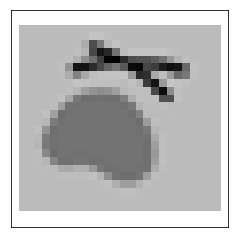

In [32]:
from PIL import Image, ImageOps

def show_images(img):
    plt.figure()
    plt.imshow(np.asarray(grayscale_emoji), cmap='gray')
    #lt.title(img)
    plt.grid(False)
    plt.yticks([])
    plt.xticks([])
    plt.show()

show_images(grayscale_emoji)

--------------- Epoch 1 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:02<00:00,  4.84it/s]


--------------- Epoch 2 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.47it/s]


--------------- Epoch 3 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.04it/s]


--------------- Epoch 4 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.00it/s]


--------------- Epoch 5 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.19it/s]


--------------- Epoch 6 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.79it/s]


--------------- Epoch 7 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.64it/s]


--------------- Epoch 8 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.78it/s]


--------------- Epoch 9 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.32it/s]


--------------- Epoch 10 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.78it/s]


--------------- Epoch 11 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 83.26it/s]


--------------- Epoch 12 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 89.02it/s]


--------------- Epoch 13 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.76it/s]


--------------- Epoch 14 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 89.04it/s]


--------------- Epoch 15 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 90.74it/s]


--------------- Epoch 16 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 89.05it/s]


--------------- Epoch 17 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 89.04it/s]


--------------- Epoch 18 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.48it/s]


--------------- Epoch 19 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.64it/s]


--------------- Epoch 20 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 90.18it/s]


--------------- Epoch 21 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 83.76it/s]


--------------- Epoch 22 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.85it/s]


--------------- Epoch 23 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.76it/s]


--------------- Epoch 24 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.51it/s]


--------------- Epoch 25 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 89.61it/s]


--------------- Epoch 26 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.48it/s]


--------------- Epoch 27 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.93it/s]


--------------- Epoch 28 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 89.89it/s]


--------------- Epoch 29 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 89.89it/s]


--------------- Epoch 30 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.79it/s]


--------------- Epoch 31 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 89.04it/s]


--------------- Epoch 32 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.75it/s]


--------------- Epoch 33 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 90.76it/s]


--------------- Epoch 34 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 89.89it/s]


--------------- Epoch 35 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 89.04it/s]


--------------- Epoch 36 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.48it/s]


--------------- Epoch 37 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.93it/s]


--------------- Epoch 38 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 90.16it/s]


--------------- Epoch 39 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.21it/s]


--------------- Epoch 40 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.92it/s]


--------------- Epoch 41 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.58it/s]


--------------- Epoch 42 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.39it/s]


--------------- Epoch 43 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.58it/s]


--------------- Epoch 44 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.58it/s]


--------------- Epoch 45 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 83.76it/s]


--------------- Epoch 46 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.58it/s]


--------------- Epoch 47 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.79it/s]


--------------- Epoch 48 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 89.61it/s]


--------------- Epoch 49 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 90.18it/s]


--------------- Epoch 50 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.96it/s]


--------------- Epoch 51 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.21it/s]


--------------- Epoch 52 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.78it/s]


--------------- Epoch 53 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.26it/s]


--------------- Epoch 54 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.77it/s]


--------------- Epoch 55 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.21it/s]


--------------- Epoch 56 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.93it/s]


--------------- Epoch 57 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 89.04it/s]


--------------- Epoch 58 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.75it/s]


--------------- Epoch 59 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.66it/s]


--------------- Epoch 60 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.93it/s]


--------------- Epoch 61 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 81.58it/s]


--------------- Epoch 62 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.94it/s]


--------------- Epoch 63 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.58it/s]


--------------- Epoch 64 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.32it/s]


--------------- Epoch 65 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.76it/s]


--------------- Epoch 66 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.53it/s]


--------------- Epoch 67 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 83.51it/s]


--------------- Epoch 68 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 91.70it/s]


--------------- Epoch 69 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.78it/s]


--------------- Epoch 70 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 89.61it/s]


--------------- Epoch 71 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.01it/s]


--------------- Epoch 72 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 89.02it/s]


--------------- Epoch 73 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.19it/s]


--------------- Epoch 74 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.10it/s]


--------------- Epoch 75 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 80.19it/s]


--------------- Epoch 76 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.74it/s]


--------------- Epoch 77 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 89.04it/s]


--------------- Epoch 78 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 89.02it/s]


--------------- Epoch 79 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 89.04it/s]


--------------- Epoch 80 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 82.29it/s]


--------------- Epoch 81 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.12it/s]


--------------- Epoch 82 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.76it/s]


--------------- Epoch 83 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.93it/s]


--------------- Epoch 84 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.39it/s]


--------------- Epoch 85 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.21it/s]


--------------- Epoch 86 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.58it/s]


--------------- Epoch 87 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 90.16it/s]


--------------- Epoch 88 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.21it/s]


--------------- Epoch 89 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.66it/s]


--------------- Epoch 90 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.85it/s]


--------------- Epoch 91 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.91it/s]


--------------- Epoch 92 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 89.04it/s]


--------------- Epoch 93 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.10it/s]


--------------- Epoch 94 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 91.35it/s]


--------------- Epoch 95 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.19it/s]


--------------- Epoch 96 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.76it/s]


--------------- Epoch 97 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.95it/s]


--------------- Epoch 98 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.21it/s]


--------------- Epoch 99 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 89.05it/s]


--------------- Epoch 100 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 89.32it/s]


--------------- Epoch 101 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 83.51it/s]


--------------- Epoch 102 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 89.32it/s]


--------------- Epoch 103 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.76it/s]


--------------- Epoch 104 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.27it/s]


--------------- Epoch 105 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.93it/s]


--------------- Epoch 106 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.21it/s]


--------------- Epoch 107 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 89.04it/s]


--------------- Epoch 108 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.26it/s]


--------------- Epoch 109 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 89.89it/s]


--------------- Epoch 110 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 89.89it/s]


--------------- Epoch 111 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.12it/s]


--------------- Epoch 112 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.48it/s]


--------------- Epoch 113 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 89.61it/s]


--------------- Epoch 114 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.32it/s]


--------------- Epoch 115 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 89.04it/s]


--------------- Epoch 116 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.48it/s]


--------------- Epoch 117 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.32it/s]


--------------- Epoch 118 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 89.61it/s]


--------------- Epoch 119 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 89.04it/s]


--------------- Epoch 120 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.76it/s]


--------------- Epoch 121 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.39it/s]


--------------- Epoch 122 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.12it/s]


--------------- Epoch 123 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 89.89it/s]


--------------- Epoch 124 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 89.61it/s]


--------------- Epoch 125 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.05it/s]


--------------- Epoch 126 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.01it/s]


--------------- Epoch 127 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.22it/s]


--------------- Epoch 128 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.32it/s]


--------------- Epoch 129 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.92it/s]


--------------- Epoch 130 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.48it/s]


--------------- Epoch 131 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.58it/s]


--------------- Epoch 132 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 90.76it/s]


--------------- Epoch 133 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.21it/s]


--------------- Epoch 134 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 91.33it/s]


--------------- Epoch 135 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.05it/s]


--------------- Epoch 136 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.48it/s]


--------------- Epoch 137 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 90.47it/s]


--------------- Epoch 138 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.48it/s]


--------------- Epoch 139 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.12it/s]


--------------- Epoch 140 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 90.18it/s]


--------------- Epoch 141 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 82.53it/s]


--------------- Epoch 142 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 89.32it/s]


--------------- Epoch 143 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.53it/s]


--------------- Epoch 144 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.05it/s]


--------------- Epoch 145 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 89.61it/s]


--------------- Epoch 146 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.12it/s]


--------------- Epoch 147 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.53it/s]


--------------- Epoch 148 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 90.76it/s]


--------------- Epoch 149 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 89.04it/s]


--------------- Epoch 150 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.85it/s]


--------------- Epoch 151 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.26it/s]


--------------- Epoch 152 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 89.89it/s]


--------------- Epoch 153 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.21it/s]


--------------- Epoch 154 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.39it/s]


--------------- Epoch 155 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 90.18it/s]


--------------- Epoch 156 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 90.18it/s]


--------------- Epoch 157 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.39it/s]


--------------- Epoch 158 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.76it/s]


--------------- Epoch 159 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.76it/s]


--------------- Epoch 160 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.58it/s]


--------------- Epoch 161 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.83it/s]


--------------- Epoch 162 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.76it/s]


--------------- Epoch 163 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.75it/s]


--------------- Epoch 164 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.79it/s]


--------------- Epoch 165 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.58it/s]


--------------- Epoch 166 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.21it/s]


--------------- Epoch 167 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.76it/s]


--------------- Epoch 168 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.39it/s]


--------------- Epoch 169 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 89.32it/s]


--------------- Epoch 170 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.12it/s]


--------------- Epoch 171 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 89.54it/s]


--------------- Epoch 172 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 90.16it/s]


--------------- Epoch 173 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.83it/s]


--------------- Epoch 174 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 89.89it/s]


--------------- Epoch 175 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 90.16it/s]


--------------- Epoch 176 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 89.89it/s]


--------------- Epoch 177 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.66it/s]


--------------- Epoch 178 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.47it/s]


--------------- Epoch 179 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.76it/s]


--------------- Epoch 180 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.75it/s]


--------------- Epoch 181 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.13it/s]


--------------- Epoch 182 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 90.47it/s]


--------------- Epoch 183 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.28it/s]


--------------- Epoch 184 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.75it/s]


--------------- Epoch 185 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.12it/s]


--------------- Epoch 186 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.26it/s]


--------------- Epoch 187 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.21it/s]


--------------- Epoch 188 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.02it/s]


--------------- Epoch 189 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.85it/s]


--------------- Epoch 190 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 83.02it/s]


--------------- Epoch 191 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 90.18it/s]


--------------- Epoch 192 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.39it/s]


--------------- Epoch 193 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.67it/s]


--------------- Epoch 194 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 89.32it/s]


--------------- Epoch 195 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 90.18it/s]


--------------- Epoch 196 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.10it/s]


--------------- Epoch 197 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 90.18it/s]


--------------- Epoch 198 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 89.61it/s]


--------------- Epoch 199 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.81it/s]


--------------- Epoch 200 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 90.16it/s]


--------------- Epoch 201 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.79it/s]


--------------- Epoch 202 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.26it/s]


--------------- Epoch 203 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 90.45it/s]


--------------- Epoch 204 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 91.05it/s]


--------------- Epoch 205 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 90.18it/s]


--------------- Epoch 206 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.93it/s]


--------------- Epoch 207 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.75it/s]


--------------- Epoch 208 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.66it/s]


--------------- Epoch 209 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.05it/s]


--------------- Epoch 210 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 89.04it/s]


--------------- Epoch 211 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 90.18it/s]


--------------- Epoch 212 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.58it/s]


--------------- Epoch 213 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 89.89it/s]


--------------- Epoch 214 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 90.16it/s]


--------------- Epoch 215 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 89.89it/s]


--------------- Epoch 216 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.57it/s]


--------------- Epoch 217 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 89.61it/s]


--------------- Epoch 218 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 90.18it/s]


--------------- Epoch 219 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.21it/s]


--------------- Epoch 220 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.19it/s]


--------------- Epoch 221 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 90.47it/s]


--------------- Epoch 222 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.27it/s]


--------------- Epoch 223 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 92.54it/s]


--------------- Epoch 224 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 91.64it/s]


--------------- Epoch 225 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.53it/s]


--------------- Epoch 226 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 91.94it/s]


--------------- Epoch 227 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 90.76it/s]


--------------- Epoch 228 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.76it/s]


--------------- Epoch 229 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.32it/s]


--------------- Epoch 230 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 89.61it/s]


--------------- Epoch 231 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 89.89it/s]


--------------- Epoch 232 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.39it/s]


--------------- Epoch 233 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 92.54it/s]


--------------- Epoch 234 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.21it/s]


--------------- Epoch 235 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.32it/s]


--------------- Epoch 236 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 90.18it/s]


--------------- Epoch 237 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 91.64it/s]


--------------- Epoch 238 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 92.54it/s]


--------------- Epoch 239 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.87it/s]


--------------- Epoch 240 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 89.32it/s]


--------------- Epoch 241 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.01it/s]


--------------- Epoch 242 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.48it/s]


--------------- Epoch 243 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.66it/s]


--------------- Epoch 244 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.12it/s]


--------------- Epoch 245 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.39it/s]


--------------- Epoch 246 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.12it/s]


--------------- Epoch 247 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.39it/s]


--------------- Epoch 248 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 91.35it/s]


--------------- Epoch 249 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.79it/s]


--------------- Epoch 250 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.39it/s]


--------------- Epoch 251 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 89.03it/s]


--------------- Epoch 252 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.21it/s]


--------------- Epoch 253 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 89.03it/s]


--------------- Epoch 254 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.66it/s]


--------------- Epoch 255 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 89.32it/s]


--------------- Epoch 256 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 91.07it/s]


--------------- Epoch 257 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.21it/s]


--------------- Epoch 258 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 90.18it/s]


--------------- Epoch 259 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 89.62it/s]


--------------- Epoch 260 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 89.60it/s]


--------------- Epoch 261 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.39it/s]


--------------- Epoch 262 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 89.57it/s]


--------------- Epoch 263 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.39it/s]


--------------- Epoch 264 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.76it/s]


--------------- Epoch 265 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.66it/s]


--------------- Epoch 266 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.02it/s]


--------------- Epoch 267 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.93it/s]


--------------- Epoch 268 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 89.61it/s]


--------------- Epoch 269 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 89.61it/s]


--------------- Epoch 270 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.05it/s]


--------------- Epoch 271 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.76it/s]


--------------- Epoch 272 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.76it/s]


--------------- Epoch 273 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 89.32it/s]


--------------- Epoch 274 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 90.18it/s]


--------------- Epoch 275 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 90.76it/s]


--------------- Epoch 276 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 89.61it/s]


--------------- Epoch 277 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 90.18it/s]


--------------- Epoch 278 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.21it/s]


--------------- Epoch 279 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.12it/s]


--------------- Epoch 280 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.05it/s]


--------------- Epoch 281 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.58it/s]


--------------- Epoch 282 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.66it/s]


--------------- Epoch 283 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.01it/s]


--------------- Epoch 284 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 91.94it/s]


--------------- Epoch 285 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 91.05it/s]


--------------- Epoch 286 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 89.89it/s]


--------------- Epoch 287 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.21it/s]


--------------- Epoch 288 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 89.89it/s]


--------------- Epoch 289 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 89.89it/s]


--------------- Epoch 290 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 92.24it/s]


--------------- Epoch 291 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 90.47it/s]


--------------- Epoch 292 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 89.32it/s]


--------------- Epoch 293 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 90.18it/s]


--------------- Epoch 294 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 91.35it/s]


--------------- Epoch 295 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 89.89it/s]


--------------- Epoch 296 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 91.64it/s]


--------------- Epoch 297 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 90.76it/s]


--------------- Epoch 298 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 91.94it/s]


--------------- Epoch 299 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 89.32it/s]


--------------- Epoch 300 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 89.04it/s]


--------------- Epoch 301 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.76it/s]


--------------- Epoch 302 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.51it/s]


--------------- Epoch 303 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.27it/s]


--------------- Epoch 304 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.39it/s]


--------------- Epoch 305 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.39it/s]


--------------- Epoch 306 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.61it/s]


--------------- Epoch 307 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 89.89it/s]


--------------- Epoch 308 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 82.53it/s]


--------------- Epoch 309 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 80.65it/s]


--------------- Epoch 310 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 77.76it/s]


--------------- Epoch 311 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.48it/s]


--------------- Epoch 312 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 90.18it/s]


--------------- Epoch 313 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.32it/s]


--------------- Epoch 314 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.01it/s]


--------------- Epoch 315 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.58it/s]


--------------- Epoch 316 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 90.47it/s]


--------------- Epoch 317 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 89.61it/s]


--------------- Epoch 318 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 91.64it/s]


--------------- Epoch 319 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 90.74it/s]


--------------- Epoch 320 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.48it/s]


--------------- Epoch 321 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.79it/s]


--------------- Epoch 322 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.76it/s]


--------------- Epoch 323 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 79.06it/s]


--------------- Epoch 324 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.26it/s]


--------------- Epoch 325 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 83.51it/s]


--------------- Epoch 326 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 81.58it/s]


--------------- Epoch 327 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 83.26it/s]


--------------- Epoch 328 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 83.26it/s]


--------------- Epoch 329 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 83.51it/s]


--------------- Epoch 330 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.02it/s]


--------------- Epoch 331 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.72it/s]


--------------- Epoch 332 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.21it/s]


--------------- Epoch 333 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 83.99it/s]


--------------- Epoch 334 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.05it/s]


--------------- Epoch 335 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 83.51it/s]


--------------- Epoch 336 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.75it/s]


--------------- Epoch 337 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.26it/s]


--------------- Epoch 338 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.26it/s]


--------------- Epoch 339 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.48it/s]


--------------- Epoch 340 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.93it/s]


--------------- Epoch 341 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 78.62it/s]


--------------- Epoch 342 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 76.70it/s]


--------------- Epoch 343 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 82.53it/s]


--------------- Epoch 344 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 82.29it/s]


--------------- Epoch 345 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 82.77it/s]


--------------- Epoch 346 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 82.77it/s]


--------------- Epoch 347 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.01it/s]


--------------- Epoch 348 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 78.19it/s]


--------------- Epoch 349 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 82.05it/s]


--------------- Epoch 350 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 83.26it/s]


--------------- Epoch 351 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 77.97it/s]


--------------- Epoch 352 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 81.34it/s]


--------------- Epoch 353 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 82.53it/s]


--------------- Epoch 354 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 79.51it/s]


--------------- Epoch 355 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 82.05it/s]


--------------- Epoch 356 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.01it/s]


--------------- Epoch 357 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 83.02it/s]


--------------- Epoch 358 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.79it/s]


--------------- Epoch 359 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 83.51it/s]


--------------- Epoch 360 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 81.11it/s]


--------------- Epoch 361 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 78.83it/s]


--------------- Epoch 362 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 83.51it/s]


--------------- Epoch 363 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 80.19it/s]


--------------- Epoch 364 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.53it/s]


--------------- Epoch 365 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.79it/s]


--------------- Epoch 366 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.01it/s]


--------------- Epoch 367 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.53it/s]


--------------- Epoch 368 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.85it/s]


--------------- Epoch 369 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 77.97it/s]


--------------- Epoch 370 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 81.58it/s]


--------------- Epoch 371 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.76it/s]


--------------- Epoch 372 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 82.53it/s]


--------------- Epoch 373 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 83.26it/s]


--------------- Epoch 374 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.85it/s]


--------------- Epoch 375 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 83.51it/s]


--------------- Epoch 376 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.79it/s]


--------------- Epoch 377 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 83.76it/s]


--------------- Epoch 378 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.32it/s]


--------------- Epoch 379 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.05it/s]


--------------- Epoch 380 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.05it/s]


--------------- Epoch 381 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 82.03it/s]


--------------- Epoch 382 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 83.02it/s]


--------------- Epoch 383 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.01it/s]


--------------- Epoch 384 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.26it/s]


--------------- Epoch 385 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.27it/s]


--------------- Epoch 386 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 83.76it/s]


--------------- Epoch 387 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 81.81it/s]


--------------- Epoch 388 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.53it/s]


--------------- Epoch 389 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.32it/s]


--------------- Epoch 390 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 82.53it/s]


--------------- Epoch 391 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.76it/s]


--------------- Epoch 392 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.58it/s]


--------------- Epoch 393 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 81.81it/s]


--------------- Epoch 394 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.53it/s]


--------------- Epoch 395 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.26it/s]


--------------- Epoch 396 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.05it/s]


--------------- Epoch 397 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.51it/s]


--------------- Epoch 398 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.26it/s]


--------------- Epoch 399 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 82.77it/s]


--------------- Epoch 400 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 81.11it/s]
C:\Users\cwcol\Anaconda3\lib\site-packages\matplotlib\pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


--------------- Epoch 401 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 83.76it/s]


--------------- Epoch 402 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 80.42it/s]


--------------- Epoch 403 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 83.76it/s]


--------------- Epoch 404 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 80.65it/s]


--------------- Epoch 405 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 80.88it/s]


--------------- Epoch 406 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.44it/s]


--------------- Epoch 407 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 79.73it/s]


--------------- Epoch 408 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 83.26it/s]


--------------- Epoch 409 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.01it/s]


--------------- Epoch 410 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 83.76it/s]


--------------- Epoch 411 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.05it/s]


--------------- Epoch 412 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 81.81it/s]


--------------- Epoch 413 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 83.02it/s]


--------------- Epoch 414 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.53it/s]


--------------- Epoch 415 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 80.65it/s]


--------------- Epoch 416 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 80.19it/s]


--------------- Epoch 417 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.27it/s]


--------------- Epoch 418 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 83.26it/s]


--------------- Epoch 419 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.27it/s]


--------------- Epoch 420 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 83.00it/s]


--------------- Epoch 421 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.26it/s]


--------------- Epoch 422 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.01it/s]


--------------- Epoch 423 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 80.19it/s]


--------------- Epoch 424 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 82.53it/s]


--------------- Epoch 425 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.51it/s]


--------------- Epoch 426 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 83.51it/s]


--------------- Epoch 427 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.76it/s]


--------------- Epoch 428 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.27it/s]


--------------- Epoch 429 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 83.02it/s]


--------------- Epoch 430 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.06it/s]


--------------- Epoch 431 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 83.77it/s]


--------------- Epoch 432 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.51it/s]


--------------- Epoch 433 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.58it/s]


--------------- Epoch 434 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.02it/s]


--------------- Epoch 435 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 80.88it/s]


--------------- Epoch 436 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 79.73it/s]


--------------- Epoch 437 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 80.64it/s]


--------------- Epoch 438 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 83.26it/s]


--------------- Epoch 439 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 82.05it/s]


--------------- Epoch 440 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 80.65it/s]


--------------- Epoch 441 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.27it/s]


--------------- Epoch 442 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 83.99it/s]


--------------- Epoch 443 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.93it/s]


--------------- Epoch 444 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.75it/s]


--------------- Epoch 445 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.93it/s]


--------------- Epoch 446 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.20it/s]


--------------- Epoch 447 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 78.19it/s]


--------------- Epoch 448 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 81.11it/s]


--------------- Epoch 449 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 83.02it/s]


--------------- Epoch 450 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 82.29it/s]


--------------- Epoch 451 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.21it/s]


--------------- Epoch 452 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 83.99it/s]


--------------- Epoch 453 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.85it/s]


--------------- Epoch 454 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.38it/s]


--------------- Epoch 455 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 89.59it/s]


--------------- Epoch 456 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 89.30it/s]


--------------- Epoch 457 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.57it/s]


--------------- Epoch 458 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.76it/s]


--------------- Epoch 459 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.76it/s]


--------------- Epoch 460 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.52it/s]


--------------- Epoch 461 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.12it/s]


--------------- Epoch 462 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.64it/s]


--------------- Epoch 463 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.91it/s]


--------------- Epoch 464 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.48it/s]


--------------- Epoch 465 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.66it/s]


--------------- Epoch 466 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.19it/s]


--------------- Epoch 467 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.39it/s]


--------------- Epoch 468 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 80.20it/s]


--------------- Epoch 469 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 80.42it/s]


--------------- Epoch 470 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.26it/s]


--------------- Epoch 471 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.51it/s]


--------------- Epoch 472 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.93it/s]


--------------- Epoch 473 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.37it/s]


--------------- Epoch 474 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.37it/s]


--------------- Epoch 475 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.32it/s]


--------------- Epoch 476 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.51it/s]


--------------- Epoch 477 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.93it/s]


--------------- Epoch 478 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 89.32it/s]


--------------- Epoch 479 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.47it/s]


--------------- Epoch 480 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.53it/s]


--------------- Epoch 481 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.05it/s]


--------------- Epoch 482 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.85it/s]


--------------- Epoch 483 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.02it/s]


--------------- Epoch 484 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.66it/s]


--------------- Epoch 485 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.32it/s]


--------------- Epoch 486 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.85it/s]


--------------- Epoch 487 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.12it/s]


--------------- Epoch 488 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.39it/s]


--------------- Epoch 489 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.58it/s]


--------------- Epoch 490 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.79it/s]


--------------- Epoch 491 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.85it/s]


--------------- Epoch 492 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 83.76it/s]


--------------- Epoch 493 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.26it/s]


--------------- Epoch 494 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.85it/s]


--------------- Epoch 495 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 83.26it/s]


--------------- Epoch 496 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.12it/s]


--------------- Epoch 497 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.02it/s]


--------------- Epoch 498 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.39it/s]


--------------- Epoch 499 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.39it/s]


--------------- Epoch 500 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.51it/s]


--------------- Epoch 501 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.02it/s]


--------------- Epoch 502 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.12it/s]


--------------- Epoch 503 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.58it/s]


--------------- Epoch 504 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.58it/s]


--------------- Epoch 505 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.93it/s]


--------------- Epoch 506 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.39it/s]


--------------- Epoch 507 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.39it/s]


--------------- Epoch 508 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.76it/s]


--------------- Epoch 509 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.58it/s]


--------------- Epoch 510 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.51it/s]


--------------- Epoch 511 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.58it/s]


--------------- Epoch 512 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.60it/s]


--------------- Epoch 513 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.58it/s]


--------------- Epoch 514 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.93it/s]


--------------- Epoch 515 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.48it/s]


--------------- Epoch 516 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.39it/s]


--------------- Epoch 517 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.58it/s]


--------------- Epoch 518 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 83.76it/s]


--------------- Epoch 519 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 90.18it/s]


--------------- Epoch 520 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.12it/s]


--------------- Epoch 521 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.12it/s]


--------------- Epoch 522 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.93it/s]


--------------- Epoch 523 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.12it/s]


--------------- Epoch 524 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.39it/s]


--------------- Epoch 525 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.21it/s]


--------------- Epoch 526 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.66it/s]


--------------- Epoch 527 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.85it/s]


--------------- Epoch 528 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.21it/s]


--------------- Epoch 529 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.85it/s]


--------------- Epoch 530 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.66it/s]


--------------- Epoch 531 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 83.51it/s]


--------------- Epoch 532 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.32it/s]


--------------- Epoch 533 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.53it/s]


--------------- Epoch 534 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.58it/s]


--------------- Epoch 535 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.54it/s]


--------------- Epoch 536 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 83.47it/s]


--------------- Epoch 537 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.19it/s]


--------------- Epoch 538 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.76it/s]


--------------- Epoch 539 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.94it/s]


--------------- Epoch 540 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 90.16it/s]


--------------- Epoch 541 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.02it/s]


--------------- Epoch 542 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.27it/s]


--------------- Epoch 543 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.85it/s]


--------------- Epoch 544 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.21it/s]


--------------- Epoch 545 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 89.61it/s]


--------------- Epoch 546 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 89.61it/s]


--------------- Epoch 547 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 89.04it/s]


--------------- Epoch 548 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.76it/s]


--------------- Epoch 549 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 89.90it/s]


--------------- Epoch 550 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.66it/s]


--------------- Epoch 551 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.19it/s]


--------------- Epoch 552 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.74it/s]


--------------- Epoch 553 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 89.03it/s]


--------------- Epoch 554 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.05it/s]


--------------- Epoch 555 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.19it/s]


--------------- Epoch 556 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.91it/s]


--------------- Epoch 557 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.93it/s]


--------------- Epoch 558 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.76it/s]


--------------- Epoch 559 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.37it/s]


--------------- Epoch 560 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.93it/s]


--------------- Epoch 561 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 82.29it/s]


--------------- Epoch 562 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.01it/s]


--------------- Epoch 563 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.53it/s]


--------------- Epoch 564 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 77.33it/s]


--------------- Epoch 565 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 83.02it/s]


--------------- Epoch 566 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.85it/s]


--------------- Epoch 567 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.85it/s]


--------------- Epoch 568 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.53it/s]


--------------- Epoch 569 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.12it/s]


--------------- Epoch 570 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.39it/s]


--------------- Epoch 571 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.27it/s]


--------------- Epoch 572 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.02it/s]


--------------- Epoch 573 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.01it/s]


--------------- Epoch 574 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.79it/s]


--------------- Epoch 575 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.01it/s]


--------------- Epoch 576 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.58it/s]


--------------- Epoch 577 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.58it/s]


--------------- Epoch 578 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 89.04it/s]


--------------- Epoch 579 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 89.04it/s]


--------------- Epoch 580 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.21it/s]


--------------- Epoch 581 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.76it/s]


--------------- Epoch 582 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.05it/s]


--------------- Epoch 583 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 83.26it/s]


--------------- Epoch 584 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 80.88it/s]


--------------- Epoch 585 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 79.51it/s]


--------------- Epoch 586 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.39it/s]


--------------- Epoch 587 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.85it/s]


--------------- Epoch 588 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.32it/s]


--------------- Epoch 589 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 83.76it/s]


--------------- Epoch 590 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.02it/s]


--------------- Epoch 591 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.51it/s]


--------------- Epoch 592 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 80.42it/s]


--------------- Epoch 593 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.32it/s]


--------------- Epoch 594 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.66it/s]


--------------- Epoch 595 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.85it/s]


--------------- Epoch 596 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.05it/s]


--------------- Epoch 597 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.02it/s]


--------------- Epoch 598 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.32it/s]


--------------- Epoch 599 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.12it/s]


--------------- Epoch 600 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 83.51it/s]


--------------- Epoch 601 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.26it/s]


--------------- Epoch 602 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.53it/s]


--------------- Epoch 603 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.01it/s]


--------------- Epoch 604 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.58it/s]


--------------- Epoch 605 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.51it/s]


--------------- Epoch 606 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.01it/s]


--------------- Epoch 607 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.05it/s]


--------------- Epoch 608 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.21it/s]


--------------- Epoch 609 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.66it/s]


--------------- Epoch 610 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.12it/s]


--------------- Epoch 611 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.51it/s]


--------------- Epoch 612 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 80.19it/s]


--------------- Epoch 613 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.58it/s]


--------------- Epoch 614 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.21it/s]


--------------- Epoch 615 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.58it/s]


--------------- Epoch 616 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.12it/s]


--------------- Epoch 617 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.53it/s]


--------------- Epoch 618 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.76it/s]


--------------- Epoch 619 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.02it/s]


--------------- Epoch 620 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.79it/s]


--------------- Epoch 621 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.27it/s]


--------------- Epoch 622 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.85it/s]


--------------- Epoch 623 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.53it/s]


--------------- Epoch 624 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.05it/s]


--------------- Epoch 625 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.12it/s]


--------------- Epoch 626 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.02it/s]


--------------- Epoch 627 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.85it/s]


--------------- Epoch 628 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.79it/s]


--------------- Epoch 629 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.05it/s]


--------------- Epoch 630 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.32it/s]


--------------- Epoch 631 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.05it/s]


--------------- Epoch 632 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 83.02it/s]


--------------- Epoch 633 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.79it/s]


--------------- Epoch 634 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.85it/s]


--------------- Epoch 635 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.39it/s]


--------------- Epoch 636 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.12it/s]


--------------- Epoch 637 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.66it/s]


--------------- Epoch 638 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.58it/s]


--------------- Epoch 639 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.39it/s]


--------------- Epoch 640 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.86it/s]


--------------- Epoch 641 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 83.99it/s]


--------------- Epoch 642 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.78it/s]


--------------- Epoch 643 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.79it/s]


--------------- Epoch 644 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.32it/s]


--------------- Epoch 645 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.30it/s]


--------------- Epoch 646 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.93it/s]


--------------- Epoch 647 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.85it/s]


--------------- Epoch 648 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.64it/s]


--------------- Epoch 649 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.92it/s]


--------------- Epoch 650 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.21it/s]


--------------- Epoch 651 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.64it/s]


--------------- Epoch 652 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.92it/s]


--------------- Epoch 653 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 83.76it/s]


--------------- Epoch 654 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.94it/s]


--------------- Epoch 655 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.32it/s]


--------------- Epoch 656 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.57it/s]


--------------- Epoch 657 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.53it/s]


--------------- Epoch 658 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.58it/s]


--------------- Epoch 659 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.01it/s]


--------------- Epoch 660 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.10it/s]


--------------- Epoch 661 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.02it/s]


--------------- Epoch 662 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.76it/s]


--------------- Epoch 663 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.79it/s]


--------------- Epoch 664 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.12it/s]


--------------- Epoch 665 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.10it/s]


--------------- Epoch 666 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.53it/s]


--------------- Epoch 667 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.05it/s]


--------------- Epoch 668 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.55it/s]


--------------- Epoch 669 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.05it/s]


--------------- Epoch 670 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.87it/s]


--------------- Epoch 671 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.38it/s]


--------------- Epoch 672 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.39it/s]


--------------- Epoch 673 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.76it/s]


--------------- Epoch 674 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.02it/s]


--------------- Epoch 675 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.12it/s]


--------------- Epoch 676 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.03it/s]


--------------- Epoch 677 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.27it/s]


--------------- Epoch 678 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.11it/s]


--------------- Epoch 679 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.76it/s]


--------------- Epoch 680 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.58it/s]


--------------- Epoch 681 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.01it/s]


--------------- Epoch 682 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.26it/s]


--------------- Epoch 683 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.02it/s]


--------------- Epoch 684 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.12it/s]


--------------- Epoch 685 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.12it/s]


--------------- Epoch 686 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.85it/s]


--------------- Epoch 687 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.04it/s]


--------------- Epoch 688 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.78it/s]


--------------- Epoch 689 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.51it/s]


--------------- Epoch 690 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.58it/s]


--------------- Epoch 691 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.12it/s]


--------------- Epoch 692 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.39it/s]


--------------- Epoch 693 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.05it/s]


--------------- Epoch 694 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.79it/s]


--------------- Epoch 695 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.58it/s]


--------------- Epoch 696 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.48it/s]


--------------- Epoch 697 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.12it/s]


--------------- Epoch 698 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.39it/s]


--------------- Epoch 699 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.66it/s]


--------------- Epoch 700 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.66it/s]


--------------- Epoch 701 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.51it/s]


--------------- Epoch 702 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.79it/s]


--------------- Epoch 703 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 83.76it/s]


--------------- Epoch 704 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.02it/s]


--------------- Epoch 705 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.78it/s]


--------------- Epoch 706 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.32it/s]


--------------- Epoch 707 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.32it/s]


--------------- Epoch 708 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.10it/s]


--------------- Epoch 709 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 82.29it/s]


--------------- Epoch 710 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 83.76it/s]


--------------- Epoch 711 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.30it/s]


--------------- Epoch 712 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.92it/s]


--------------- Epoch 713 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.19it/s]


--------------- Epoch 714 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.37it/s]


--------------- Epoch 715 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.76it/s]


--------------- Epoch 716 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.26it/s]


--------------- Epoch 717 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.85it/s]


--------------- Epoch 718 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.84it/s]


--------------- Epoch 719 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.32it/s]


--------------- Epoch 720 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.39it/s]


--------------- Epoch 721 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.76it/s]


--------------- Epoch 722 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.02it/s]


--------------- Epoch 723 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.01it/s]


--------------- Epoch 724 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.02it/s]


--------------- Epoch 725 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.58it/s]


--------------- Epoch 726 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.32it/s]


--------------- Epoch 727 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.94it/s]


--------------- Epoch 728 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.58it/s]


--------------- Epoch 729 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.02it/s]


--------------- Epoch 730 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.85it/s]


--------------- Epoch 731 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.76it/s]


--------------- Epoch 732 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.27it/s]


--------------- Epoch 733 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.05it/s]


--------------- Epoch 734 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.66it/s]


--------------- Epoch 735 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.53it/s]


--------------- Epoch 736 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.85it/s]


--------------- Epoch 737 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.27it/s]


--------------- Epoch 738 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.79it/s]


--------------- Epoch 739 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.79it/s]


--------------- Epoch 740 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.32it/s]


--------------- Epoch 741 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.05it/s]


--------------- Epoch 742 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 83.74it/s]


--------------- Epoch 743 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 83.51it/s]


--------------- Epoch 744 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.92it/s]


--------------- Epoch 745 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.37it/s]


--------------- Epoch 746 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.32it/s]


--------------- Epoch 747 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.67it/s]


--------------- Epoch 748 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.19it/s]


--------------- Epoch 749 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.30it/s]


--------------- Epoch 750 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.60it/s]


--------------- Epoch 751 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.53it/s]


--------------- Epoch 752 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.53it/s]


--------------- Epoch 753 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.04it/s]


--------------- Epoch 754 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.83it/s]


--------------- Epoch 755 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.03it/s]


--------------- Epoch 756 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.58it/s]


--------------- Epoch 757 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.85it/s]


--------------- Epoch 758 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.00it/s]


--------------- Epoch 759 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.01it/s]


--------------- Epoch 760 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.66it/s]


--------------- Epoch 761 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 89.02it/s]


--------------- Epoch 762 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.75it/s]


--------------- Epoch 763 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 90.18it/s]


--------------- Epoch 764 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 83.51it/s]


--------------- Epoch 765 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.57it/s]


--------------- Epoch 766 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.64it/s]


--------------- Epoch 767 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.81it/s]


--------------- Epoch 768 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.48it/s]


--------------- Epoch 769 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.93it/s]


--------------- Epoch 770 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.76it/s]


--------------- Epoch 771 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.21it/s]


--------------- Epoch 772 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.40it/s]


--------------- Epoch 773 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.58it/s]


--------------- Epoch 774 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.58it/s]


--------------- Epoch 775 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.04it/s]


--------------- Epoch 776 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.51it/s]


--------------- Epoch 777 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.33it/s]


--------------- Epoch 778 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.79it/s]


--------------- Epoch 779 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.27it/s]


--------------- Epoch 780 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.51it/s]


--------------- Epoch 781 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.24it/s]


--------------- Epoch 782 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.02it/s]


--------------- Epoch 783 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.12it/s]


--------------- Epoch 784 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 83.76it/s]


--------------- Epoch 785 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.76it/s]


--------------- Epoch 786 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.85it/s]


--------------- Epoch 787 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.85it/s]


--------------- Epoch 788 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.05it/s]


--------------- Epoch 789 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.05it/s]


--------------- Epoch 790 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.79it/s]


--------------- Epoch 791 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.27it/s]


--------------- Epoch 792 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.12it/s]


--------------- Epoch 793 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.85it/s]


--------------- Epoch 794 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.53it/s]


--------------- Epoch 795 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.39it/s]


--------------- Epoch 796 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.32it/s]


--------------- Epoch 797 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.79it/s]


--------------- Epoch 798 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.79it/s]


--------------- Epoch 799 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.85it/s]


--------------- Epoch 800 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.05it/s]


--------------- Epoch 801 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.79it/s]


--------------- Epoch 802 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 83.76it/s]


--------------- Epoch 803 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.27it/s]


--------------- Epoch 804 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.85it/s]


--------------- Epoch 805 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.51it/s]


--------------- Epoch 806 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.32it/s]


--------------- Epoch 807 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.60it/s]


--------------- Epoch 808 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 83.76it/s]


--------------- Epoch 809 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 82.77it/s]


--------------- Epoch 810 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.32it/s]


--------------- Epoch 811 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.64it/s]


--------------- Epoch 812 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.66it/s]


--------------- Epoch 813 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.48it/s]


--------------- Epoch 814 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.39it/s]


--------------- Epoch 815 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.33it/s]


--------------- Epoch 816 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.47it/s]


--------------- Epoch 817 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.21it/s]


--------------- Epoch 818 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.93it/s]


--------------- Epoch 819 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.85it/s]


--------------- Epoch 820 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.21it/s]


--------------- Epoch 821 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.05it/s]


--------------- Epoch 822 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.32it/s]


--------------- Epoch 823 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.51it/s]


--------------- Epoch 824 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.66it/s]


--------------- Epoch 825 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.76it/s]


--------------- Epoch 826 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.85it/s]


--------------- Epoch 827 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.66it/s]


--------------- Epoch 828 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.12it/s]


--------------- Epoch 829 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.27it/s]


--------------- Epoch 830 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.85it/s]


--------------- Epoch 831 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.39it/s]


--------------- Epoch 832 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.12it/s]


--------------- Epoch 833 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.79it/s]


--------------- Epoch 834 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.53it/s]


--------------- Epoch 835 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.53it/s]


--------------- Epoch 836 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.39it/s]


--------------- Epoch 837 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.05it/s]


--------------- Epoch 838 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.93it/s]


--------------- Epoch 839 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.27it/s]


--------------- Epoch 840 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.79it/s]


--------------- Epoch 841 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.32it/s]


--------------- Epoch 842 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.79it/s]


--------------- Epoch 843 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.85it/s]


--------------- Epoch 844 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.79it/s]


--------------- Epoch 845 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.27it/s]


--------------- Epoch 846 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.79it/s]


--------------- Epoch 847 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.85it/s]


--------------- Epoch 848 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.05it/s]


--------------- Epoch 849 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.05it/s]


--------------- Epoch 850 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.02it/s]


--------------- Epoch 851 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.05it/s]


--------------- Epoch 852 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.05it/s]


--------------- Epoch 853 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.79it/s]


--------------- Epoch 854 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.58it/s]


--------------- Epoch 855 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.53it/s]


--------------- Epoch 856 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.05it/s]


--------------- Epoch 857 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.85it/s]


--------------- Epoch 858 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.53it/s]


--------------- Epoch 859 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.39it/s]


--------------- Epoch 860 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.21it/s]


--------------- Epoch 861 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.06it/s]


--------------- Epoch 862 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.81it/s]


--------------- Epoch 863 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.32it/s]


--------------- Epoch 864 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.58it/s]


--------------- Epoch 865 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.51it/s]


--------------- Epoch 866 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.53it/s]


--------------- Epoch 867 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.27it/s]


--------------- Epoch 868 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.05it/s]


--------------- Epoch 869 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.12it/s]


--------------- Epoch 870 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.32it/s]


--------------- Epoch 871 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.58it/s]


--------------- Epoch 872 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.58it/s]


--------------- Epoch 873 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.03it/s]


--------------- Epoch 874 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.81it/s]


--------------- Epoch 875 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.05it/s]


--------------- Epoch 876 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.85it/s]


--------------- Epoch 877 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.30it/s]


--------------- Epoch 878 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.32it/s]


--------------- Epoch 879 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.12it/s]


--------------- Epoch 880 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.12it/s]


--------------- Epoch 881 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.76it/s]


--------------- Epoch 882 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.05it/s]


--------------- Epoch 883 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.05it/s]


--------------- Epoch 884 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.11it/s]


--------------- Epoch 885 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.39it/s]


--------------- Epoch 886 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.79it/s]


--------------- Epoch 887 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.66it/s]


--------------- Epoch 888 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.48it/s]


--------------- Epoch 889 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.79it/s]


--------------- Epoch 890 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.57it/s]


--------------- Epoch 891 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.73it/s]


--------------- Epoch 892 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.78it/s]


--------------- Epoch 893 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.66it/s]


--------------- Epoch 894 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.85it/s]


--------------- Epoch 895 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.66it/s]


--------------- Epoch 896 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.76it/s]


--------------- Epoch 897 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.76it/s]


--------------- Epoch 898 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.30it/s]


--------------- Epoch 899 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.32it/s]


--------------- Epoch 900 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.64it/s]


--------------- Epoch 901 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.51it/s]


--------------- Epoch 902 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.57it/s]


--------------- Epoch 903 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.30it/s]


--------------- Epoch 904 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.30it/s]


--------------- Epoch 905 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.58it/s]


--------------- Epoch 906 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.85it/s]


--------------- Epoch 907 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 83.52it/s]


--------------- Epoch 908 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.37it/s]


--------------- Epoch 909 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.86it/s]


--------------- Epoch 910 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.32it/s]


--------------- Epoch 911 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.12it/s]


--------------- Epoch 912 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.58it/s]


--------------- Epoch 913 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.52it/s]


--------------- Epoch 914 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.32it/s]


--------------- Epoch 915 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.30it/s]


--------------- Epoch 916 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.60it/s]


--------------- Epoch 917 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.05it/s]


--------------- Epoch 918 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.53it/s]


--------------- Epoch 919 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.10it/s]


--------------- Epoch 920 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.33it/s]


--------------- Epoch 921 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.83it/s]


--------------- Epoch 922 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 83.26it/s]


--------------- Epoch 923 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 77.84it/s]


--------------- Epoch 924 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 83.26it/s]


--------------- Epoch 925 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.65it/s]


--------------- Epoch 926 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.65it/s]


--------------- Epoch 927 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.04it/s]


--------------- Epoch 928 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.65it/s]


--------------- Epoch 929 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.65it/s]


--------------- Epoch 930 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.92it/s]


--------------- Epoch 931 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.37it/s]


--------------- Epoch 932 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.10it/s]


--------------- Epoch 933 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.12it/s]


--------------- Epoch 934 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.57it/s]


--------------- Epoch 935 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.83it/s]


--------------- Epoch 936 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.92it/s]


--------------- Epoch 937 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 82.76it/s]


--------------- Epoch 938 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.32it/s]


--------------- Epoch 939 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.51it/s]


--------------- Epoch 940 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.76it/s]


--------------- Epoch 941 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.27it/s]


--------------- Epoch 942 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.26it/s]


--------------- Epoch 943 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.26it/s]


--------------- Epoch 944 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.02it/s]


--------------- Epoch 945 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 83.26it/s]


--------------- Epoch 946 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.39it/s]


--------------- Epoch 947 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.93it/s]


--------------- Epoch 948 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.39it/s]


--------------- Epoch 949 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.39it/s]


--------------- Epoch 950 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.66it/s]


--------------- Epoch 951 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.58it/s]


--------------- Epoch 952 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.32it/s]


--------------- Epoch 953 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.27it/s]


--------------- Epoch 954 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.53it/s]


--------------- Epoch 955 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.05it/s]


--------------- Epoch 956 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.85it/s]


--------------- Epoch 957 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.53it/s]


--------------- Epoch 958 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.02it/s]


--------------- Epoch 959 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.39it/s]


--------------- Epoch 960 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.27it/s]


--------------- Epoch 961 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 80.42it/s]


--------------- Epoch 962 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 89.04it/s]


--------------- Epoch 963 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 89.04it/s]


--------------- Epoch 964 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.58it/s]


--------------- Epoch 965 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 81.81it/s]


--------------- Epoch 966 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 79.96it/s]


--------------- Epoch 967 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 82.53it/s]


--------------- Epoch 968 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.21it/s]


--------------- Epoch 969 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.66it/s]


--------------- Epoch 970 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 82.77it/s]


--------------- Epoch 971 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 83.76it/s]


--------------- Epoch 972 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.76it/s]


--------------- Epoch 973 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 89.32it/s]


--------------- Epoch 974 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 89.04it/s]


--------------- Epoch 975 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 89.32it/s]


--------------- Epoch 976 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.66it/s]


--------------- Epoch 977 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.93it/s]


--------------- Epoch 978 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.76it/s]


--------------- Epoch 979 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 89.89it/s]


--------------- Epoch 980 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.21it/s]


--------------- Epoch 981 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.40it/s]


--------------- Epoch 982 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.93it/s]


--------------- Epoch 983 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.39it/s]


--------------- Epoch 984 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.95it/s]


--------------- Epoch 985 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.86it/s]


--------------- Epoch 986 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.57it/s]


--------------- Epoch 987 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.93it/s]


--------------- Epoch 988 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.85it/s]


--------------- Epoch 989 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.22it/s]


--------------- Epoch 990 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.21it/s]


--------------- Epoch 991 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.76it/s]


--------------- Epoch 992 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.60it/s]


--------------- Epoch 993 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.93it/s]


--------------- Epoch 994 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.10it/s]


--------------- Epoch 995 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.39it/s]


--------------- Epoch 996 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.37it/s]


--------------- Epoch 997 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.66it/s]


--------------- Epoch 998 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.02it/s]


--------------- Epoch 999 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.05it/s]


--------------- Epoch 1000 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.52it/s]


--------------- Epoch 1001 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.10it/s]


--------------- Epoch 1002 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.48it/s]


--------------- Epoch 1003 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.12it/s]


--------------- Epoch 1004 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.57it/s]


--------------- Epoch 1005 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.57it/s]


--------------- Epoch 1006 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.57it/s]


--------------- Epoch 1007 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.32it/s]


--------------- Epoch 1008 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.66it/s]


--------------- Epoch 1009 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.12it/s]


--------------- Epoch 1010 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.48it/s]


--------------- Epoch 1011 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.58it/s]


--------------- Epoch 1012 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.21it/s]


--------------- Epoch 1013 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.31it/s]


--------------- Epoch 1014 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.66it/s]


--------------- Epoch 1015 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.12it/s]


--------------- Epoch 1016 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.67it/s]


--------------- Epoch 1017 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.12it/s]


--------------- Epoch 1018 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 89.34it/s]


--------------- Epoch 1019 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.92it/s]


--------------- Epoch 1020 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 90.18it/s]


--------------- Epoch 1021 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.66it/s]


--------------- Epoch 1022 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.22it/s]


--------------- Epoch 1023 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.37it/s]


--------------- Epoch 1024 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.66it/s]


--------------- Epoch 1025 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.48it/s]


--------------- Epoch 1026 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.25it/s]


--------------- Epoch 1027 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.63it/s]


--------------- Epoch 1028 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.66it/s]


--------------- Epoch 1029 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.92it/s]


--------------- Epoch 1030 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.10it/s]


--------------- Epoch 1031 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.21it/s]


--------------- Epoch 1032 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.91it/s]


--------------- Epoch 1033 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.39it/s]


--------------- Epoch 1034 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.13it/s]


--------------- Epoch 1035 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.12it/s]


--------------- Epoch 1036 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.39it/s]


--------------- Epoch 1037 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.75it/s]


--------------- Epoch 1038 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.50it/s]


--------------- Epoch 1039 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.76it/s]


--------------- Epoch 1040 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 81.81it/s]


--------------- Epoch 1041 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.66it/s]


--------------- Epoch 1042 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.39it/s]


--------------- Epoch 1043 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.12it/s]


--------------- Epoch 1044 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.58it/s]


--------------- Epoch 1045 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.48it/s]


--------------- Epoch 1046 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.93it/s]


--------------- Epoch 1047 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.66it/s]


--------------- Epoch 1048 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.66it/s]


--------------- Epoch 1049 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.58it/s]


--------------- Epoch 1050 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.85it/s]


--------------- Epoch 1051 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.39it/s]


--------------- Epoch 1052 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.21it/s]


--------------- Epoch 1053 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.48it/s]


--------------- Epoch 1054 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.39it/s]


--------------- Epoch 1055 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.12it/s]


--------------- Epoch 1056 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.39it/s]


--------------- Epoch 1057 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.12it/s]


--------------- Epoch 1058 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 89.32it/s]


--------------- Epoch 1059 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.12it/s]


--------------- Epoch 1060 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.39it/s]


--------------- Epoch 1061 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.39it/s]


--------------- Epoch 1062 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.39it/s]


--------------- Epoch 1063 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.32it/s]


--------------- Epoch 1064 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.66it/s]


--------------- Epoch 1065 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.21it/s]


--------------- Epoch 1066 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.12it/s]


--------------- Epoch 1067 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.48it/s]


--------------- Epoch 1068 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.39it/s]


--------------- Epoch 1069 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.58it/s]


--------------- Epoch 1070 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.48it/s]


--------------- Epoch 1071 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.21it/s]


--------------- Epoch 1072 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.21it/s]


--------------- Epoch 1073 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.48it/s]


--------------- Epoch 1074 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.39it/s]


--------------- Epoch 1075 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.27it/s]


--------------- Epoch 1076 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.85it/s]


--------------- Epoch 1077 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.21it/s]


--------------- Epoch 1078 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.21it/s]


--------------- Epoch 1079 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.21it/s]


--------------- Epoch 1080 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.85it/s]


--------------- Epoch 1081 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.74it/s]


--------------- Epoch 1082 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.64it/s]


--------------- Epoch 1083 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.47it/s]


--------------- Epoch 1084 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.37it/s]


--------------- Epoch 1085 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.74it/s]


--------------- Epoch 1086 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.48it/s]


--------------- Epoch 1087 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.92it/s]


--------------- Epoch 1088 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.92it/s]


--------------- Epoch 1089 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 89.03it/s]


--------------- Epoch 1090 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.85it/s]


--------------- Epoch 1091 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.32it/s]


--------------- Epoch 1092 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.66it/s]


--------------- Epoch 1093 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.39it/s]


--------------- Epoch 1094 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.66it/s]


--------------- Epoch 1095 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.76it/s]


--------------- Epoch 1096 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.12it/s]


--------------- Epoch 1097 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.66it/s]


--------------- Epoch 1098 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.12it/s]


--------------- Epoch 1099 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.93it/s]


--------------- Epoch 1100 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.05it/s]


--------------- Epoch 1101 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.93it/s]


--------------- Epoch 1102 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.21it/s]


--------------- Epoch 1103 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.93it/s]


--------------- Epoch 1104 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.48it/s]


--------------- Epoch 1105 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.66it/s]


--------------- Epoch 1106 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 89.04it/s]


--------------- Epoch 1107 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.39it/s]


--------------- Epoch 1108 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.66it/s]


--------------- Epoch 1109 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.66it/s]


--------------- Epoch 1110 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.39it/s]


--------------- Epoch 1111 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.48it/s]


--------------- Epoch 1112 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.39it/s]


--------------- Epoch 1113 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.93it/s]


--------------- Epoch 1114 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.58it/s]


--------------- Epoch 1115 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.94it/s]


--------------- Epoch 1116 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.12it/s]


--------------- Epoch 1117 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.93it/s]


--------------- Epoch 1118 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.93it/s]


--------------- Epoch 1119 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.93it/s]


--------------- Epoch 1120 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.48it/s]


--------------- Epoch 1121 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.39it/s]


--------------- Epoch 1122 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.93it/s]


--------------- Epoch 1123 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.39it/s]


--------------- Epoch 1124 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.32it/s]


--------------- Epoch 1125 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.07it/s]


--------------- Epoch 1126 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.12it/s]


--------------- Epoch 1127 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.85it/s]


--------------- Epoch 1128 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.21it/s]


--------------- Epoch 1129 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.93it/s]


--------------- Epoch 1130 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.66it/s]


--------------- Epoch 1131 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.66it/s]


--------------- Epoch 1132 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.76it/s]


--------------- Epoch 1133 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.76it/s]


--------------- Epoch 1134 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.12it/s]


--------------- Epoch 1135 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.93it/s]


--------------- Epoch 1136 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.12it/s]


--------------- Epoch 1137 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.32it/s]


--------------- Epoch 1138 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.12it/s]


--------------- Epoch 1139 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.93it/s]


--------------- Epoch 1140 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.66it/s]


--------------- Epoch 1141 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.93it/s]


--------------- Epoch 1142 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.32it/s]


--------------- Epoch 1143 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.93it/s]


--------------- Epoch 1144 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.85it/s]


--------------- Epoch 1145 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.93it/s]


--------------- Epoch 1146 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.12it/s]


--------------- Epoch 1147 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.12it/s]


--------------- Epoch 1148 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.58it/s]


--------------- Epoch 1149 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.89it/s]


--------------- Epoch 1150 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.40it/s]


--------------- Epoch 1151 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.75it/s]


--------------- Epoch 1152 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.92it/s]


--------------- Epoch 1153 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.93it/s]


--------------- Epoch 1154 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.39it/s]


--------------- Epoch 1155 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 89.31it/s]


--------------- Epoch 1156 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.10it/s]


--------------- Epoch 1157 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.37it/s]


--------------- Epoch 1158 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.66it/s]


--------------- Epoch 1159 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.94it/s]


--------------- Epoch 1160 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.48it/s]


--------------- Epoch 1161 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.21it/s]


--------------- Epoch 1162 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.39it/s]


--------------- Epoch 1163 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.39it/s]


--------------- Epoch 1164 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.93it/s]


--------------- Epoch 1165 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.21it/s]


--------------- Epoch 1166 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.39it/s]


--------------- Epoch 1167 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.66it/s]


--------------- Epoch 1168 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.58it/s]


--------------- Epoch 1169 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.58it/s]


--------------- Epoch 1170 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.39it/s]


--------------- Epoch 1171 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.96it/s]


--------------- Epoch 1172 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 89.04it/s]


--------------- Epoch 1173 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.21it/s]


--------------- Epoch 1174 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.64it/s]


--------------- Epoch 1175 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.21it/s]


--------------- Epoch 1176 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 89.35it/s]


--------------- Epoch 1177 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.39it/s]


--------------- Epoch 1178 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.93it/s]


--------------- Epoch 1179 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.19it/s]


--------------- Epoch 1180 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.92it/s]


--------------- Epoch 1181 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.93it/s]


--------------- Epoch 1182 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.39it/s]


--------------- Epoch 1183 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.53it/s]


--------------- Epoch 1184 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.19it/s]


--------------- Epoch 1185 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 89.31it/s]


--------------- Epoch 1186 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.39it/s]


--------------- Epoch 1187 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.40it/s]


--------------- Epoch 1188 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.93it/s]


--------------- Epoch 1189 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.85it/s]


--------------- Epoch 1190 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.47it/s]


--------------- Epoch 1191 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.39it/s]


--------------- Epoch 1192 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.39it/s]


--------------- Epoch 1193 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.77it/s]


--------------- Epoch 1194 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.93it/s]


--------------- Epoch 1195 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.66it/s]


--------------- Epoch 1196 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.76it/s]


--------------- Epoch 1197 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.46it/s]


--------------- Epoch 1198 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.92it/s]


--------------- Epoch 1199 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.48it/s]


--------------- Epoch 1200 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.10it/s]


--------------- Epoch 1201 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.07it/s]


--------------- Epoch 1202 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.48it/s]


--------------- Epoch 1203 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.21it/s]


--------------- Epoch 1204 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.21it/s]


--------------- Epoch 1205 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.05it/s]


--------------- Epoch 1206 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.48it/s]


--------------- Epoch 1207 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.48it/s]


--------------- Epoch 1208 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.67it/s]


--------------- Epoch 1209 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.77it/s]


--------------- Epoch 1210 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.21it/s]


--------------- Epoch 1211 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.93it/s]


--------------- Epoch 1212 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.64it/s]


--------------- Epoch 1213 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.64it/s]


--------------- Epoch 1214 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.01it/s]


--------------- Epoch 1215 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.48it/s]


--------------- Epoch 1216 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.19it/s]


--------------- Epoch 1217 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.76it/s]


--------------- Epoch 1218 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 90.18it/s]


--------------- Epoch 1219 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 89.04it/s]


--------------- Epoch 1220 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 89.61it/s]


--------------- Epoch 1221 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.85it/s]


--------------- Epoch 1222 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.19it/s]


--------------- Epoch 1223 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.21it/s]


--------------- Epoch 1224 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.93it/s]


--------------- Epoch 1225 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.95it/s]


--------------- Epoch 1226 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.37it/s]


--------------- Epoch 1227 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.66it/s]


--------------- Epoch 1228 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.51it/s]


--------------- Epoch 1229 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.57it/s]


--------------- Epoch 1230 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 89.87it/s]


--------------- Epoch 1231 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 89.59it/s]


--------------- Epoch 1232 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.76it/s]


--------------- Epoch 1233 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.00it/s]


--------------- Epoch 1234 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 89.04it/s]


--------------- Epoch 1235 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 89.04it/s]


--------------- Epoch 1236 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 89.61it/s]


--------------- Epoch 1237 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 83.76it/s]


--------------- Epoch 1238 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.76it/s]


--------------- Epoch 1239 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 90.19it/s]


--------------- Epoch 1240 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.50it/s]


--------------- Epoch 1241 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.05it/s]


--------------- Epoch 1242 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.39it/s]


--------------- Epoch 1243 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.31it/s]


--------------- Epoch 1244 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.66it/s]


--------------- Epoch 1245 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.37it/s]


--------------- Epoch 1246 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.21it/s]


--------------- Epoch 1247 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.12it/s]


--------------- Epoch 1248 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.47it/s]


--------------- Epoch 1249 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.78it/s]


--------------- Epoch 1250 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.48it/s]


--------------- Epoch 1251 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.93it/s]


--------------- Epoch 1252 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.47it/s]


--------------- Epoch 1253 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.37it/s]


--------------- Epoch 1254 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.12it/s]


--------------- Epoch 1255 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.64it/s]


--------------- Epoch 1256 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.64it/s]


--------------- Epoch 1257 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.12it/s]


--------------- Epoch 1258 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.47it/s]


--------------- Epoch 1259 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.12it/s]


--------------- Epoch 1260 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.12it/s]


--------------- Epoch 1261 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.93it/s]


--------------- Epoch 1262 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.58it/s]


--------------- Epoch 1263 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.12it/s]


--------------- Epoch 1264 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.65it/s]


--------------- Epoch 1265 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.21it/s]


--------------- Epoch 1266 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.66it/s]


--------------- Epoch 1267 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.66it/s]


--------------- Epoch 1268 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.85it/s]


--------------- Epoch 1269 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.21it/s]


--------------- Epoch 1270 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.79it/s]


--------------- Epoch 1271 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 76.91it/s]


--------------- Epoch 1272 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 82.05it/s]


--------------- Epoch 1273 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 91.64it/s]


--------------- Epoch 1274 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.76it/s]


--------------- Epoch 1275 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.58it/s]


--------------- Epoch 1276 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.66it/s]


--------------- Epoch 1277 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 74.08it/s]


--------------- Epoch 1278 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 83.26it/s]


--------------- Epoch 1279 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.01it/s]


--------------- Epoch 1280 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 89.32it/s]


--------------- Epoch 1281 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.76it/s]


--------------- Epoch 1282 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.19it/s]


--------------- Epoch 1283 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.10it/s]


--------------- Epoch 1284 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.93it/s]


--------------- Epoch 1285 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.93it/s]


--------------- Epoch 1286 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.75it/s]


--------------- Epoch 1287 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.11it/s]


--------------- Epoch 1288 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.57it/s]


--------------- Epoch 1289 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.04it/s]


--------------- Epoch 1290 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.20it/s]


--------------- Epoch 1291 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.66it/s]


--------------- Epoch 1292 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.76it/s]


--------------- Epoch 1293 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.19it/s]


--------------- Epoch 1294 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.10it/s]


--------------- Epoch 1295 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.05it/s]


--------------- Epoch 1296 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.64it/s]


--------------- Epoch 1297 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 89.04it/s]


--------------- Epoch 1298 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.47it/s]


--------------- Epoch 1299 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.66it/s]


--------------- Epoch 1300 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.13it/s]


--------------- Epoch 1301 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.10it/s]


--------------- Epoch 1302 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.39it/s]


--------------- Epoch 1303 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.12it/s]


--------------- Epoch 1304 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.66it/s]


--------------- Epoch 1305 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.92it/s]


--------------- Epoch 1306 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.67it/s]


--------------- Epoch 1307 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.19it/s]


--------------- Epoch 1308 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.40it/s]


--------------- Epoch 1309 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.39it/s]


--------------- Epoch 1310 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.12it/s]


--------------- Epoch 1311 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.67it/s]


--------------- Epoch 1312 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.48it/s]


--------------- Epoch 1313 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.93it/s]


--------------- Epoch 1314 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.67it/s]


--------------- Epoch 1315 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.47it/s]


--------------- Epoch 1316 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.60it/s]


--------------- Epoch 1317 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 89.04it/s]


--------------- Epoch 1318 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.47it/s]


--------------- Epoch 1319 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.21it/s]


--------------- Epoch 1320 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.95it/s]


--------------- Epoch 1321 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.31it/s]


--------------- Epoch 1322 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.85it/s]


--------------- Epoch 1323 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.66it/s]


--------------- Epoch 1324 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 89.04it/s]


--------------- Epoch 1325 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.12it/s]


--------------- Epoch 1326 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.12it/s]


--------------- Epoch 1327 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.76it/s]


--------------- Epoch 1328 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.21it/s]


--------------- Epoch 1329 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.12it/s]


--------------- Epoch 1330 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.66it/s]


--------------- Epoch 1331 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.12it/s]


--------------- Epoch 1332 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.66it/s]


--------------- Epoch 1333 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.92it/s]


--------------- Epoch 1334 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.76it/s]


--------------- Epoch 1335 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.40it/s]


--------------- Epoch 1336 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.92it/s]


--------------- Epoch 1337 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.39it/s]


--------------- Epoch 1338 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.58it/s]


--------------- Epoch 1339 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.76it/s]


--------------- Epoch 1340 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.50it/s]


--------------- Epoch 1341 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.48it/s]


--------------- Epoch 1342 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.92it/s]


--------------- Epoch 1343 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.19it/s]


--------------- Epoch 1344 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 89.04it/s]


--------------- Epoch 1345 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.39it/s]


--------------- Epoch 1346 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.37it/s]


--------------- Epoch 1347 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 89.04it/s]


--------------- Epoch 1348 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.93it/s]


--------------- Epoch 1349 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.21it/s]


--------------- Epoch 1350 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.10it/s]


--------------- Epoch 1351 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.21it/s]


--------------- Epoch 1352 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 89.04it/s]


--------------- Epoch 1353 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.57it/s]


--------------- Epoch 1354 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.74it/s]


--------------- Epoch 1355 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.91it/s]


--------------- Epoch 1356 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.64it/s]


--------------- Epoch 1357 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.92it/s]


--------------- Epoch 1358 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.38it/s]


--------------- Epoch 1359 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.05it/s]


--------------- Epoch 1360 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.21it/s]


--------------- Epoch 1361 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.85it/s]


--------------- Epoch 1362 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.93it/s]


--------------- Epoch 1363 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.66it/s]


--------------- Epoch 1364 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.12it/s]


--------------- Epoch 1365 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.93it/s]


--------------- Epoch 1366 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.76it/s]


--------------- Epoch 1367 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.85it/s]


--------------- Epoch 1368 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.79it/s]


--------------- Epoch 1369 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.12it/s]


--------------- Epoch 1370 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 89.04it/s]


--------------- Epoch 1371 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 79.06it/s]


--------------- Epoch 1372 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 83.51it/s]


--------------- Epoch 1373 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 91.35it/s]


--------------- Epoch 1374 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.76it/s]


--------------- Epoch 1375 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 89.04it/s]


--------------- Epoch 1376 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 76.49it/s]


--------------- Epoch 1377 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 91.35it/s]


--------------- Epoch 1378 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.93it/s]


--------------- Epoch 1379 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.21it/s]


--------------- Epoch 1380 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 79.29it/s]


--------------- Epoch 1381 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 78.19it/s]


--------------- Epoch 1382 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.12it/s]


--------------- Epoch 1383 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.25it/s]


--------------- Epoch 1384 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.64it/s]


--------------- Epoch 1385 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.52it/s]


--------------- Epoch 1386 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 82.52it/s]


--------------- Epoch 1387 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.75it/s]


--------------- Epoch 1388 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.10it/s]


--------------- Epoch 1389 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.27it/s]


--------------- Epoch 1390 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.05it/s]


--------------- Epoch 1391 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 83.76it/s]


--------------- Epoch 1392 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 82.53it/s]


--------------- Epoch 1393 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.92it/s]


--------------- Epoch 1394 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.64it/s]


--------------- Epoch 1395 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 89.32it/s]


--------------- Epoch 1396 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.40it/s]


--------------- Epoch 1397 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.00it/s]


--------------- Epoch 1398 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.79it/s]


--------------- Epoch 1399 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.26it/s]


--------------- Epoch 1400 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.66it/s]


--------------- Epoch 1401 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.76it/s]


--------------- Epoch 1402 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.79it/s]


--------------- Epoch 1403 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.65it/s]


--------------- Epoch 1404 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.85it/s]


--------------- Epoch 1405 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.21it/s]


--------------- Epoch 1406 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.59it/s]


--------------- Epoch 1407 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.39it/s]


--------------- Epoch 1408 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.10it/s]


--------------- Epoch 1409 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.32it/s]


--------------- Epoch 1410 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.75it/s]


--------------- Epoch 1411 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.37it/s]


--------------- Epoch 1412 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.93it/s]


--------------- Epoch 1413 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.56it/s]


--------------- Epoch 1414 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.04it/s]


--------------- Epoch 1415 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.04it/s]


--------------- Epoch 1416 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.21it/s]


--------------- Epoch 1417 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.46it/s]


--------------- Epoch 1418 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.95it/s]


--------------- Epoch 1419 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.79it/s]


--------------- Epoch 1420 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.67it/s]


--------------- Epoch 1421 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.53it/s]


--------------- Epoch 1422 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.58it/s]


--------------- Epoch 1423 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.64it/s]


--------------- Epoch 1424 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.79it/s]


--------------- Epoch 1425 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.50it/s]


--------------- Epoch 1426 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.92it/s]


--------------- Epoch 1427 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 81.56it/s]


--------------- Epoch 1428 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 82.29it/s]


--------------- Epoch 1429 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 79.73it/s]


--------------- Epoch 1430 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.51it/s]


--------------- Epoch 1431 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 90.47it/s]


--------------- Epoch 1432 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.21it/s]


--------------- Epoch 1433 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 89.04it/s]


--------------- Epoch 1434 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 89.04it/s]


--------------- Epoch 1435 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.02it/s]


--------------- Epoch 1436 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.21it/s]


--------------- Epoch 1437 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.21it/s]


--------------- Epoch 1438 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.76it/s]


--------------- Epoch 1439 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.79it/s]


--------------- Epoch 1440 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.93it/s]


--------------- Epoch 1441 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.79it/s]


--------------- Epoch 1442 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.32it/s]


--------------- Epoch 1443 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.85it/s]


--------------- Epoch 1444 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.58it/s]


--------------- Epoch 1445 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.39it/s]


--------------- Epoch 1446 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 73.70it/s]


--------------- Epoch 1447 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 81.58it/s]


--------------- Epoch 1448 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.39it/s]


--------------- Epoch 1449 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.53it/s]


--------------- Epoch 1450 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.53it/s]


--------------- Epoch 1451 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.66it/s]


--------------- Epoch 1452 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 90.18it/s]


--------------- Epoch 1453 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.58it/s]


--------------- Epoch 1454 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.76it/s]


--------------- Epoch 1455 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.93it/s]


--------------- Epoch 1456 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.32it/s]


--------------- Epoch 1457 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.21it/s]


--------------- Epoch 1458 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 89.04it/s]


--------------- Epoch 1459 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.93it/s]


--------------- Epoch 1460 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.94it/s]


--------------- Epoch 1461 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.57it/s]


--------------- Epoch 1462 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.48it/s]


--------------- Epoch 1463 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.47it/s]


--------------- Epoch 1464 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.91it/s]


--------------- Epoch 1465 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.79it/s]


--------------- Epoch 1466 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.93it/s]


--------------- Epoch 1467 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.66it/s]


--------------- Epoch 1468 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.21it/s]


--------------- Epoch 1469 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.93it/s]


--------------- Epoch 1470 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.93it/s]


--------------- Epoch 1471 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.39it/s]


--------------- Epoch 1472 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.58it/s]


--------------- Epoch 1473 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.95it/s]


--------------- Epoch 1474 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.76it/s]


--------------- Epoch 1475 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.79it/s]


--------------- Epoch 1476 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.95it/s]


--------------- Epoch 1477 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.66it/s]


--------------- Epoch 1478 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 89.32it/s]


--------------- Epoch 1479 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.48it/s]


--------------- Epoch 1480 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.05it/s]


--------------- Epoch 1481 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.21it/s]


--------------- Epoch 1482 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.93it/s]


--------------- Epoch 1483 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.12it/s]


--------------- Epoch 1484 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.21it/s]


--------------- Epoch 1485 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.39it/s]


--------------- Epoch 1486 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.79it/s]


--------------- Epoch 1487 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.93it/s]


--------------- Epoch 1488 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.93it/s]


--------------- Epoch 1489 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.39it/s]


--------------- Epoch 1490 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 89.04it/s]


--------------- Epoch 1491 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.26it/s]


--------------- Epoch 1492 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.27it/s]


--------------- Epoch 1493 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.66it/s]


--------------- Epoch 1494 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.85it/s]


--------------- Epoch 1495 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.66it/s]


--------------- Epoch 1496 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.21it/s]


--------------- Epoch 1497 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.48it/s]


--------------- Epoch 1498 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.05it/s]


--------------- Epoch 1499 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 82.53it/s]


--------------- Epoch 1500 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.26it/s]


--------------- Epoch 1501 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.66it/s]


--------------- Epoch 1502 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.67it/s]


--------------- Epoch 1503 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.00it/s]


--------------- Epoch 1504 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.78it/s]


--------------- Epoch 1505 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.10it/s]


--------------- Epoch 1506 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.39it/s]


--------------- Epoch 1507 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.75it/s]


--------------- Epoch 1508 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.94it/s]


--------------- Epoch 1509 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.51it/s]


--------------- Epoch 1510 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.30it/s]


--------------- Epoch 1511 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.74it/s]


--------------- Epoch 1512 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 83.99it/s]


--------------- Epoch 1513 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.10it/s]


--------------- Epoch 1514 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 91.07it/s]


--------------- Epoch 1515 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.78it/s]


--------------- Epoch 1516 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 81.80it/s]


--------------- Epoch 1517 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 82.05it/s]


--------------- Epoch 1518 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 81.81it/s]


--------------- Epoch 1519 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.91it/s]


--------------- Epoch 1520 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 91.93it/s]


--------------- Epoch 1521 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.48it/s]


--------------- Epoch 1522 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.64it/s]


--------------- Epoch 1523 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.79it/s]


--------------- Epoch 1524 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 81.81it/s]


--------------- Epoch 1525 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.29it/s]


--------------- Epoch 1526 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.75it/s]


--------------- Epoch 1527 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 90.74it/s]


--------------- Epoch 1528 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 89.88it/s]


--------------- Epoch 1529 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 89.04it/s]


--------------- Epoch 1530 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 89.59it/s]


--------------- Epoch 1531 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.92it/s]


--------------- Epoch 1532 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.77it/s]


--------------- Epoch 1533 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.27it/s]


--------------- Epoch 1534 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.30it/s]


--------------- Epoch 1535 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 89.34it/s]


--------------- Epoch 1536 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 72.00it/s]


--------------- Epoch 1537 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 89.59it/s]


--------------- Epoch 1538 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.47it/s]


--------------- Epoch 1539 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.39it/s]


--------------- Epoch 1540 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 82.28it/s]


--------------- Epoch 1541 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 82.77it/s]


--------------- Epoch 1542 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 83.95it/s]


--------------- Epoch 1543 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.79it/s]


--------------- Epoch 1544 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.76it/s]


--------------- Epoch 1545 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.51it/s]


--------------- Epoch 1546 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.26it/s]


--------------- Epoch 1547 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.79it/s]


--------------- Epoch 1548 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.58it/s]


--------------- Epoch 1549 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.57it/s]


--------------- Epoch 1550 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.05it/s]


--------------- Epoch 1551 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.02it/s]


--------------- Epoch 1552 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.26it/s]


--------------- Epoch 1553 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.57it/s]


--------------- Epoch 1554 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.00it/s]


--------------- Epoch 1555 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.04it/s]


--------------- Epoch 1556 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.58it/s]


--------------- Epoch 1557 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.76it/s]


--------------- Epoch 1558 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.91it/s]


--------------- Epoch 1559 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.78it/s]


--------------- Epoch 1560 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.57it/s]


--------------- Epoch 1561 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 81.81it/s]


--------------- Epoch 1562 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 79.73it/s]


--------------- Epoch 1563 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 83.76it/s]


--------------- Epoch 1564 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 83.51it/s]


--------------- Epoch 1565 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.76it/s]


--------------- Epoch 1566 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.76it/s]


--------------- Epoch 1567 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.79it/s]


--------------- Epoch 1568 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 83.71it/s]


--------------- Epoch 1569 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 82.29it/s]


--------------- Epoch 1570 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.39it/s]


--------------- Epoch 1571 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.93it/s]


--------------- Epoch 1572 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.51it/s]


--------------- Epoch 1573 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.79it/s]


--------------- Epoch 1574 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.53it/s]


--------------- Epoch 1575 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.79it/s]


--------------- Epoch 1576 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.32it/s]


--------------- Epoch 1577 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.76it/s]


--------------- Epoch 1578 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.27it/s]


--------------- Epoch 1579 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 77.97it/s]


--------------- Epoch 1580 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.05it/s]


--------------- Epoch 1581 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 82.29it/s]


--------------- Epoch 1582 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 83.51it/s]


--------------- Epoch 1583 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.01it/s]


--------------- Epoch 1584 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 83.02it/s]


--------------- Epoch 1585 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 83.02it/s]


--------------- Epoch 1586 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.32it/s]


--------------- Epoch 1587 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 71.46it/s]


--------------- Epoch 1588 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.05it/s]


--------------- Epoch 1589 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.85it/s]


--------------- Epoch 1590 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 79.06it/s]


--------------- Epoch 1591 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 80.88it/s]


--------------- Epoch 1592 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 80.88it/s]


--------------- Epoch 1593 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.27it/s]


--------------- Epoch 1594 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 82.77it/s]


--------------- Epoch 1595 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 81.34it/s]


--------------- Epoch 1596 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 89.04it/s]


--------------- Epoch 1597 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.12it/s]


--------------- Epoch 1598 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.39it/s]


--------------- Epoch 1599 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.10it/s]


--------------- Epoch 1600 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.01it/s]


--------------- Epoch 1601 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.32it/s]


--------------- Epoch 1602 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.53it/s]


--------------- Epoch 1603 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 83.76it/s]


--------------- Epoch 1604 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 73.89it/s]


--------------- Epoch 1605 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 80.42it/s]


--------------- Epoch 1606 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.93it/s]


--------------- Epoch 1607 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.76it/s]


--------------- Epoch 1608 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 83.51it/s]


--------------- Epoch 1609 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.93it/s]


--------------- Epoch 1610 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.76it/s]


--------------- Epoch 1611 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.85it/s]


--------------- Epoch 1612 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.12it/s]


--------------- Epoch 1613 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.39it/s]


--------------- Epoch 1614 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.39it/s]


--------------- Epoch 1615 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 89.04it/s]


--------------- Epoch 1616 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.32it/s]


--------------- Epoch 1617 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.32it/s]


--------------- Epoch 1618 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.58it/s]


--------------- Epoch 1619 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.79it/s]


--------------- Epoch 1620 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.02it/s]


--------------- Epoch 1621 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 77.97it/s]


--------------- Epoch 1622 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 79.73it/s]


--------------- Epoch 1623 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 82.53it/s]


--------------- Epoch 1624 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 82.77it/s]


--------------- Epoch 1625 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.53it/s]


--------------- Epoch 1626 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 80.19it/s]


--------------- Epoch 1627 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 82.77it/s]


--------------- Epoch 1628 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 69.35it/s]


--------------- Epoch 1629 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 83.76it/s]


--------------- Epoch 1630 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.27it/s]


--------------- Epoch 1631 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 82.53it/s]


--------------- Epoch 1632 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 83.02it/s]


--------------- Epoch 1633 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 83.76it/s]


--------------- Epoch 1634 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.51it/s]


--------------- Epoch 1635 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.51it/s]


--------------- Epoch 1636 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.85it/s]


--------------- Epoch 1637 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.53it/s]


--------------- Epoch 1638 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 83.76it/s]


--------------- Epoch 1639 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 83.02it/s]


--------------- Epoch 1640 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 83.51it/s]


--------------- Epoch 1641 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.27it/s]


--------------- Epoch 1642 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 83.76it/s]


--------------- Epoch 1643 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.32it/s]


--------------- Epoch 1644 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.79it/s]


--------------- Epoch 1645 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.32it/s]


--------------- Epoch 1646 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.53it/s]


--------------- Epoch 1647 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.12it/s]


--------------- Epoch 1648 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.76it/s]


--------------- Epoch 1649 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.32it/s]


--------------- Epoch 1650 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.39it/s]


--------------- Epoch 1651 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.58it/s]


--------------- Epoch 1652 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.85it/s]


--------------- Epoch 1653 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.21it/s]


--------------- Epoch 1654 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.05it/s]


--------------- Epoch 1655 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.39it/s]


--------------- Epoch 1656 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.85it/s]


--------------- Epoch 1657 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.43it/s]


--------------- Epoch 1658 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.12it/s]


--------------- Epoch 1659 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.04it/s]


--------------- Epoch 1660 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.27it/s]


--------------- Epoch 1661 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 83.77it/s]


--------------- Epoch 1662 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 83.74it/s]


--------------- Epoch 1663 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.10it/s]


--------------- Epoch 1664 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.37it/s]


--------------- Epoch 1665 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.77it/s]


--------------- Epoch 1666 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.85it/s]


--------------- Epoch 1667 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.10it/s]


--------------- Epoch 1668 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.05it/s]


--------------- Epoch 1669 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.85it/s]


--------------- Epoch 1670 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.12it/s]


--------------- Epoch 1671 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.21it/s]


--------------- Epoch 1672 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.10it/s]


--------------- Epoch 1673 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.78it/s]


--------------- Epoch 1674 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.27it/s]


--------------- Epoch 1675 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.37it/s]


--------------- Epoch 1676 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.57it/s]


--------------- Epoch 1677 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.12it/s]


--------------- Epoch 1678 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.57it/s]


--------------- Epoch 1679 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.32it/s]


--------------- Epoch 1680 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.27it/s]


--------------- Epoch 1681 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.01it/s]


--------------- Epoch 1682 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.86it/s]


--------------- Epoch 1683 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.02it/s]


--------------- Epoch 1684 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.57it/s]


--------------- Epoch 1685 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.30it/s]


--------------- Epoch 1686 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.05it/s]


--------------- Epoch 1687 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.39it/s]


--------------- Epoch 1688 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.93it/s]


--------------- Epoch 1689 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.01it/s]


--------------- Epoch 1690 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.84it/s]


--------------- Epoch 1691 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.01it/s]


--------------- Epoch 1692 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.07it/s]


--------------- Epoch 1693 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.79it/s]


--------------- Epoch 1694 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.58it/s]


--------------- Epoch 1695 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.51it/s]


--------------- Epoch 1696 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.26it/s]


--------------- Epoch 1697 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.79it/s]


--------------- Epoch 1698 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.52it/s]


--------------- Epoch 1699 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.00it/s]


--------------- Epoch 1700 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 81.80it/s]


--------------- Epoch 1701 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.66it/s]


--------------- Epoch 1702 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 90.45it/s]


--------------- Epoch 1703 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.22it/s]


--------------- Epoch 1704 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 90.17it/s]


--------------- Epoch 1705 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.02it/s]


--------------- Epoch 1706 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.10it/s]


--------------- Epoch 1707 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.11it/s]


--------------- Epoch 1708 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.60it/s]


--------------- Epoch 1709 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.67it/s]


--------------- Epoch 1710 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.66it/s]


--------------- Epoch 1711 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.57it/s]


--------------- Epoch 1712 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.37it/s]


--------------- Epoch 1713 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.19it/s]


--------------- Epoch 1714 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.57it/s]


--------------- Epoch 1715 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.58it/s]


--------------- Epoch 1716 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.79it/s]


--------------- Epoch 1717 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 83.51it/s]


--------------- Epoch 1718 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.32it/s]


--------------- Epoch 1719 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.30it/s]


--------------- Epoch 1720 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.00it/s]


--------------- Epoch 1721 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 83.76it/s]


--------------- Epoch 1722 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.79it/s]


--------------- Epoch 1723 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.05it/s]


--------------- Epoch 1724 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.76it/s]


--------------- Epoch 1725 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.79it/s]


--------------- Epoch 1726 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.32it/s]


--------------- Epoch 1727 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.27it/s]


--------------- Epoch 1728 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.02it/s]


--------------- Epoch 1729 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.79it/s]


--------------- Epoch 1730 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 83.77it/s]


--------------- Epoch 1731 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.19it/s]


--------------- Epoch 1732 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.39it/s]


--------------- Epoch 1733 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.66it/s]


--------------- Epoch 1734 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.67it/s]


--------------- Epoch 1735 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.12it/s]


--------------- Epoch 1736 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.32it/s]


--------------- Epoch 1737 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.12it/s]


--------------- Epoch 1738 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.05it/s]


--------------- Epoch 1739 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.30it/s]


--------------- Epoch 1740 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.58it/s]


--------------- Epoch 1741 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.26it/s]


--------------- Epoch 1742 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.26it/s]


--------------- Epoch 1743 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.53it/s]


--------------- Epoch 1744 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.79it/s]


--------------- Epoch 1745 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.27it/s]


--------------- Epoch 1746 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.76it/s]


--------------- Epoch 1747 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.53it/s]


--------------- Epoch 1748 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.53it/s]


--------------- Epoch 1749 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.32it/s]


--------------- Epoch 1750 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.58it/s]


--------------- Epoch 1751 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.53it/s]


--------------- Epoch 1752 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.32it/s]


--------------- Epoch 1753 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.32it/s]


--------------- Epoch 1754 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.58it/s]


--------------- Epoch 1755 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.85it/s]


--------------- Epoch 1756 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.79it/s]


--------------- Epoch 1757 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.27it/s]


--------------- Epoch 1758 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.87it/s]


--------------- Epoch 1759 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.63it/s]


--------------- Epoch 1760 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.39it/s]


--------------- Epoch 1761 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.00it/s]


--------------- Epoch 1762 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.32it/s]


--------------- Epoch 1763 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.32it/s]


--------------- Epoch 1764 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.03it/s]


--------------- Epoch 1765 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.83it/s]


--------------- Epoch 1766 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.02it/s]


--------------- Epoch 1767 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.12it/s]


--------------- Epoch 1768 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.32it/s]


--------------- Epoch 1769 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.53it/s]


--------------- Epoch 1770 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.12it/s]


--------------- Epoch 1771 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.85it/s]


--------------- Epoch 1772 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.53it/s]


--------------- Epoch 1773 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.85it/s]


--------------- Epoch 1774 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.66it/s]


--------------- Epoch 1775 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.85it/s]


--------------- Epoch 1776 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.52it/s]


--------------- Epoch 1777 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.76it/s]


--------------- Epoch 1778 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.52it/s]


--------------- Epoch 1779 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.53it/s]


--------------- Epoch 1780 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.05it/s]


--------------- Epoch 1781 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.02it/s]


--------------- Epoch 1782 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.02it/s]


--------------- Epoch 1783 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.05it/s]


--------------- Epoch 1784 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.02it/s]


--------------- Epoch 1785 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.58it/s]


--------------- Epoch 1786 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.30it/s]


--------------- Epoch 1787 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.83it/s]


--------------- Epoch 1788 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.78it/s]


--------------- Epoch 1789 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.10it/s]


--------------- Epoch 1790 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.56it/s]


--------------- Epoch 1791 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.49it/s]


--------------- Epoch 1792 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.52it/s]


--------------- Epoch 1793 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.68it/s]


--------------- Epoch 1794 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.04it/s]


--------------- Epoch 1795 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.83it/s]


--------------- Epoch 1796 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.32it/s]


--------------- Epoch 1797 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.30it/s]


--------------- Epoch 1798 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.32it/s]


--------------- Epoch 1799 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.12it/s]


--------------- Epoch 1800 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.83it/s]


--------------- Epoch 1801 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.01it/s]


--------------- Epoch 1802 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.32it/s]


--------------- Epoch 1803 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.53it/s]


--------------- Epoch 1804 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.66it/s]


--------------- Epoch 1805 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.26it/s]


--------------- Epoch 1806 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.66it/s]


--------------- Epoch 1807 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.58it/s]


--------------- Epoch 1808 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.48it/s]


--------------- Epoch 1809 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.27it/s]


--------------- Epoch 1810 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.76it/s]


--------------- Epoch 1811 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.85it/s]


--------------- Epoch 1812 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.78it/s]


--------------- Epoch 1813 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.51it/s]


--------------- Epoch 1814 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.66it/s]


--------------- Epoch 1815 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.84it/s]


--------------- Epoch 1816 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.12it/s]


--------------- Epoch 1817 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.58it/s]


--------------- Epoch 1818 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.83it/s]


--------------- Epoch 1819 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.27it/s]


--------------- Epoch 1820 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.04it/s]


--------------- Epoch 1821 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.01it/s]


--------------- Epoch 1822 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 83.49it/s]


--------------- Epoch 1823 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.79it/s]


--------------- Epoch 1824 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.32it/s]


--------------- Epoch 1825 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.79it/s]


--------------- Epoch 1826 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.79it/s]


--------------- Epoch 1827 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.05it/s]


--------------- Epoch 1828 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.04it/s]


--------------- Epoch 1829 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.24it/s]


--------------- Epoch 1830 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.05it/s]


--------------- Epoch 1831 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.12it/s]


--------------- Epoch 1832 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.76it/s]


--------------- Epoch 1833 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.66it/s]


--------------- Epoch 1834 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.05it/s]


--------------- Epoch 1835 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.39it/s]


--------------- Epoch 1836 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.02it/s]


--------------- Epoch 1837 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.27it/s]


--------------- Epoch 1838 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.85it/s]


--------------- Epoch 1839 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.12it/s]


--------------- Epoch 1840 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.85it/s]


--------------- Epoch 1841 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 83.99it/s]


--------------- Epoch 1842 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.76it/s]


--------------- Epoch 1843 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.79it/s]


--------------- Epoch 1844 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.85it/s]


--------------- Epoch 1845 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.53it/s]


--------------- Epoch 1846 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.85it/s]


--------------- Epoch 1847 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.37it/s]


--------------- Epoch 1848 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 83.76it/s]


--------------- Epoch 1849 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.93it/s]


--------------- Epoch 1850 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.53it/s]


--------------- Epoch 1851 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.93it/s]


--------------- Epoch 1852 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.05it/s]


--------------- Epoch 1853 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.27it/s]


--------------- Epoch 1854 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.51it/s]


--------------- Epoch 1855 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.66it/s]


--------------- Epoch 1856 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.27it/s]


--------------- Epoch 1857 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.27it/s]


--------------- Epoch 1858 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.93it/s]


--------------- Epoch 1859 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.05it/s]


--------------- Epoch 1860 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.29it/s]


--------------- Epoch 1861 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.79it/s]


--------------- Epoch 1862 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.26it/s]


--------------- Epoch 1863 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.05it/s]


--------------- Epoch 1864 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.85it/s]


--------------- Epoch 1865 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.05it/s]


--------------- Epoch 1866 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.12it/s]


--------------- Epoch 1867 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.79it/s]


--------------- Epoch 1868 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.32it/s]


--------------- Epoch 1869 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.05it/s]


--------------- Epoch 1870 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.39it/s]


--------------- Epoch 1871 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.32it/s]


--------------- Epoch 1872 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.05it/s]


--------------- Epoch 1873 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.79it/s]


--------------- Epoch 1874 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.32it/s]


--------------- Epoch 1875 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.53it/s]


--------------- Epoch 1876 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.58it/s]


--------------- Epoch 1877 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.58it/s]


--------------- Epoch 1878 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.85it/s]


--------------- Epoch 1879 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.01it/s]


--------------- Epoch 1880 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.32it/s]


--------------- Epoch 1881 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 80.88it/s]


--------------- Epoch 1882 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 82.29it/s]


--------------- Epoch 1883 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 83.51it/s]


--------------- Epoch 1884 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 83.76it/s]


--------------- Epoch 1885 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 81.81it/s]


--------------- Epoch 1886 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 82.53it/s]


--------------- Epoch 1887 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.01it/s]


--------------- Epoch 1888 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.27it/s]


--------------- Epoch 1889 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 83.51it/s]


--------------- Epoch 1890 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 82.95it/s]


--------------- Epoch 1891 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 83.76it/s]


--------------- Epoch 1892 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 78.62it/s]


--------------- Epoch 1893 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.92it/s]


--------------- Epoch 1894 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.51it/s]


--------------- Epoch 1895 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.78it/s]


--------------- Epoch 1896 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.85it/s]


--------------- Epoch 1897 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.04it/s]


--------------- Epoch 1898 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.01it/s]


--------------- Epoch 1899 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.27it/s]


--------------- Epoch 1900 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 82.29it/s]


--------------- Epoch 1901 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 82.52it/s]


--------------- Epoch 1902 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 80.88it/s]


--------------- Epoch 1903 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 83.26it/s]


--------------- Epoch 1904 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.85it/s]


--------------- Epoch 1905 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.53it/s]


--------------- Epoch 1906 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.53it/s]


--------------- Epoch 1907 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.76it/s]


--------------- Epoch 1908 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.51it/s]


--------------- Epoch 1909 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 83.51it/s]


--------------- Epoch 1910 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.39it/s]


--------------- Epoch 1911 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.26it/s]


--------------- Epoch 1912 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.27it/s]


--------------- Epoch 1913 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.27it/s]


--------------- Epoch 1914 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 83.75it/s]


--------------- Epoch 1915 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 81.81it/s]


--------------- Epoch 1916 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.32it/s]


--------------- Epoch 1917 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.58it/s]


--------------- Epoch 1918 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.02it/s]


--------------- Epoch 1919 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.33it/s]


--------------- Epoch 1920 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.26it/s]


--------------- Epoch 1921 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 82.55it/s]


--------------- Epoch 1922 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 80.65it/s]


--------------- Epoch 1923 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 83.49it/s]


--------------- Epoch 1924 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.81it/s]


--------------- Epoch 1925 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.04it/s]


--------------- Epoch 1926 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.54it/s]


--------------- Epoch 1927 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.32it/s]


--------------- Epoch 1928 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.04it/s]


--------------- Epoch 1929 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 83.74it/s]


--------------- Epoch 1930 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.37it/s]


--------------- Epoch 1931 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.93it/s]


--------------- Epoch 1932 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.00it/s]


--------------- Epoch 1933 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.27it/s]


--------------- Epoch 1934 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.12it/s]


--------------- Epoch 1935 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.75it/s]


--------------- Epoch 1936 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.13it/s]


--------------- Epoch 1937 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.83it/s]


--------------- Epoch 1938 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.39it/s]


--------------- Epoch 1939 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.03it/s]


--------------- Epoch 1940 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.05it/s]


--------------- Epoch 1941 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.27it/s]


--------------- Epoch 1942 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.51it/s]


--------------- Epoch 1943 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.26it/s]


--------------- Epoch 1944 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.76it/s]


--------------- Epoch 1945 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 83.28it/s]


--------------- Epoch 1946 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.75it/s]


--------------- Epoch 1947 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.85it/s]


--------------- Epoch 1948 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.74it/s]


--------------- Epoch 1949 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.76it/s]


--------------- Epoch 1950 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.32it/s]


--------------- Epoch 1951 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.57it/s]


--------------- Epoch 1952 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.30it/s]


--------------- Epoch 1953 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.30it/s]


--------------- Epoch 1954 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.78it/s]


--------------- Epoch 1955 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.32it/s]


--------------- Epoch 1956 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.11it/s]


--------------- Epoch 1957 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.37it/s]


--------------- Epoch 1958 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.47it/s]


--------------- Epoch 1959 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.22it/s]


--------------- Epoch 1960 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.02it/s]


--------------- Epoch 1961 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.51it/s]


--------------- Epoch 1962 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.26it/s]


--------------- Epoch 1963 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.27it/s]


--------------- Epoch 1964 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.02it/s]


--------------- Epoch 1965 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.12it/s]


--------------- Epoch 1966 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.12it/s]


--------------- Epoch 1967 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.12it/s]


--------------- Epoch 1968 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.53it/s]


--------------- Epoch 1969 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.12it/s]


--------------- Epoch 1970 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.05it/s]


--------------- Epoch 1971 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.05it/s]


--------------- Epoch 1972 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.32it/s]


--------------- Epoch 1973 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.27it/s]


--------------- Epoch 1974 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.33it/s]


--------------- Epoch 1975 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.79it/s]


--------------- Epoch 1976 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.05it/s]


--------------- Epoch 1977 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.32it/s]


--------------- Epoch 1978 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.53it/s]


--------------- Epoch 1979 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.02it/s]


--------------- Epoch 1980 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.53it/s]


--------------- Epoch 1981 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 83.51it/s]


--------------- Epoch 1982 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.53it/s]


--------------- Epoch 1983 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.02it/s]


--------------- Epoch 1984 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 83.74it/s]


--------------- Epoch 1985 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.79it/s]


--------------- Epoch 1986 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.28it/s]


--------------- Epoch 1987 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.27it/s]


--------------- Epoch 1988 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.12it/s]


--------------- Epoch 1989 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.81it/s]


--------------- Epoch 1990 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.27it/s]


--------------- Epoch 1991 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.12it/s]


--------------- Epoch 1992 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.58it/s]


--------------- Epoch 1993 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.79it/s]


--------------- Epoch 1994 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.95it/s]


--------------- Epoch 1995 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.51it/s]


--------------- Epoch 1996 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 80.42it/s]


--------------- Epoch 1997 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.50it/s]


--------------- Epoch 1998 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.57it/s]


--------------- Epoch 1999 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.32it/s]


--------------- Epoch 2000 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.27it/s]


--------------- Epoch 2001 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 80.88it/s]


--------------- Epoch 2002 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.64it/s]


--------------- Epoch 2003 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.39it/s]


--------------- Epoch 2004 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.51it/s]


--------------- Epoch 2005 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.57it/s]


--------------- Epoch 2006 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.93it/s]


--------------- Epoch 2007 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.02it/s]


--------------- Epoch 2008 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.30it/s]


--------------- Epoch 2009 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.31it/s]


--------------- Epoch 2010 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.12it/s]


--------------- Epoch 2011 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.26it/s]


--------------- Epoch 2012 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.92it/s]


--------------- Epoch 2013 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.52it/s]


--------------- Epoch 2014 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.05it/s]


--------------- Epoch 2015 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 83.76it/s]


--------------- Epoch 2016 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.66it/s]


--------------- Epoch 2017 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.22it/s]


--------------- Epoch 2018 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.05it/s]


--------------- Epoch 2019 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.76it/s]


--------------- Epoch 2020 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.27it/s]


--------------- Epoch 2021 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.01it/s]


--------------- Epoch 2022 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.27it/s]


--------------- Epoch 2023 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.05it/s]


--------------- Epoch 2024 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.79it/s]


--------------- Epoch 2025 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.30it/s]


--------------- Epoch 2026 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.30it/s]


--------------- Epoch 2027 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.32it/s]


--------------- Epoch 2028 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.85it/s]


--------------- Epoch 2029 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.93it/s]


--------------- Epoch 2030 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.03it/s]


--------------- Epoch 2031 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.40it/s]


--------------- Epoch 2032 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.52it/s]


--------------- Epoch 2033 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.78it/s]


--------------- Epoch 2034 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.58it/s]


--------------- Epoch 2035 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.58it/s]


--------------- Epoch 2036 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.85it/s]


--------------- Epoch 2037 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.78it/s]


--------------- Epoch 2038 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.65it/s]


--------------- Epoch 2039 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.27it/s]


--------------- Epoch 2040 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.10it/s]


--------------- Epoch 2041 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.02it/s]


--------------- Epoch 2042 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.05it/s]


--------------- Epoch 2043 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.32it/s]


--------------- Epoch 2044 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.85it/s]


--------------- Epoch 2045 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.85it/s]


--------------- Epoch 2046 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.32it/s]


--------------- Epoch 2047 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.85it/s]


--------------- Epoch 2048 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.66it/s]


--------------- Epoch 2049 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.79it/s]


--------------- Epoch 2050 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.58it/s]


--------------- Epoch 2051 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.12it/s]


--------------- Epoch 2052 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.26it/s]


--------------- Epoch 2053 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.39it/s]


--------------- Epoch 2054 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.12it/s]


--------------- Epoch 2055 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.32it/s]


--------------- Epoch 2056 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.12it/s]


--------------- Epoch 2057 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.39it/s]


--------------- Epoch 2058 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.58it/s]


--------------- Epoch 2059 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.93it/s]


--------------- Epoch 2060 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.53it/s]


--------------- Epoch 2061 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.02it/s]


--------------- Epoch 2062 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.57it/s]


--------------- Epoch 2063 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.52it/s]


--------------- Epoch 2064 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.02it/s]


--------------- Epoch 2065 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.52it/s]


--------------- Epoch 2066 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.29it/s]


--------------- Epoch 2067 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.05it/s]


--------------- Epoch 2068 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.57it/s]


--------------- Epoch 2069 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.58it/s]


--------------- Epoch 2070 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.78it/s]


--------------- Epoch 2071 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.58it/s]


--------------- Epoch 2072 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.29it/s]


--------------- Epoch 2073 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 83.75it/s]


--------------- Epoch 2074 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 81.81it/s]


--------------- Epoch 2075 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 82.77it/s]


--------------- Epoch 2076 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 83.76it/s]


--------------- Epoch 2077 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 82.53it/s]


--------------- Epoch 2078 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.01it/s]


--------------- Epoch 2079 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 83.76it/s]


--------------- Epoch 2080 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 83.02it/s]


--------------- Epoch 2081 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.01it/s]


--------------- Epoch 2082 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 83.26it/s]


--------------- Epoch 2083 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 83.76it/s]


--------------- Epoch 2084 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 82.77it/s]


--------------- Epoch 2085 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.01it/s]


--------------- Epoch 2086 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.02it/s]


--------------- Epoch 2087 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.79it/s]


--------------- Epoch 2088 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.32it/s]


--------------- Epoch 2089 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.02it/s]


--------------- Epoch 2090 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 80.42it/s]


--------------- Epoch 2091 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.12it/s]


--------------- Epoch 2092 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.58it/s]


--------------- Epoch 2093 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.85it/s]


--------------- Epoch 2094 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.02it/s]


--------------- Epoch 2095 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.26it/s]


--------------- Epoch 2096 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.32it/s]


--------------- Epoch 2097 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.79it/s]


--------------- Epoch 2098 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.85it/s]


--------------- Epoch 2099 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.57it/s]


--------------- Epoch 2100 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.32it/s]


--------------- Epoch 2101 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 83.76it/s]


--------------- Epoch 2102 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.26it/s]


--------------- Epoch 2103 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.58it/s]


--------------- Epoch 2104 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.38it/s]


--------------- Epoch 2105 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.76it/s]


--------------- Epoch 2106 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.05it/s]


--------------- Epoch 2107 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.39it/s]


--------------- Epoch 2108 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.32it/s]


--------------- Epoch 2109 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.58it/s]


--------------- Epoch 2110 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.32it/s]


--------------- Epoch 2111 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.53it/s]


--------------- Epoch 2112 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.51it/s]


--------------- Epoch 2113 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.27it/s]


--------------- Epoch 2114 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.79it/s]


--------------- Epoch 2115 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.32it/s]


--------------- Epoch 2116 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.66it/s]


--------------- Epoch 2117 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.72it/s]


--------------- Epoch 2118 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.01it/s]


--------------- Epoch 2119 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.39it/s]


--------------- Epoch 2120 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.32it/s]


--------------- Epoch 2121 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 81.57it/s]


--------------- Epoch 2122 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.26it/s]


--------------- Epoch 2123 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.51it/s]


--------------- Epoch 2124 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.27it/s]


--------------- Epoch 2125 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 83.51it/s]


--------------- Epoch 2126 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.05it/s]


--------------- Epoch 2127 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.53it/s]


--------------- Epoch 2128 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.58it/s]


--------------- Epoch 2129 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.58it/s]


--------------- Epoch 2130 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.53it/s]


--------------- Epoch 2131 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.85it/s]


--------------- Epoch 2132 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.55it/s]


--------------- Epoch 2133 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.05it/s]


--------------- Epoch 2134 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.58it/s]


--------------- Epoch 2135 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.32it/s]


--------------- Epoch 2136 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.66it/s]


--------------- Epoch 2137 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.02it/s]


--------------- Epoch 2138 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.21it/s]


--------------- Epoch 2139 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.01it/s]


--------------- Epoch 2140 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.58it/s]


--------------- Epoch 2141 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 82.77it/s]


--------------- Epoch 2142 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.76it/s]


--------------- Epoch 2143 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.02it/s]


--------------- Epoch 2144 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.01it/s]


--------------- Epoch 2145 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 82.29it/s]


--------------- Epoch 2146 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.12it/s]


--------------- Epoch 2147 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.05it/s]


--------------- Epoch 2148 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.66it/s]


--------------- Epoch 2149 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.32it/s]


--------------- Epoch 2150 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.12it/s]


--------------- Epoch 2151 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.76it/s]


--------------- Epoch 2152 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.02it/s]


--------------- Epoch 2153 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.02it/s]


--------------- Epoch 2154 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.32it/s]


--------------- Epoch 2155 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.39it/s]


--------------- Epoch 2156 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.32it/s]


--------------- Epoch 2157 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.32it/s]


--------------- Epoch 2158 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.02it/s]


--------------- Epoch 2159 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.39it/s]


--------------- Epoch 2160 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.26it/s]


--------------- Epoch 2161 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.21it/s]


--------------- Epoch 2162 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.48it/s]


--------------- Epoch 2163 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 91.05it/s]


--------------- Epoch 2164 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.85it/s]


--------------- Epoch 2165 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.39it/s]


--------------- Epoch 2166 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 91.64it/s]


--------------- Epoch 2167 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 91.35it/s]


--------------- Epoch 2168 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.85it/s]


--------------- Epoch 2169 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.48it/s]


--------------- Epoch 2170 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 77.33it/s]


--------------- Epoch 2171 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 83.51it/s]


--------------- Epoch 2172 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.66it/s]


--------------- Epoch 2173 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.85it/s]


--------------- Epoch 2174 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.85it/s]


--------------- Epoch 2175 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.58it/s]


--------------- Epoch 2176 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.48it/s]


--------------- Epoch 2177 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.39it/s]


--------------- Epoch 2178 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.05it/s]


--------------- Epoch 2179 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.19it/s]


--------------- Epoch 2180 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.32it/s]


--------------- Epoch 2181 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 83.51it/s]


--------------- Epoch 2182 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.79it/s]


--------------- Epoch 2183 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.85it/s]


--------------- Epoch 2184 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.79it/s]


--------------- Epoch 2185 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.58it/s]


--------------- Epoch 2186 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.53it/s]


--------------- Epoch 2187 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.01it/s]


--------------- Epoch 2188 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 82.29it/s]


--------------- Epoch 2189 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.05it/s]


--------------- Epoch 2190 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.05it/s]


--------------- Epoch 2191 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.05it/s]


--------------- Epoch 2192 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.79it/s]


--------------- Epoch 2193 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.02it/s]


--------------- Epoch 2194 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 82.53it/s]


--------------- Epoch 2195 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 83.76it/s]


--------------- Epoch 2196 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.12it/s]


--------------- Epoch 2197 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.48it/s]


--------------- Epoch 2198 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.79it/s]


--------------- Epoch 2199 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.32it/s]


--------------- Epoch 2200 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.53it/s]


--------------- Epoch 2201 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.75it/s]


--------------- Epoch 2202 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.76it/s]


--------------- Epoch 2203 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.01it/s]


--------------- Epoch 2204 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.64it/s]


--------------- Epoch 2205 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.85it/s]


--------------- Epoch 2206 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.02it/s]


--------------- Epoch 2207 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.79it/s]


--------------- Epoch 2208 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.32it/s]


--------------- Epoch 2209 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.58it/s]


--------------- Epoch 2210 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.02it/s]


--------------- Epoch 2211 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.66it/s]


--------------- Epoch 2212 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.50it/s]


--------------- Epoch 2213 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.12it/s]


--------------- Epoch 2214 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.53it/s]


--------------- Epoch 2215 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.12it/s]


--------------- Epoch 2216 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.85it/s]


--------------- Epoch 2217 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.27it/s]


--------------- Epoch 2218 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.76it/s]


--------------- Epoch 2219 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.76it/s]


--------------- Epoch 2220 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.27it/s]


--------------- Epoch 2221 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 83.75it/s]


--------------- Epoch 2222 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.53it/s]


--------------- Epoch 2223 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.53it/s]


--------------- Epoch 2224 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 83.74it/s]


--------------- Epoch 2225 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.76it/s]


--------------- Epoch 2226 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.12it/s]


--------------- Epoch 2227 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.05it/s]


--------------- Epoch 2228 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.84it/s]


--------------- Epoch 2229 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.32it/s]


--------------- Epoch 2230 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.51it/s]


--------------- Epoch 2231 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.93it/s]


--------------- Epoch 2232 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.53it/s]


--------------- Epoch 2233 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.85it/s]


--------------- Epoch 2234 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.05it/s]


--------------- Epoch 2235 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.39it/s]


--------------- Epoch 2236 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.76it/s]


--------------- Epoch 2237 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.34it/s]


--------------- Epoch 2238 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.32it/s]


--------------- Epoch 2239 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.04it/s]


--------------- Epoch 2240 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.79it/s]


--------------- Epoch 2241 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 83.51it/s]


--------------- Epoch 2242 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.04it/s]


--------------- Epoch 2243 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.51it/s]


--------------- Epoch 2244 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.00it/s]


--------------- Epoch 2245 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.05it/s]


--------------- Epoch 2246 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.53it/s]


--------------- Epoch 2247 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.26it/s]


--------------- Epoch 2248 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.10it/s]


--------------- Epoch 2249 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.51it/s]


--------------- Epoch 2250 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.27it/s]


--------------- Epoch 2251 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.04it/s]


--------------- Epoch 2252 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.92it/s]


--------------- Epoch 2253 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.49it/s]


--------------- Epoch 2254 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.52it/s]


--------------- Epoch 2255 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.46it/s]


--------------- Epoch 2256 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 83.25it/s]


--------------- Epoch 2257 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.33it/s]


--------------- Epoch 2258 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.64it/s]


--------------- Epoch 2259 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.05it/s]


--------------- Epoch 2260 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.76it/s]


--------------- Epoch 2261 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.81it/s]


--------------- Epoch 2262 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.77it/s]


--------------- Epoch 2263 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.24it/s]


--------------- Epoch 2264 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.26it/s]


--------------- Epoch 2265 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.19it/s]


--------------- Epoch 2266 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.12it/s]


--------------- Epoch 2267 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.55it/s]


--------------- Epoch 2268 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 89.04it/s]


--------------- Epoch 2269 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.78it/s]


--------------- Epoch 2270 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.26it/s]


--------------- Epoch 2271 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.02it/s]


--------------- Epoch 2272 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.58it/s]


--------------- Epoch 2273 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.78it/s]


--------------- Epoch 2274 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.13it/s]


--------------- Epoch 2275 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.19it/s]


--------------- Epoch 2276 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.01it/s]


--------------- Epoch 2277 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.54it/s]


--------------- Epoch 2278 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 89.03it/s]


--------------- Epoch 2279 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.76it/s]


--------------- Epoch 2280 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.79it/s]


--------------- Epoch 2281 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.00it/s]


--------------- Epoch 2282 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 82.77it/s]


--------------- Epoch 2283 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.76it/s]


--------------- Epoch 2284 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.85it/s]


--------------- Epoch 2285 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.66it/s]


--------------- Epoch 2286 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.53it/s]


--------------- Epoch 2287 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.76it/s]


--------------- Epoch 2288 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.66it/s]


--------------- Epoch 2289 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.79it/s]


--------------- Epoch 2290 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.05it/s]


--------------- Epoch 2291 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 83.76it/s]


--------------- Epoch 2292 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.05it/s]


--------------- Epoch 2293 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.58it/s]


--------------- Epoch 2294 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.19it/s]


--------------- Epoch 2295 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.20it/s]


--------------- Epoch 2296 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.29it/s]


--------------- Epoch 2297 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.26it/s]


--------------- Epoch 2298 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.66it/s]


--------------- Epoch 2299 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.21it/s]


--------------- Epoch 2300 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.83it/s]


--------------- Epoch 2301 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.26it/s]


--------------- Epoch 2302 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.02it/s]


--------------- Epoch 2303 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.01it/s]


--------------- Epoch 2304 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.54it/s]


--------------- Epoch 2305 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 83.51it/s]


--------------- Epoch 2306 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.26it/s]


--------------- Epoch 2307 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.26it/s]


--------------- Epoch 2308 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.58it/s]


--------------- Epoch 2309 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.88it/s]


--------------- Epoch 2310 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.58it/s]


--------------- Epoch 2311 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.58it/s]


--------------- Epoch 2312 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.04it/s]


--------------- Epoch 2313 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.03it/s]


--------------- Epoch 2314 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.26it/s]


--------------- Epoch 2315 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.32it/s]


--------------- Epoch 2316 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.47it/s]


--------------- Epoch 2317 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 83.50it/s]


--------------- Epoch 2318 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.12it/s]


--------------- Epoch 2319 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.32it/s]


--------------- Epoch 2320 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.79it/s]


--------------- Epoch 2321 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 71.82it/s]


--------------- Epoch 2322 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 77.76it/s]


--------------- Epoch 2323 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 82.77it/s]


--------------- Epoch 2324 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 76.50it/s]


--------------- Epoch 2325 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 65.10it/s]


--------------- Epoch 2326 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 69.87it/s]


--------------- Epoch 2327 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 79.51it/s]


--------------- Epoch 2328 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 83.26it/s]


--------------- Epoch 2329 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.27it/s]


--------------- Epoch 2330 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 79.06it/s]


--------------- Epoch 2331 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 76.91it/s]


--------------- Epoch 2332 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 67.20it/s]


--------------- Epoch 2333 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 74.28it/s]


--------------- Epoch 2334 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 70.56it/s]


--------------- Epoch 2335 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 73.31it/s]


--------------- Epoch 2336 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 70.92it/s]


--------------- Epoch 2337 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 78.84it/s]


--------------- Epoch 2338 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.76it/s]


--------------- Epoch 2339 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.76it/s]


--------------- Epoch 2340 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.39it/s]


--------------- Epoch 2341 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.01it/s]


--------------- Epoch 2342 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 81.81it/s]


--------------- Epoch 2343 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.27it/s]


--------------- Epoch 2344 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 83.00it/s]


--------------- Epoch 2345 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.01it/s]


--------------- Epoch 2346 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.76it/s]


--------------- Epoch 2347 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.01it/s]


--------------- Epoch 2348 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 83.74it/s]


--------------- Epoch 2349 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.49it/s]


--------------- Epoch 2350 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 83.74it/s]


--------------- Epoch 2351 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.79it/s]


--------------- Epoch 2352 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.85it/s]


--------------- Epoch 2353 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.26it/s]


--------------- Epoch 2354 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.12it/s]


--------------- Epoch 2355 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.02it/s]


--------------- Epoch 2356 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.03it/s]


--------------- Epoch 2357 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 82.07it/s]


--------------- Epoch 2358 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 80.88it/s]


--------------- Epoch 2359 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.76it/s]


--------------- Epoch 2360 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.51it/s]


--------------- Epoch 2361 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.01it/s]


--------------- Epoch 2362 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 83.51it/s]


--------------- Epoch 2363 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 83.76it/s]


--------------- Epoch 2364 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 79.51it/s]


--------------- Epoch 2365 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 83.02it/s]


--------------- Epoch 2366 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.76it/s]


--------------- Epoch 2367 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.76it/s]


--------------- Epoch 2368 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.12it/s]


--------------- Epoch 2369 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 89.04it/s]


--------------- Epoch 2370 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.66it/s]


--------------- Epoch 2371 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.39it/s]


--------------- Epoch 2372 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.93it/s]


--------------- Epoch 2373 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.39it/s]


--------------- Epoch 2374 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.05it/s]


--------------- Epoch 2375 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.93it/s]


--------------- Epoch 2376 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.51it/s]


--------------- Epoch 2377 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.48it/s]


--------------- Epoch 2378 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 90.47it/s]


--------------- Epoch 2379 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 90.05it/s]


--------------- Epoch 2380 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.66it/s]


--------------- Epoch 2381 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.12it/s]


--------------- Epoch 2382 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.66it/s]


--------------- Epoch 2383 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.48it/s]


--------------- Epoch 2384 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.79it/s]


--------------- Epoch 2385 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.76it/s]


--------------- Epoch 2386 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 89.04it/s]


--------------- Epoch 2387 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.76it/s]


--------------- Epoch 2388 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.53it/s]


--------------- Epoch 2389 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.76it/s]


--------------- Epoch 2390 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.85it/s]


--------------- Epoch 2391 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 89.03it/s]


--------------- Epoch 2392 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.48it/s]


--------------- Epoch 2393 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.39it/s]


--------------- Epoch 2394 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.03it/s]


--------------- Epoch 2395 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.46it/s]


--------------- Epoch 2396 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.92it/s]


--------------- Epoch 2397 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.47it/s]


--------------- Epoch 2398 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.47it/s]


--------------- Epoch 2399 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.57it/s]


--------------- Epoch 2400 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.10it/s]


--------------- Epoch 2401 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.58it/s]


--------------- Epoch 2402 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.93it/s]


--------------- Epoch 2403 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.12it/s]


--------------- Epoch 2404 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.93it/s]


--------------- Epoch 2405 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.66it/s]


--------------- Epoch 2406 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.48it/s]


--------------- Epoch 2407 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.48it/s]


--------------- Epoch 2408 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.66it/s]


--------------- Epoch 2409 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.21it/s]


--------------- Epoch 2410 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.77it/s]


--------------- Epoch 2411 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.39it/s]


--------------- Epoch 2412 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.48it/s]


--------------- Epoch 2413 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.48it/s]


--------------- Epoch 2414 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 89.61it/s]


--------------- Epoch 2415 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 89.32it/s]


--------------- Epoch 2416 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.93it/s]


--------------- Epoch 2417 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.39it/s]


--------------- Epoch 2418 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.76it/s]


--------------- Epoch 2419 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.85it/s]


--------------- Epoch 2420 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.32it/s]


--------------- Epoch 2421 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 83.26it/s]


--------------- Epoch 2422 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.27it/s]


--------------- Epoch 2423 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.01it/s]


--------------- Epoch 2424 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 82.53it/s]


--------------- Epoch 2425 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 83.26it/s]


--------------- Epoch 2426 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 82.29it/s]


--------------- Epoch 2427 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.53it/s]


--------------- Epoch 2428 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.39it/s]


--------------- Epoch 2429 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.51it/s]


--------------- Epoch 2430 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 83.51it/s]


--------------- Epoch 2431 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.27it/s]


--------------- Epoch 2432 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 89.61it/s]


--------------- Epoch 2433 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 89.61it/s]


--------------- Epoch 2434 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.05it/s]


--------------- Epoch 2435 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.27it/s]


--------------- Epoch 2436 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.53it/s]


--------------- Epoch 2437 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 91.35it/s]


--------------- Epoch 2438 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 89.61it/s]


--------------- Epoch 2439 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 91.94it/s]


--------------- Epoch 2440 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 89.32it/s]


--------------- Epoch 2441 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 89.04it/s]


--------------- Epoch 2442 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 90.18it/s]


--------------- Epoch 2443 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.12it/s]


--------------- Epoch 2444 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 83.02it/s]


--------------- Epoch 2445 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.51it/s]


--------------- Epoch 2446 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.12it/s]


--------------- Epoch 2447 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.85it/s]


--------------- Epoch 2448 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.21it/s]


--------------- Epoch 2449 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.12it/s]


--------------- Epoch 2450 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 81.81it/s]


--------------- Epoch 2451 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 83.76it/s]


--------------- Epoch 2452 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 78.19it/s]


--------------- Epoch 2453 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.66it/s]


--------------- Epoch 2454 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.48it/s]


--------------- Epoch 2455 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 89.04it/s]


--------------- Epoch 2456 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 89.04it/s]


--------------- Epoch 2457 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 89.32it/s]


--------------- Epoch 2458 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.76it/s]


--------------- Epoch 2459 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 79.96it/s]


--------------- Epoch 2460 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.39it/s]


--------------- Epoch 2461 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.12it/s]


--------------- Epoch 2462 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.21it/s]


--------------- Epoch 2463 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.32it/s]


--------------- Epoch 2464 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.58it/s]


--------------- Epoch 2465 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.85it/s]


--------------- Epoch 2466 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.66it/s]


--------------- Epoch 2467 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.05it/s]


--------------- Epoch 2468 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.66it/s]


--------------- Epoch 2469 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.48it/s]


--------------- Epoch 2470 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.48it/s]


--------------- Epoch 2471 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 89.32it/s]


--------------- Epoch 2472 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 89.61it/s]


--------------- Epoch 2473 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.21it/s]


--------------- Epoch 2474 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.32it/s]


--------------- Epoch 2475 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.39it/s]


--------------- Epoch 2476 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.74it/s]


--------------- Epoch 2477 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.77it/s]


--------------- Epoch 2478 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 89.88it/s]


--------------- Epoch 2479 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.48it/s]


--------------- Epoch 2480 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.19it/s]


--------------- Epoch 2481 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 89.32it/s]


--------------- Epoch 2482 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 91.96it/s]


--------------- Epoch 2483 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.75it/s]


--------------- Epoch 2484 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 89.89it/s]


--------------- Epoch 2485 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.12it/s]


--------------- Epoch 2486 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.12it/s]


--------------- Epoch 2487 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.46it/s]


--------------- Epoch 2488 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 89.03it/s]


--------------- Epoch 2489 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.37it/s]


--------------- Epoch 2490 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.12it/s]


--------------- Epoch 2491 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.26it/s]


--------------- Epoch 2492 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.76it/s]


--------------- Epoch 2493 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.21it/s]


--------------- Epoch 2494 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.48it/s]


--------------- Epoch 2495 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 89.89it/s]


--------------- Epoch 2496 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 89.90it/s]


--------------- Epoch 2497 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 89.04it/s]


--------------- Epoch 2498 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 90.74it/s]


--------------- Epoch 2499 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 89.88it/s]


--------------- Epoch 2500 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 89.02it/s]


--------------- Epoch 2501 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 90.18it/s]


--------------- Epoch 2502 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 89.04it/s]


--------------- Epoch 2503 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 89.61it/s]


--------------- Epoch 2504 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 89.89it/s]


--------------- Epoch 2505 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 89.61it/s]


--------------- Epoch 2506 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 89.91it/s]


--------------- Epoch 2507 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 90.76it/s]


--------------- Epoch 2508 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 90.47it/s]


--------------- Epoch 2509 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.87it/s]


--------------- Epoch 2510 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 90.18it/s]


--------------- Epoch 2511 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 90.76it/s]


--------------- Epoch 2512 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 90.47it/s]


--------------- Epoch 2513 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 89.61it/s]


--------------- Epoch 2514 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.93it/s]


--------------- Epoch 2515 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.66it/s]


--------------- Epoch 2516 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.32it/s]


--------------- Epoch 2517 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 89.04it/s]


--------------- Epoch 2518 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 82.53it/s]


--------------- Epoch 2519 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.52it/s]


--------------- Epoch 2520 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.79it/s]


--------------- Epoch 2521 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.48it/s]


--------------- Epoch 2522 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 89.04it/s]


--------------- Epoch 2523 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 90.76it/s]


--------------- Epoch 2524 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.26it/s]


--------------- Epoch 2525 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.21it/s]


--------------- Epoch 2526 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 89.89it/s]


--------------- Epoch 2527 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 91.35it/s]


--------------- Epoch 2528 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 90.76it/s]


--------------- Epoch 2529 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 91.35it/s]


--------------- Epoch 2530 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.76it/s]


--------------- Epoch 2531 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.26it/s]


--------------- Epoch 2532 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.58it/s]


--------------- Epoch 2533 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 91.64it/s]


--------------- Epoch 2534 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.76it/s]


--------------- Epoch 2535 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 91.94it/s]


--------------- Epoch 2536 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.76it/s]


--------------- Epoch 2537 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.93it/s]


--------------- Epoch 2538 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.58it/s]


--------------- Epoch 2539 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.76it/s]


--------------- Epoch 2540 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 90.76it/s]


--------------- Epoch 2541 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.13it/s]


--------------- Epoch 2542 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 90.18it/s]


--------------- Epoch 2543 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 94.42it/s]


--------------- Epoch 2544 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 89.35it/s]


--------------- Epoch 2545 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 90.76it/s]


--------------- Epoch 2546 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 89.03it/s]


--------------- Epoch 2547 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.94it/s]


--------------- Epoch 2548 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.49it/s]


--------------- Epoch 2549 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 92.85it/s]


--------------- Epoch 2550 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 94.72it/s]


--------------- Epoch 2551 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 89.04it/s]


--------------- Epoch 2552 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.92it/s]


--------------- Epoch 2553 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 90.45it/s]


--------------- Epoch 2554 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 95.36it/s]


--------------- Epoch 2555 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 94.40it/s]


--------------- Epoch 2556 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 95.66it/s]


--------------- Epoch 2557 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.64it/s]


--------------- Epoch 2558 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.26it/s]


--------------- Epoch 2559 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 92.54it/s]


--------------- Epoch 2560 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 91.33it/s]


--------------- Epoch 2561 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 91.05it/s]


--------------- Epoch 2562 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 90.16it/s]


--------------- Epoch 2563 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 94.72it/s]


--------------- Epoch 2564 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 95.02it/s]


--------------- Epoch 2565 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 96.02it/s]


--------------- Epoch 2566 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 96.02it/s]


--------------- Epoch 2567 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 83.00it/s]


--------------- Epoch 2568 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 95.34it/s]


--------------- Epoch 2569 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 94.70it/s]


--------------- Epoch 2570 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 95.02it/s]


--------------- Epoch 2571 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 96.01it/s]


--------------- Epoch 2572 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 95.68it/s]


--------------- Epoch 2573 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 95.36it/s]


--------------- Epoch 2574 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 93.76it/s]


--------------- Epoch 2575 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 91.64it/s]


--------------- Epoch 2576 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 93.17it/s]


--------------- Epoch 2577 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 96.01it/s]


--------------- Epoch 2578 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 92.54it/s]


--------------- Epoch 2579 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.77it/s]


--------------- Epoch 2580 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 89.31it/s]


--------------- Epoch 2581 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.12it/s]


--------------- Epoch 2582 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.05it/s]


--------------- Epoch 2583 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 89.87it/s]


--------------- Epoch 2584 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 89.59it/s]


--------------- Epoch 2585 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 90.16it/s]


--------------- Epoch 2586 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 91.33it/s]


--------------- Epoch 2587 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 90.45it/s]


--------------- Epoch 2588 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 91.03it/s]


--------------- Epoch 2589 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.26it/s]


--------------- Epoch 2590 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.64it/s]


--------------- Epoch 2591 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 89.61it/s]


--------------- Epoch 2592 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 91.03it/s]


--------------- Epoch 2593 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 89.54it/s]


--------------- Epoch 2594 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 90.45it/s]


--------------- Epoch 2595 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 91.03it/s]


--------------- Epoch 2596 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 89.89it/s]


--------------- Epoch 2597 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 27.70it/s]


--------------- Epoch 2598 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 92.24it/s]


--------------- Epoch 2599 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.32it/s]


--------------- Epoch 2600 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.76it/s]


--------------- Epoch 2601 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 90.47it/s]


--------------- Epoch 2602 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.13it/s]


--------------- Epoch 2603 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 89.61it/s]


--------------- Epoch 2604 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.09it/s]


--------------- Epoch 2605 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 91.93it/s]


--------------- Epoch 2606 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 92.24it/s]


--------------- Epoch 2607 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 91.03it/s]


--------------- Epoch 2608 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.52it/s]


--------------- Epoch 2609 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 90.45it/s]


--------------- Epoch 2610 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 96.32it/s]


--------------- Epoch 2611 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 94.71it/s]


--------------- Epoch 2612 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 94.07it/s]


--------------- Epoch 2613 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 94.38it/s]


--------------- Epoch 2614 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 94.08it/s]


--------------- Epoch 2615 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 92.87it/s]


--------------- Epoch 2616 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 94.07it/s]


--------------- Epoch 2617 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 92.53it/s]


--------------- Epoch 2618 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 93.46it/s]


--------------- Epoch 2619 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.79it/s]


--------------- Epoch 2620 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 92.26it/s]


--------------- Epoch 2621 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.85it/s]


--------------- Epoch 2622 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 95.02it/s]


--------------- Epoch 2623 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 95.70it/s]


--------------- Epoch 2624 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 94.74it/s]


--------------- Epoch 2625 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 95.70it/s]


--------------- Epoch 2626 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 96.01it/s]


--------------- Epoch 2627 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 95.04it/s]


--------------- Epoch 2628 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 98.69it/s]


--------------- Epoch 2629 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 96.34it/s]


--------------- Epoch 2630 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 98.01it/s]


--------------- Epoch 2631 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 96.01it/s]


--------------- Epoch 2632 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 94.72it/s]


--------------- Epoch 2633 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 94.72it/s]


--------------- Epoch 2634 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 91.94it/s]


--------------- Epoch 2635 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.79it/s]


--------------- Epoch 2636 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 92.85it/s]


--------------- Epoch 2637 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 90.18it/s]


--------------- Epoch 2638 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 93.77it/s]


--------------- Epoch 2639 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 93.15it/s]


--------------- Epoch 2640 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 91.64it/s]


--------------- Epoch 2641 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 93.45it/s]


--------------- Epoch 2642 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 92.24it/s]


--------------- Epoch 2643 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.93it/s]


--------------- Epoch 2644 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.83it/s]


--------------- Epoch 2645 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 90.16it/s]


--------------- Epoch 2646 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 91.92it/s]


--------------- Epoch 2647 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 95.02it/s]


--------------- Epoch 2648 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 94.06it/s]


--------------- Epoch 2649 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 95.01it/s]


--------------- Epoch 2650 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 94.09it/s]


--------------- Epoch 2651 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 96.03it/s]


--------------- Epoch 2652 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 95.36it/s]


--------------- Epoch 2653 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 93.77it/s]


--------------- Epoch 2654 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 93.77it/s]


--------------- Epoch 2655 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 93.46it/s]


--------------- Epoch 2656 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 93.75it/s]


--------------- Epoch 2657 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 94.07it/s]


--------------- Epoch 2658 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 95.36it/s]


--------------- Epoch 2659 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 94.70it/s]


--------------- Epoch 2660 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 94.71it/s]


--------------- Epoch 2661 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 89.04it/s]


--------------- Epoch 2662 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 91.05it/s]


--------------- Epoch 2663 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 89.04it/s]


--------------- Epoch 2664 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 95.68it/s]


--------------- Epoch 2665 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 94.40it/s]


--------------- Epoch 2666 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 92.85it/s]


--------------- Epoch 2667 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 92.85it/s]


--------------- Epoch 2668 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 91.64it/s]


--------------- Epoch 2669 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 92.85it/s]


--------------- Epoch 2670 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.12it/s]


--------------- Epoch 2671 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 90.18it/s]


--------------- Epoch 2672 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 94.09it/s]


--------------- Epoch 2673 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.58it/s]


--------------- Epoch 2674 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 95.02it/s]


--------------- Epoch 2675 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 93.46it/s]


--------------- Epoch 2676 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 94.09it/s]


--------------- Epoch 2677 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 96.65it/s]


--------------- Epoch 2678 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 92.85it/s]


--------------- Epoch 2679 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 93.16it/s]


--------------- Epoch 2680 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 91.64it/s]


--------------- Epoch 2681 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 75.88it/s]


--------------- Epoch 2682 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.51it/s]


--------------- Epoch 2683 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.93it/s]


--------------- Epoch 2684 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.58it/s]


--------------- Epoch 2685 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 80.88it/s]


--------------- Epoch 2686 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.48it/s]


--------------- Epoch 2687 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.21it/s]


--------------- Epoch 2688 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 91.05it/s]


--------------- Epoch 2689 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 89.32it/s]


--------------- Epoch 2690 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.39it/s]


--------------- Epoch 2691 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 89.32it/s]


--------------- Epoch 2692 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.76it/s]


--------------- Epoch 2693 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 89.89it/s]


--------------- Epoch 2694 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 90.74it/s]


--------------- Epoch 2695 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 91.96it/s]


--------------- Epoch 2696 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 90.48it/s]


--------------- Epoch 2697 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 93.14it/s]


--------------- Epoch 2698 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 93.45it/s]


--------------- Epoch 2699 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 92.52it/s]


--------------- Epoch 2700 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 92.24it/s]


--------------- Epoch 2701 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.58it/s]


--------------- Epoch 2702 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 89.61it/s]


--------------- Epoch 2703 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 90.76it/s]


--------------- Epoch 2704 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 90.47it/s]


--------------- Epoch 2705 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 91.05it/s]


--------------- Epoch 2706 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.85it/s]


--------------- Epoch 2707 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.79it/s]


--------------- Epoch 2708 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.51it/s]


--------------- Epoch 2709 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 91.94it/s]


--------------- Epoch 2710 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 92.54it/s]


--------------- Epoch 2711 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 94.09it/s]


--------------- Epoch 2712 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 94.07it/s]


--------------- Epoch 2713 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 93.77it/s]


--------------- Epoch 2714 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 95.04it/s]


--------------- Epoch 2715 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 91.94it/s]


--------------- Epoch 2716 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 90.45it/s]


--------------- Epoch 2717 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 89.59it/s]


--------------- Epoch 2718 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 91.35it/s]


--------------- Epoch 2719 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 93.15it/s]


--------------- Epoch 2720 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 92.23it/s]


--------------- Epoch 2721 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 91.64it/s]


--------------- Epoch 2722 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 91.64it/s]


--------------- Epoch 2723 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 90.19it/s]


--------------- Epoch 2724 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 90.24it/s]


--------------- Epoch 2725 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 91.63it/s]


--------------- Epoch 2726 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 91.64it/s]


--------------- Epoch 2727 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 91.35it/s]


--------------- Epoch 2728 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.48it/s]


--------------- Epoch 2729 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 91.92it/s]


--------------- Epoch 2730 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 90.16it/s]


--------------- Epoch 2731 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 91.03it/s]


--------------- Epoch 2732 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 89.32it/s]


--------------- Epoch 2733 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 91.62it/s]


--------------- Epoch 2734 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 91.94it/s]


--------------- Epoch 2735 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 91.92it/s]


--------------- Epoch 2736 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 78.84it/s]


--------------- Epoch 2737 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 92.24it/s]


--------------- Epoch 2738 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 90.47it/s]


--------------- Epoch 2739 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 92.54it/s]


--------------- Epoch 2740 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 82.05it/s]


--------------- Epoch 2741 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 90.47it/s]


--------------- Epoch 2742 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 91.05it/s]


--------------- Epoch 2743 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 90.76it/s]


--------------- Epoch 2744 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 89.89it/s]


--------------- Epoch 2745 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 89.89it/s]


--------------- Epoch 2746 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 89.89it/s]


--------------- Epoch 2747 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 90.76it/s]


--------------- Epoch 2748 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 91.05it/s]


--------------- Epoch 2749 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 89.32it/s]


--------------- Epoch 2750 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 90.18it/s]


--------------- Epoch 2751 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 91.05it/s]


--------------- Epoch 2752 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 89.89it/s]


--------------- Epoch 2753 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.12it/s]


--------------- Epoch 2754 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 91.05it/s]


--------------- Epoch 2755 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 93.46it/s]


--------------- Epoch 2756 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 91.94it/s]


--------------- Epoch 2757 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 93.15it/s]


--------------- Epoch 2758 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 89.61it/s]


--------------- Epoch 2759 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 91.35it/s]


--------------- Epoch 2760 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 91.64it/s]


--------------- Epoch 2761 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 89.89it/s]


--------------- Epoch 2762 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 91.35it/s]


--------------- Epoch 2763 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 90.18it/s]


--------------- Epoch 2764 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 91.05it/s]


--------------- Epoch 2765 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 90.76it/s]


--------------- Epoch 2766 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 89.89it/s]


--------------- Epoch 2767 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 91.05it/s]


--------------- Epoch 2768 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 91.35it/s]


--------------- Epoch 2769 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 89.89it/s]


--------------- Epoch 2770 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 91.05it/s]


--------------- Epoch 2771 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 90.47it/s]


--------------- Epoch 2772 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 92.54it/s]


--------------- Epoch 2773 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 92.24it/s]


--------------- Epoch 2774 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 89.04it/s]


--------------- Epoch 2775 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 90.18it/s]


--------------- Epoch 2776 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 92.24it/s]


--------------- Epoch 2777 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 91.35it/s]


--------------- Epoch 2778 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 90.76it/s]


--------------- Epoch 2779 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 91.35it/s]


--------------- Epoch 2780 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 89.76it/s]


--------------- Epoch 2781 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 89.14it/s]


--------------- Epoch 2782 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 91.33it/s]


--------------- Epoch 2783 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 90.47it/s]


--------------- Epoch 2784 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 92.85it/s]


--------------- Epoch 2785 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 92.54it/s]


--------------- Epoch 2786 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 93.17it/s]


--------------- Epoch 2787 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 93.14it/s]


--------------- Epoch 2788 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 93.77it/s]


--------------- Epoch 2789 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 92.54it/s]


--------------- Epoch 2790 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 92.22it/s]


--------------- Epoch 2791 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 91.33it/s]


--------------- Epoch 2792 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 91.35it/s]


--------------- Epoch 2793 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 90.76it/s]


--------------- Epoch 2794 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 90.74it/s]


--------------- Epoch 2795 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 91.94it/s]


--------------- Epoch 2796 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 89.89it/s]


--------------- Epoch 2797 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 91.05it/s]


--------------- Epoch 2798 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 91.35it/s]


--------------- Epoch 2799 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 91.64it/s]


--------------- Epoch 2800 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.58it/s]


--------------- Epoch 2801 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 91.33it/s]


--------------- Epoch 2802 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 90.76it/s]


--------------- Epoch 2803 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 90.45it/s]


--------------- Epoch 2804 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 91.34it/s]


--------------- Epoch 2805 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 90.18it/s]


--------------- Epoch 2806 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.27it/s]


--------------- Epoch 2807 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 94.09it/s]


--------------- Epoch 2808 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 93.14it/s]


--------------- Epoch 2809 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 92.24it/s]


--------------- Epoch 2810 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 92.22it/s]


--------------- Epoch 2811 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 91.04it/s]


--------------- Epoch 2812 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.64it/s]


--------------- Epoch 2813 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.21it/s]


--------------- Epoch 2814 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.05it/s]


--------------- Epoch 2815 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 90.76it/s]


--------------- Epoch 2816 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 90.18it/s]


--------------- Epoch 2817 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 90.47it/s]


--------------- Epoch 2818 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 79.08it/s]


--------------- Epoch 2819 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 92.24it/s]


--------------- Epoch 2820 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 94.72it/s]


--------------- Epoch 2821 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.85it/s]


--------------- Epoch 2822 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 89.32it/s]


--------------- Epoch 2823 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.21it/s]


--------------- Epoch 2824 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 90.47it/s]


--------------- Epoch 2825 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 90.16it/s]


--------------- Epoch 2826 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 89.61it/s]


--------------- Epoch 2827 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 90.76it/s]


--------------- Epoch 2828 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 90.74it/s]


--------------- Epoch 2829 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.57it/s]


--------------- Epoch 2830 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 89.89it/s]


--------------- Epoch 2831 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 89.87it/s]


--------------- Epoch 2832 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 89.88it/s]


--------------- Epoch 2833 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 92.24it/s]


--------------- Epoch 2834 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.83it/s]


--------------- Epoch 2835 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 91.36it/s]


--------------- Epoch 2836 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 90.47it/s]


--------------- Epoch 2837 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.00it/s]


--------------- Epoch 2838 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.48it/s]


--------------- Epoch 2839 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 92.83it/s]


--------------- Epoch 2840 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 93.14it/s]


--------------- Epoch 2841 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.30it/s]


--------------- Epoch 2842 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.75it/s]


--------------- Epoch 2843 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 91.62it/s]


--------------- Epoch 2844 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 89.87it/s]


--------------- Epoch 2845 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 89.89it/s]


--------------- Epoch 2846 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 91.35it/s]


--------------- Epoch 2847 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 91.94it/s]


--------------- Epoch 2848 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 89.59it/s]


--------------- Epoch 2849 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 91.95it/s]


--------------- Epoch 2850 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 91.34it/s]


--------------- Epoch 2851 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 77.12it/s]


--------------- Epoch 2852 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 73.12it/s]


--------------- Epoch 2853 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 77.76it/s]


--------------- Epoch 2854 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.02it/s]


--------------- Epoch 2855 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 72.37it/s]


--------------- Epoch 2856 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 89.32it/s]


--------------- Epoch 2857 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 90.47it/s]


--------------- Epoch 2858 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 89.04it/s]


--------------- Epoch 2859 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.66it/s]


--------------- Epoch 2860 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 91.35it/s]


--------------- Epoch 2861 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 89.61it/s]


--------------- Epoch 2862 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.41it/s]


--------------- Epoch 2863 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.19it/s]


--------------- Epoch 2864 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 90.48it/s]


--------------- Epoch 2865 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 91.33it/s]


--------------- Epoch 2866 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 89.87it/s]


--------------- Epoch 2867 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 89.91it/s]


--------------- Epoch 2868 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 92.23it/s]


--------------- Epoch 2869 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 89.61it/s]


--------------- Epoch 2870 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 90.76it/s]


--------------- Epoch 2871 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 91.36it/s]


--------------- Epoch 2872 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 91.04it/s]


--------------- Epoch 2873 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 90.77it/s]


--------------- Epoch 2874 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 91.94it/s]


--------------- Epoch 2875 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 91.63it/s]


--------------- Epoch 2876 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 91.96it/s]


--------------- Epoch 2877 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 92.54it/s]


--------------- Epoch 2878 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 93.46it/s]


--------------- Epoch 2879 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 93.15it/s]


--------------- Epoch 2880 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 92.23it/s]


--------------- Epoch 2881 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 91.35it/s]


--------------- Epoch 2882 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 91.63it/s]


--------------- Epoch 2883 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 93.14it/s]


--------------- Epoch 2884 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 91.64it/s]


--------------- Epoch 2885 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 89.88it/s]


--------------- Epoch 2886 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 91.03it/s]


--------------- Epoch 2887 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.74it/s]


--------------- Epoch 2888 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 92.22it/s]


--------------- Epoch 2889 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 93.77it/s]


--------------- Epoch 2890 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 93.77it/s]


--------------- Epoch 2891 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 92.06it/s]


--------------- Epoch 2892 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 93.48it/s]


--------------- Epoch 2893 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 92.24it/s]


--------------- Epoch 2894 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 91.94it/s]


--------------- Epoch 2895 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.91it/s]


--------------- Epoch 2896 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 89.89it/s]


--------------- Epoch 2897 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 90.19it/s]


--------------- Epoch 2898 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 77.96it/s]


--------------- Epoch 2899 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 91.05it/s]


--------------- Epoch 2900 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 92.56it/s]


--------------- Epoch 2901 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 91.03it/s]


--------------- Epoch 2902 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 91.07it/s]


--------------- Epoch 2903 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 91.35it/s]


--------------- Epoch 2904 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 90.45it/s]


--------------- Epoch 2905 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 91.05it/s]


--------------- Epoch 2906 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.47it/s]


--------------- Epoch 2907 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 92.11it/s]


--------------- Epoch 2908 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 90.16it/s]


--------------- Epoch 2909 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 91.36it/s]


--------------- Epoch 2910 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.75it/s]


--------------- Epoch 2911 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 90.76it/s]


--------------- Epoch 2912 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 91.07it/s]


--------------- Epoch 2913 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 90.47it/s]


--------------- Epoch 2914 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 91.33it/s]


--------------- Epoch 2915 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 91.94it/s]


--------------- Epoch 2916 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 91.33it/s]


--------------- Epoch 2917 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 89.88it/s]


--------------- Epoch 2918 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 91.05it/s]


--------------- Epoch 2919 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 91.33it/s]


--------------- Epoch 2920 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 90.47it/s]


--------------- Epoch 2921 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 90.76it/s]


--------------- Epoch 2922 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 90.76it/s]


--------------- Epoch 2923 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 90.76it/s]


--------------- Epoch 2924 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 91.94it/s]


--------------- Epoch 2925 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 90.76it/s]


--------------- Epoch 2926 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 89.04it/s]


--------------- Epoch 2927 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 90.24it/s]


--------------- Epoch 2928 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 91.35it/s]


--------------- Epoch 2929 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 90.48it/s]


--------------- Epoch 2930 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 90.76it/s]


--------------- Epoch 2931 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 90.74it/s]


--------------- Epoch 2932 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 90.18it/s]


--------------- Epoch 2933 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 91.03it/s]


--------------- Epoch 2934 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 90.47it/s]


--------------- Epoch 2935 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 91.91it/s]


--------------- Epoch 2936 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 91.33it/s]


--------------- Epoch 2937 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 91.07it/s]


--------------- Epoch 2938 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 90.45it/s]


--------------- Epoch 2939 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.76it/s]


--------------- Epoch 2940 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 89.89it/s]


--------------- Epoch 2941 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 91.36it/s]


--------------- Epoch 2942 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 89.32it/s]


--------------- Epoch 2943 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 90.77it/s]


--------------- Epoch 2944 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 90.48it/s]


--------------- Epoch 2945 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 91.33it/s]


--------------- Epoch 2946 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 90.16it/s]


--------------- Epoch 2947 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 91.64it/s]


--------------- Epoch 2948 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 90.46it/s]


--------------- Epoch 2949 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 91.35it/s]


--------------- Epoch 2950 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.19it/s]


--------------- Epoch 2951 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 91.34it/s]


--------------- Epoch 2952 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 92.24it/s]


--------------- Epoch 2953 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 91.93it/s]


--------------- Epoch 2954 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 90.18it/s]


--------------- Epoch 2955 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 90.74it/s]


--------------- Epoch 2956 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 92.24it/s]


--------------- Epoch 2957 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 91.04it/s]


--------------- Epoch 2958 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 90.76it/s]


--------------- Epoch 2959 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 91.63it/s]


--------------- Epoch 2960 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 90.76it/s]


--------------- Epoch 2961 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 89.04it/s]


--------------- Epoch 2962 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 91.32it/s]


--------------- Epoch 2963 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 91.05it/s]


--------------- Epoch 2964 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 91.94it/s]


--------------- Epoch 2965 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 90.76it/s]


--------------- Epoch 2966 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 91.04it/s]


--------------- Epoch 2967 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 91.34it/s]


--------------- Epoch 2968 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 91.35it/s]


--------------- Epoch 2969 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 90.76it/s]


--------------- Epoch 2970 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 90.75it/s]


--------------- Epoch 2971 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 91.63it/s]


--------------- Epoch 2972 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 91.35it/s]


--------------- Epoch 2973 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 91.33it/s]


--------------- Epoch 2974 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 90.77it/s]


--------------- Epoch 2975 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 90.74it/s]


--------------- Epoch 2976 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 90.76it/s]


--------------- Epoch 2977 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 91.64it/s]


--------------- Epoch 2978 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 90.45it/s]


--------------- Epoch 2979 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 90.47it/s]


--------------- Epoch 2980 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 90.47it/s]


--------------- Epoch 2981 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.32it/s]


--------------- Epoch 2982 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.58it/s]


--------------- Epoch 2983 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.66it/s]


--------------- Epoch 2984 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.76it/s]


--------------- Epoch 2985 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.32it/s]


--------------- Epoch 2986 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.93it/s]


--------------- Epoch 2987 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.85it/s]


--------------- Epoch 2988 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.53it/s]


--------------- Epoch 2989 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.12it/s]


--------------- Epoch 2990 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.93it/s]


--------------- Epoch 2991 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.27it/s]


--------------- Epoch 2992 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.48it/s]


--------------- Epoch 2993 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 89.61it/s]


--------------- Epoch 2994 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.66it/s]


--------------- Epoch 2995 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.32it/s]


--------------- Epoch 2996 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.02it/s]


--------------- Epoch 2997 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.05it/s]


--------------- Epoch 2998 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.12it/s]


--------------- Epoch 2999 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.66it/s]


--------------- Epoch 3000 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.85it/s]


--------------- Epoch 3001 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.39it/s]


--------------- Epoch 3002 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.93it/s]


--------------- Epoch 3003 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.85it/s]


--------------- Epoch 3004 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.05it/s]


--------------- Epoch 3005 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.27it/s]


--------------- Epoch 3006 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.63it/s]


--------------- Epoch 3007 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.12it/s]


--------------- Epoch 3008 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 89.04it/s]


--------------- Epoch 3009 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.48it/s]


--------------- Epoch 3010 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.79it/s]


--------------- Epoch 3011 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.91it/s]


--------------- Epoch 3012 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.85it/s]


--------------- Epoch 3013 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.84it/s]


--------------- Epoch 3014 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.58it/s]


--------------- Epoch 3015 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.12it/s]


--------------- Epoch 3016 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.85it/s]


--------------- Epoch 3017 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.66it/s]


--------------- Epoch 3018 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.79it/s]


--------------- Epoch 3019 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.32it/s]


--------------- Epoch 3020 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.76it/s]


--------------- Epoch 3021 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.83it/s]


--------------- Epoch 3022 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.19it/s]


--------------- Epoch 3023 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.93it/s]


--------------- Epoch 3024 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.94it/s]


--------------- Epoch 3025 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.31it/s]


--------------- Epoch 3026 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.29it/s]


--------------- Epoch 3027 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.57it/s]


--------------- Epoch 3028 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.15it/s]


--------------- Epoch 3029 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.22it/s]


--------------- Epoch 3030 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.66it/s]


--------------- Epoch 3031 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.64it/s]


--------------- Epoch 3032 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.94it/s]


--------------- Epoch 3033 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.13it/s]


--------------- Epoch 3034 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.83it/s]


--------------- Epoch 3035 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.76it/s]


--------------- Epoch 3036 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.92it/s]


--------------- Epoch 3037 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.93it/s]


--------------- Epoch 3038 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.12it/s]


--------------- Epoch 3039 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 83.51it/s]


--------------- Epoch 3040 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 89.32it/s]


--------------- Epoch 3041 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 89.04it/s]


--------------- Epoch 3042 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.93it/s]


--------------- Epoch 3043 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.85it/s]


--------------- Epoch 3044 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.64it/s]


--------------- Epoch 3045 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.93it/s]


--------------- Epoch 3046 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.48it/s]


--------------- Epoch 3047 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.12it/s]


--------------- Epoch 3048 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.19it/s]


--------------- Epoch 3049 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.12it/s]


--------------- Epoch 3050 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.12it/s]


--------------- Epoch 3051 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.12it/s]


--------------- Epoch 3052 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.67it/s]


--------------- Epoch 3053 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.10it/s]


--------------- Epoch 3054 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.76it/s]


--------------- Epoch 3055 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.21it/s]


--------------- Epoch 3056 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.93it/s]


--------------- Epoch 3057 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 89.04it/s]


--------------- Epoch 3058 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 80.64it/s]


--------------- Epoch 3059 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 89.64it/s]


--------------- Epoch 3060 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.93it/s]


--------------- Epoch 3061 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.05it/s]


--------------- Epoch 3062 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.26it/s]


--------------- Epoch 3063 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 83.51it/s]


--------------- Epoch 3064 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.53it/s]


--------------- Epoch 3065 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.26it/s]


--------------- Epoch 3066 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.77it/s]


--------------- Epoch 3067 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.53it/s]


--------------- Epoch 3068 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.12it/s]


--------------- Epoch 3069 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.58it/s]


--------------- Epoch 3070 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.85it/s]


--------------- Epoch 3071 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.85it/s]


--------------- Epoch 3072 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.32it/s]


--------------- Epoch 3073 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.26it/s]


--------------- Epoch 3074 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.85it/s]


--------------- Epoch 3075 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.85it/s]


--------------- Epoch 3076 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.85it/s]


--------------- Epoch 3077 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.93it/s]


--------------- Epoch 3078 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.32it/s]


--------------- Epoch 3079 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 83.51it/s]


--------------- Epoch 3080 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.79it/s]


--------------- Epoch 3081 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.78it/s]


--------------- Epoch 3082 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.93it/s]


--------------- Epoch 3083 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.49it/s]


--------------- Epoch 3084 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.33it/s]


--------------- Epoch 3085 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.95it/s]


--------------- Epoch 3086 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.19it/s]


--------------- Epoch 3087 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.05it/s]


--------------- Epoch 3088 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.05it/s]


--------------- Epoch 3089 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.93it/s]


--------------- Epoch 3090 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.13it/s]


--------------- Epoch 3091 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.12it/s]


--------------- Epoch 3092 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.93it/s]


--------------- Epoch 3093 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 82.79it/s]


--------------- Epoch 3094 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 89.90it/s]


--------------- Epoch 3095 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 89.32it/s]


--------------- Epoch 3096 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 89.04it/s]


--------------- Epoch 3097 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 92.54it/s]


--------------- Epoch 3098 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 91.64it/s]


--------------- Epoch 3099 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 91.64it/s]


--------------- Epoch 3100 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 91.64it/s]


--------------- Epoch 3101 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.84it/s]


--------------- Epoch 3102 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.92it/s]


--------------- Epoch 3103 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.66it/s]


--------------- Epoch 3104 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.46it/s]


--------------- Epoch 3105 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.30it/s]


--------------- Epoch 3106 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.47it/s]


--------------- Epoch 3107 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.66it/s]


--------------- Epoch 3108 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.26it/s]


--------------- Epoch 3109 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.10it/s]


--------------- Epoch 3110 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.50it/s]


--------------- Epoch 3111 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.05it/s]


--------------- Epoch 3112 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.05it/s]


--------------- Epoch 3113 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.12it/s]


--------------- Epoch 3114 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.83it/s]


--------------- Epoch 3115 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.48it/s]


--------------- Epoch 3116 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.37it/s]


--------------- Epoch 3117 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.53it/s]


--------------- Epoch 3118 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.20it/s]


--------------- Epoch 3119 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.32it/s]


--------------- Epoch 3120 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.59it/s]


--------------- Epoch 3121 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.12it/s]


--------------- Epoch 3122 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.58it/s]


--------------- Epoch 3123 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.66it/s]


--------------- Epoch 3124 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.05it/s]


--------------- Epoch 3125 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 78.19it/s]


--------------- Epoch 3126 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 79.51it/s]


--------------- Epoch 3127 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.85it/s]


--------------- Epoch 3128 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.12it/s]


--------------- Epoch 3129 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.26it/s]


--------------- Epoch 3130 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.39it/s]


--------------- Epoch 3131 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 90.76it/s]


--------------- Epoch 3132 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.48it/s]


--------------- Epoch 3133 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.76it/s]


--------------- Epoch 3134 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 89.03it/s]


--------------- Epoch 3135 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 89.61it/s]


--------------- Epoch 3136 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.64it/s]


--------------- Epoch 3137 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.60it/s]


--------------- Epoch 3138 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.24it/s]


--------------- Epoch 3139 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.76it/s]


--------------- Epoch 3140 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 89.89it/s]


--------------- Epoch 3141 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.86it/s]


--------------- Epoch 3142 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.51it/s]


--------------- Epoch 3143 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.66it/s]


--------------- Epoch 3144 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 89.03it/s]


--------------- Epoch 3145 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.66it/s]


--------------- Epoch 3146 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.67it/s]


--------------- Epoch 3147 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.64it/s]


--------------- Epoch 3148 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.84it/s]


--------------- Epoch 3149 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.84it/s]


--------------- Epoch 3150 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.37it/s]


--------------- Epoch 3151 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.19it/s]


--------------- Epoch 3152 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.88it/s]


--------------- Epoch 3153 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.39it/s]


--------------- Epoch 3154 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.66it/s]


--------------- Epoch 3155 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.58it/s]


--------------- Epoch 3156 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.66it/s]


--------------- Epoch 3157 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.58it/s]


--------------- Epoch 3158 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.12it/s]


--------------- Epoch 3159 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.76it/s]


--------------- Epoch 3160 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.21it/s]


--------------- Epoch 3161 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 83.26it/s]


--------------- Epoch 3162 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.30it/s]


--------------- Epoch 3163 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.27it/s]


--------------- Epoch 3164 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.26it/s]


--------------- Epoch 3165 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.01it/s]


--------------- Epoch 3166 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 83.51it/s]


--------------- Epoch 3167 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.01it/s]


--------------- Epoch 3168 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.05it/s]


--------------- Epoch 3169 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.60it/s]


--------------- Epoch 3170 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.85it/s]


--------------- Epoch 3171 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.76it/s]


--------------- Epoch 3172 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 83.51it/s]


--------------- Epoch 3173 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 82.77it/s]


--------------- Epoch 3174 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.53it/s]


--------------- Epoch 3175 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.51it/s]


--------------- Epoch 3176 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.57it/s]


--------------- Epoch 3177 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.92it/s]


--------------- Epoch 3178 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.93it/s]


--------------- Epoch 3179 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.58it/s]


--------------- Epoch 3180 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.58it/s]


--------------- Epoch 3181 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.32it/s]


--------------- Epoch 3182 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 82.77it/s]


--------------- Epoch 3183 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.05it/s]


--------------- Epoch 3184 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.12it/s]


--------------- Epoch 3185 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.53it/s]


--------------- Epoch 3186 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.32it/s]


--------------- Epoch 3187 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.05it/s]


--------------- Epoch 3188 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.05it/s]


--------------- Epoch 3189 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.85it/s]


--------------- Epoch 3190 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.27it/s]


--------------- Epoch 3191 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.12it/s]


--------------- Epoch 3192 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.66it/s]


--------------- Epoch 3193 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.53it/s]


--------------- Epoch 3194 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.58it/s]


--------------- Epoch 3195 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.27it/s]


--------------- Epoch 3196 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.52it/s]


--------------- Epoch 3197 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.32it/s]


--------------- Epoch 3198 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.79it/s]


--------------- Epoch 3199 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.27it/s]


--------------- Epoch 3200 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.02it/s]


--------------- Epoch 3201 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.76it/s]


--------------- Epoch 3202 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.53it/s]


--------------- Epoch 3203 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.05it/s]


--------------- Epoch 3204 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.15it/s]


--------------- Epoch 3205 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.86it/s]


--------------- Epoch 3206 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.58it/s]


--------------- Epoch 3207 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.74it/s]


--------------- Epoch 3208 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.37it/s]


--------------- Epoch 3209 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.85it/s]


--------------- Epoch 3210 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.07it/s]


--------------- Epoch 3211 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.78it/s]


--------------- Epoch 3212 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.67it/s]


--------------- Epoch 3213 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.12it/s]


--------------- Epoch 3214 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.32it/s]


--------------- Epoch 3215 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.49it/s]


--------------- Epoch 3216 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.26it/s]


--------------- Epoch 3217 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.01it/s]


--------------- Epoch 3218 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.53it/s]


--------------- Epoch 3219 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.05it/s]


--------------- Epoch 3220 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.02it/s]


--------------- Epoch 3221 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.05it/s]


--------------- Epoch 3222 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.05it/s]


--------------- Epoch 3223 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.85it/s]


--------------- Epoch 3224 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.45it/s]


--------------- Epoch 3225 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.29it/s]


--------------- Epoch 3226 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.85it/s]


--------------- Epoch 3227 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.85it/s]


--------------- Epoch 3228 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.02it/s]


--------------- Epoch 3229 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.05it/s]


--------------- Epoch 3230 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.26it/s]


--------------- Epoch 3231 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 83.02it/s]


--------------- Epoch 3232 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.85it/s]


--------------- Epoch 3233 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.12it/s]


--------------- Epoch 3234 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.79it/s]


--------------- Epoch 3235 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.32it/s]


--------------- Epoch 3236 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.76it/s]


--------------- Epoch 3237 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.02it/s]


--------------- Epoch 3238 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 83.26it/s]


--------------- Epoch 3239 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 83.51it/s]


--------------- Epoch 3240 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 79.29it/s]


--------------- Epoch 3241 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.26it/s]


--------------- Epoch 3242 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.66it/s]


--------------- Epoch 3243 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.32it/s]


--------------- Epoch 3244 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.27it/s]


--------------- Epoch 3245 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.76it/s]


--------------- Epoch 3246 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.32it/s]


--------------- Epoch 3247 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.58it/s]


--------------- Epoch 3248 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.66it/s]


--------------- Epoch 3249 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.66it/s]


--------------- Epoch 3250 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.32it/s]


--------------- Epoch 3251 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.27it/s]


--------------- Epoch 3252 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.48it/s]


--------------- Epoch 3253 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 89.32it/s]


--------------- Epoch 3254 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 89.04it/s]


--------------- Epoch 3255 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.66it/s]


--------------- Epoch 3256 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 89.61it/s]


--------------- Epoch 3257 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.12it/s]


--------------- Epoch 3258 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.76it/s]


--------------- Epoch 3259 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.48it/s]


--------------- Epoch 3260 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 89.61it/s]


--------------- Epoch 3261 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.39it/s]


--------------- Epoch 3262 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.11it/s]


--------------- Epoch 3263 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.92it/s]


--------------- Epoch 3264 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.69it/s]


--------------- Epoch 3265 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.83it/s]


--------------- Epoch 3266 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.00it/s]


--------------- Epoch 3267 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.39it/s]


--------------- Epoch 3268 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.04it/s]


--------------- Epoch 3269 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 83.74it/s]


--------------- Epoch 3270 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.03it/s]


--------------- Epoch 3271 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.12it/s]


--------------- Epoch 3272 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.58it/s]


--------------- Epoch 3273 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.93it/s]


--------------- Epoch 3274 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.64it/s]


--------------- Epoch 3275 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.21it/s]


--------------- Epoch 3276 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.32it/s]


--------------- Epoch 3277 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.10it/s]


--------------- Epoch 3278 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.84it/s]


--------------- Epoch 3279 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.66it/s]


--------------- Epoch 3280 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.32it/s]


--------------- Epoch 3281 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.39it/s]


--------------- Epoch 3282 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.85it/s]


--------------- Epoch 3283 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.26it/s]


--------------- Epoch 3284 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 82.29it/s]


--------------- Epoch 3285 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 89.32it/s]


--------------- Epoch 3286 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.66it/s]


--------------- Epoch 3287 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.58it/s]


--------------- Epoch 3288 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 89.32it/s]


--------------- Epoch 3289 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.48it/s]


--------------- Epoch 3290 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 90.76it/s]


--------------- Epoch 3291 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 89.89it/s]


--------------- Epoch 3292 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.85it/s]


--------------- Epoch 3293 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.05it/s]


--------------- Epoch 3294 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 89.04it/s]


--------------- Epoch 3295 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.48it/s]


--------------- Epoch 3296 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.39it/s]


--------------- Epoch 3297 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 89.60it/s]


--------------- Epoch 3298 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.48it/s]


--------------- Epoch 3299 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.85it/s]


--------------- Epoch 3300 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.76it/s]


--------------- Epoch 3301 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.27it/s]


--------------- Epoch 3302 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.05it/s]


--------------- Epoch 3303 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.64it/s]


--------------- Epoch 3304 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.64it/s]


--------------- Epoch 3305 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.12it/s]


--------------- Epoch 3306 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.66it/s]


--------------- Epoch 3307 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.58it/s]


--------------- Epoch 3308 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.39it/s]


--------------- Epoch 3309 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.39it/s]


--------------- Epoch 3310 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.39it/s]


--------------- Epoch 3311 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.93it/s]


--------------- Epoch 3312 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 83.26it/s]


--------------- Epoch 3313 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 81.81it/s]


--------------- Epoch 3314 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.79it/s]


--------------- Epoch 3315 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 83.26it/s]


--------------- Epoch 3316 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 83.26it/s]


--------------- Epoch 3317 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.53it/s]


--------------- Epoch 3318 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.76it/s]


--------------- Epoch 3319 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.53it/s]


--------------- Epoch 3320 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 82.30it/s]


--------------- Epoch 3321 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.01it/s]


--------------- Epoch 3322 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.85it/s]


--------------- Epoch 3323 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.93it/s]


--------------- Epoch 3324 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.39it/s]


--------------- Epoch 3325 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.27it/s]


--------------- Epoch 3326 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.66it/s]


--------------- Epoch 3327 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.79it/s]


--------------- Epoch 3328 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.58it/s]


--------------- Epoch 3329 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.39it/s]


--------------- Epoch 3330 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 89.32it/s]


--------------- Epoch 3331 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.58it/s]


--------------- Epoch 3332 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 89.32it/s]


--------------- Epoch 3333 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.93it/s]


--------------- Epoch 3334 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.12it/s]


--------------- Epoch 3335 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 89.61it/s]


--------------- Epoch 3336 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 89.31it/s]


--------------- Epoch 3337 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 89.31it/s]


--------------- Epoch 3338 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.19it/s]


--------------- Epoch 3339 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.86it/s]


--------------- Epoch 3340 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.66it/s]


--------------- Epoch 3341 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.75it/s]


--------------- Epoch 3342 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.75it/s]


--------------- Epoch 3343 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 83.25it/s]


--------------- Epoch 3344 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 82.94it/s]


--------------- Epoch 3345 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.53it/s]


--------------- Epoch 3346 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.05it/s]


--------------- Epoch 3347 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.58it/s]


--------------- Epoch 3348 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 89.32it/s]


--------------- Epoch 3349 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.93it/s]


--------------- Epoch 3350 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.26it/s]


--------------- Epoch 3351 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 89.04it/s]


--------------- Epoch 3352 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.47it/s]


--------------- Epoch 3353 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.39it/s]


--------------- Epoch 3354 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 83.02it/s]


--------------- Epoch 3355 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.07it/s]


--------------- Epoch 3356 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.58it/s]


--------------- Epoch 3357 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 81.82it/s]


--------------- Epoch 3358 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.75it/s]


--------------- Epoch 3359 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 83.51it/s]


--------------- Epoch 3360 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.85it/s]


--------------- Epoch 3361 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.86it/s]


--------------- Epoch 3362 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.39it/s]


--------------- Epoch 3363 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.39it/s]


--------------- Epoch 3364 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.79it/s]


--------------- Epoch 3365 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.53it/s]


--------------- Epoch 3366 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.26it/s]


--------------- Epoch 3367 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 82.53it/s]


--------------- Epoch 3368 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.25it/s]


--------------- Epoch 3369 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.13it/s]


--------------- Epoch 3370 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.39it/s]


--------------- Epoch 3371 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.05it/s]


--------------- Epoch 3372 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.85it/s]


--------------- Epoch 3373 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.64it/s]


--------------- Epoch 3374 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.01it/s]


--------------- Epoch 3375 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 83.99it/s]


--------------- Epoch 3376 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.29it/s]


--------------- Epoch 3377 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.74it/s]


--------------- Epoch 3378 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.48it/s]


--------------- Epoch 3379 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.75it/s]


--------------- Epoch 3380 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.74it/s]


--------------- Epoch 3381 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.51it/s]


--------------- Epoch 3382 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.27it/s]


--------------- Epoch 3383 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.83it/s]


--------------- Epoch 3384 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.94it/s]


--------------- Epoch 3385 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.78it/s]


--------------- Epoch 3386 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.85it/s]


--------------- Epoch 3387 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.13it/s]


--------------- Epoch 3388 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.58it/s]


--------------- Epoch 3389 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.21it/s]


--------------- Epoch 3390 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.79it/s]


--------------- Epoch 3391 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.08it/s]


--------------- Epoch 3392 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.39it/s]


--------------- Epoch 3393 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.92it/s]


--------------- Epoch 3394 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.84it/s]


--------------- Epoch 3395 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.52it/s]


--------------- Epoch 3396 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.64it/s]


--------------- Epoch 3397 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.39it/s]


--------------- Epoch 3398 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.83it/s]


--------------- Epoch 3399 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.83it/s]


--------------- Epoch 3400 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.01it/s]


--------------- Epoch 3401 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.40it/s]


--------------- Epoch 3402 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.22it/s]


--------------- Epoch 3403 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 83.28it/s]


--------------- Epoch 3404 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 69.35it/s]


--------------- Epoch 3405 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.85it/s]


--------------- Epoch 3406 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.32it/s]


--------------- Epoch 3407 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 74.47it/s]


--------------- Epoch 3408 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 80.19it/s]


--------------- Epoch 3409 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 81.34it/s]


--------------- Epoch 3410 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.51it/s]


--------------- Epoch 3411 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.48it/s]


--------------- Epoch 3412 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.66it/s]


--------------- Epoch 3413 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.39it/s]


--------------- Epoch 3414 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.02it/s]


--------------- Epoch 3415 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.39it/s]


--------------- Epoch 3416 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.79it/s]


--------------- Epoch 3417 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.53it/s]


--------------- Epoch 3418 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.39it/s]


--------------- Epoch 3419 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.58it/s]


--------------- Epoch 3420 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.12it/s]


--------------- Epoch 3421 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.10it/s]


--------------- Epoch 3422 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 82.29it/s]


--------------- Epoch 3423 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 80.88it/s]


--------------- Epoch 3424 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.52it/s]


--------------- Epoch 3425 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 81.11it/s]


--------------- Epoch 3426 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.27it/s]


--------------- Epoch 3427 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.79it/s]


--------------- Epoch 3428 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.02it/s]


--------------- Epoch 3429 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.32it/s]


--------------- Epoch 3430 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.75it/s]


--------------- Epoch 3431 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.02it/s]


--------------- Epoch 3432 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.26it/s]


--------------- Epoch 3433 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.05it/s]


--------------- Epoch 3434 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 82.52it/s]


--------------- Epoch 3435 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.01it/s]


--------------- Epoch 3436 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 79.75it/s]


--------------- Epoch 3437 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 81.11it/s]


--------------- Epoch 3438 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.27it/s]


--------------- Epoch 3439 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.58it/s]


--------------- Epoch 3440 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.66it/s]


--------------- Epoch 3441 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 81.11it/s]


--------------- Epoch 3442 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 80.88it/s]


--------------- Epoch 3443 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 81.34it/s]


--------------- Epoch 3444 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 83.02it/s]


--------------- Epoch 3445 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 83.51it/s]


--------------- Epoch 3446 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.05it/s]


--------------- Epoch 3447 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.02it/s]


--------------- Epoch 3448 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.01it/s]


--------------- Epoch 3449 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.76it/s]


--------------- Epoch 3450 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.26it/s]


--------------- Epoch 3451 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 83.76it/s]


--------------- Epoch 3452 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 83.51it/s]


--------------- Epoch 3453 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.01it/s]


--------------- Epoch 3454 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 82.29it/s]


--------------- Epoch 3455 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.02it/s]


--------------- Epoch 3456 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.26it/s]


--------------- Epoch 3457 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 82.77it/s]


--------------- Epoch 3458 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.01it/s]


--------------- Epoch 3459 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 83.52it/s]


--------------- Epoch 3460 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 83.76it/s]


--------------- Epoch 3461 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 78.84it/s]


--------------- Epoch 3462 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 81.58it/s]


--------------- Epoch 3463 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 82.53it/s]


--------------- Epoch 3464 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.01it/s]


--------------- Epoch 3465 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.26it/s]


--------------- Epoch 3466 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.53it/s]


--------------- Epoch 3467 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.32it/s]


--------------- Epoch 3468 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.85it/s]


--------------- Epoch 3469 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.26it/s]


--------------- Epoch 3470 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.76it/s]


--------------- Epoch 3471 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.01it/s]


--------------- Epoch 3472 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 82.45it/s]


--------------- Epoch 3473 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 69.52it/s]


--------------- Epoch 3474 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 68.01it/s]


--------------- Epoch 3475 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.58it/s]


--------------- Epoch 3476 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.76it/s]


--------------- Epoch 3477 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.76it/s]


--------------- Epoch 3478 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.26it/s]


--------------- Epoch 3479 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.39it/s]


--------------- Epoch 3480 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 83.76it/s]


--------------- Epoch 3481 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 83.26it/s]


--------------- Epoch 3482 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.76it/s]


--------------- Epoch 3483 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 81.81it/s]


--------------- Epoch 3484 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 83.76it/s]


--------------- Epoch 3485 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.76it/s]


--------------- Epoch 3486 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.53it/s]


--------------- Epoch 3487 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.76it/s]


--------------- Epoch 3488 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.05it/s]


--------------- Epoch 3489 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.05it/s]


--------------- Epoch 3490 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.58it/s]


--------------- Epoch 3491 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.27it/s]


--------------- Epoch 3492 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.05it/s]


--------------- Epoch 3493 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 83.26it/s]


--------------- Epoch 3494 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.02it/s]


--------------- Epoch 3495 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.53it/s]


--------------- Epoch 3496 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.58it/s]


--------------- Epoch 3497 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 83.65it/s]


--------------- Epoch 3498 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.28it/s]


--------------- Epoch 3499 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.34it/s]


--------------- Epoch 3500 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.30it/s]


--------------- Epoch 3501 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 83.02it/s]


--------------- Epoch 3502 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.26it/s]


--------------- Epoch 3503 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.05it/s]


--------------- Epoch 3504 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.79it/s]


--------------- Epoch 3505 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.27it/s]


--------------- Epoch 3506 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.05it/s]


--------------- Epoch 3507 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 83.76it/s]


--------------- Epoch 3508 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.02it/s]


--------------- Epoch 3509 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.85it/s]


--------------- Epoch 3510 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.85it/s]


--------------- Epoch 3511 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.67it/s]


--------------- Epoch 3512 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.05it/s]


--------------- Epoch 3513 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.79it/s]


--------------- Epoch 3514 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.01it/s]


--------------- Epoch 3515 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.62it/s]


--------------- Epoch 3516 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.79it/s]


--------------- Epoch 3517 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.79it/s]


--------------- Epoch 3518 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.51it/s]


--------------- Epoch 3519 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 83.99it/s]


--------------- Epoch 3520 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.79it/s]


--------------- Epoch 3521 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 83.51it/s]


--------------- Epoch 3522 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 83.51it/s]


--------------- Epoch 3523 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.26it/s]


--------------- Epoch 3524 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.79it/s]


--------------- Epoch 3525 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.27it/s]


--------------- Epoch 3526 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.02it/s]


--------------- Epoch 3527 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.32it/s]


--------------- Epoch 3528 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.32it/s]


--------------- Epoch 3529 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.76it/s]


--------------- Epoch 3530 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.04it/s]


--------------- Epoch 3531 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.30it/s]


--------------- Epoch 3532 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.76it/s]


--------------- Epoch 3533 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.85it/s]


--------------- Epoch 3534 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.26it/s]


--------------- Epoch 3535 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.39it/s]


--------------- Epoch 3536 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.76it/s]


--------------- Epoch 3537 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.01it/s]


--------------- Epoch 3538 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.51it/s]


--------------- Epoch 3539 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.32it/s]


--------------- Epoch 3540 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.75it/s]


--------------- Epoch 3541 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 82.53it/s]


--------------- Epoch 3542 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 79.73it/s]


--------------- Epoch 3543 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 79.97it/s]


--------------- Epoch 3544 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.53it/s]


--------------- Epoch 3545 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.53it/s]


--------------- Epoch 3546 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.75it/s]


--------------- Epoch 3547 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.27it/s]


--------------- Epoch 3548 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 83.51it/s]


--------------- Epoch 3549 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.52it/s]


--------------- Epoch 3550 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 82.53it/s]


--------------- Epoch 3551 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.49it/s]


--------------- Epoch 3552 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.26it/s]


--------------- Epoch 3553 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.01it/s]


--------------- Epoch 3554 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 82.05it/s]


--------------- Epoch 3555 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.79it/s]


--------------- Epoch 3556 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.30it/s]


--------------- Epoch 3557 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.30it/s]


--------------- Epoch 3558 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.05it/s]


--------------- Epoch 3559 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 83.99it/s]


--------------- Epoch 3560 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.76it/s]


--------------- Epoch 3561 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 83.02it/s]


--------------- Epoch 3562 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 82.77it/s]


--------------- Epoch 3563 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 83.26it/s]


--------------- Epoch 3564 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 83.76it/s]


--------------- Epoch 3565 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 82.77it/s]


--------------- Epoch 3566 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.76it/s]


--------------- Epoch 3567 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.76it/s]


--------------- Epoch 3568 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.01it/s]


--------------- Epoch 3569 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 77.76it/s]


--------------- Epoch 3570 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 83.26it/s]


--------------- Epoch 3571 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.05it/s]


--------------- Epoch 3572 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.12it/s]


--------------- Epoch 3573 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.27it/s]


--------------- Epoch 3574 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.01it/s]


--------------- Epoch 3575 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.53it/s]


--------------- Epoch 3576 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.76it/s]


--------------- Epoch 3577 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 73.50it/s]


--------------- Epoch 3578 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.53it/s]


--------------- Epoch 3579 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 80.88it/s]


--------------- Epoch 3580 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 91.05it/s]


--------------- Epoch 3581 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.79it/s]


--------------- Epoch 3582 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.48it/s]


--------------- Epoch 3583 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 91.05it/s]


--------------- Epoch 3584 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.05it/s]


--------------- Epoch 3585 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 90.47it/s]


--------------- Epoch 3586 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 89.32it/s]


--------------- Epoch 3587 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 82.29it/s]


--------------- Epoch 3588 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.53it/s]


--------------- Epoch 3589 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.02it/s]


--------------- Epoch 3590 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 77.76it/s]


--------------- Epoch 3591 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 76.08it/s]


--------------- Epoch 3592 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 78.84it/s]


--------------- Epoch 3593 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 81.58it/s]


--------------- Epoch 3594 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 82.29it/s]


--------------- Epoch 3595 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 79.51it/s]


--------------- Epoch 3596 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 78.84it/s]


--------------- Epoch 3597 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 79.73it/s]


--------------- Epoch 3598 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.76it/s]


--------------- Epoch 3599 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.00it/s]


--------------- Epoch 3600 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 88.21it/s]


--------------- Epoch 3601 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 80.65it/s]


--------------- Epoch 3602 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.01it/s]


--------------- Epoch 3603 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.51it/s]


--------------- Epoch 3604 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.51it/s]


--------------- Epoch 3605 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.26it/s]


--------------- Epoch 3606 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.27it/s]


--------------- Epoch 3607 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 83.26it/s]


--------------- Epoch 3608 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.53it/s]


--------------- Epoch 3609 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.83it/s]


--------------- Epoch 3610 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.26it/s]


--------------- Epoch 3611 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.52it/s]


--------------- Epoch 3612 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.53it/s]


--------------- Epoch 3613 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 82.05it/s]


--------------- Epoch 3614 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 82.77it/s]


--------------- Epoch 3615 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 75.07it/s]


--------------- Epoch 3616 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 72.75it/s]


--------------- Epoch 3617 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.58it/s]


--------------- Epoch 3618 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 82.05it/s]


--------------- Epoch 3619 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.93it/s]


--------------- Epoch 3620 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 83.26it/s]


--------------- Epoch 3621 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 81.80it/s]


--------------- Epoch 3622 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.39it/s]


--------------- Epoch 3623 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.32it/s]


--------------- Epoch 3624 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.58it/s]


--------------- Epoch 3625 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.12it/s]


--------------- Epoch 3626 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.58it/s]


--------------- Epoch 3627 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.76it/s]


--------------- Epoch 3628 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.52it/s]


--------------- Epoch 3629 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.31it/s]


--------------- Epoch 3630 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.52it/s]


--------------- Epoch 3631 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.07it/s]


--------------- Epoch 3632 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.83it/s]


--------------- Epoch 3633 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 82.52it/s]


--------------- Epoch 3634 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 83.99it/s]


--------------- Epoch 3635 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.00it/s]


--------------- Epoch 3636 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.78it/s]


--------------- Epoch 3637 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.26it/s]


--------------- Epoch 3638 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.05it/s]


--------------- Epoch 3639 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.78it/s]


--------------- Epoch 3640 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.76it/s]


--------------- Epoch 3641 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 82.77it/s]


--------------- Epoch 3642 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.51it/s]


--------------- Epoch 3643 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.26it/s]


--------------- Epoch 3644 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.53it/s]


--------------- Epoch 3645 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.76it/s]


--------------- Epoch 3646 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.79it/s]


--------------- Epoch 3647 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.79it/s]


--------------- Epoch 3648 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.02it/s]


--------------- Epoch 3649 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.53it/s]


--------------- Epoch 3650 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.27it/s]


--------------- Epoch 3651 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.79it/s]


--------------- Epoch 3652 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.02it/s]


--------------- Epoch 3653 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 82.53it/s]


--------------- Epoch 3654 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 82.29it/s]


--------------- Epoch 3655 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.32it/s]


--------------- Epoch 3656 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.53it/s]


--------------- Epoch 3657 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.32it/s]


--------------- Epoch 3658 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.05it/s]


--------------- Epoch 3659 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.79it/s]


--------------- Epoch 3660 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.53it/s]


--------------- Epoch 3661 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 83.26it/s]


--------------- Epoch 3662 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 83.07it/s]


--------------- Epoch 3663 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 83.26it/s]


--------------- Epoch 3664 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.53it/s]


--------------- Epoch 3665 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.58it/s]


--------------- Epoch 3666 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.58it/s]


--------------- Epoch 3667 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.53it/s]


--------------- Epoch 3668 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.79it/s]


--------------- Epoch 3669 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.85it/s]


--------------- Epoch 3670 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.76it/s]


--------------- Epoch 3671 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 83.02it/s]


--------------- Epoch 3672 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.53it/s]


--------------- Epoch 3673 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.77it/s]


--------------- Epoch 3674 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 82.29it/s]


--------------- Epoch 3675 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.66it/s]


--------------- Epoch 3676 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.79it/s]


--------------- Epoch 3677 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.39it/s]


--------------- Epoch 3678 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.53it/s]


--------------- Epoch 3679 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.79it/s]


--------------- Epoch 3680 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.74it/s]


--------------- Epoch 3681 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 82.77it/s]


--------------- Epoch 3682 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.24it/s]


--------------- Epoch 3683 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 83.51it/s]


--------------- Epoch 3684 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.02it/s]


--------------- Epoch 3685 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.79it/s]


--------------- Epoch 3686 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.76it/s]


--------------- Epoch 3687 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.32it/s]


--------------- Epoch 3688 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.26it/s]


--------------- Epoch 3689 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 83.76it/s]


--------------- Epoch 3690 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.32it/s]


--------------- Epoch 3691 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.58it/s]


--------------- Epoch 3692 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.51it/s]


--------------- Epoch 3693 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.58it/s]


--------------- Epoch 3694 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.01it/s]


--------------- Epoch 3695 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.24it/s]


--------------- Epoch 3696 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.78it/s]


--------------- Epoch 3697 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.85it/s]


--------------- Epoch 3698 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.79it/s]


--------------- Epoch 3699 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.86it/s]


--------------- Epoch 3700 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.04it/s]


--------------- Epoch 3701 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 82.76it/s]


--------------- Epoch 3702 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 83.25it/s]


--------------- Epoch 3703 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.02it/s]


--------------- Epoch 3704 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 83.25it/s]


--------------- Epoch 3705 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.01it/s]


--------------- Epoch 3706 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.52it/s]


--------------- Epoch 3707 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.79it/s]


--------------- Epoch 3708 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.53it/s]


--------------- Epoch 3709 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.79it/s]


--------------- Epoch 3710 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.51it/s]


--------------- Epoch 3711 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.51it/s]


--------------- Epoch 3712 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.30it/s]


--------------- Epoch 3713 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 73.12it/s]


--------------- Epoch 3714 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.76it/s]


--------------- Epoch 3715 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.05it/s]


--------------- Epoch 3716 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.04it/s]


--------------- Epoch 3717 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 75.67it/s]


--------------- Epoch 3718 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.53it/s]


--------------- Epoch 3719 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.65it/s]


--------------- Epoch 3720 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.55it/s]


--------------- Epoch 3721 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 83.26it/s]


--------------- Epoch 3722 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 83.02it/s]


--------------- Epoch 3723 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.53it/s]


--------------- Epoch 3724 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.51it/s]


--------------- Epoch 3725 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.02it/s]


--------------- Epoch 3726 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.32it/s]


--------------- Epoch 3727 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.05it/s]


--------------- Epoch 3728 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.05it/s]


--------------- Epoch 3729 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.79it/s]


--------------- Epoch 3730 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.26it/s]


--------------- Epoch 3731 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.79it/s]


--------------- Epoch 3732 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.05it/s]


--------------- Epoch 3733 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.05it/s]


--------------- Epoch 3734 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.76it/s]


--------------- Epoch 3735 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.51it/s]


--------------- Epoch 3736 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.53it/s]


--------------- Epoch 3737 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.12it/s]


--------------- Epoch 3738 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.79it/s]


--------------- Epoch 3739 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.93it/s]


--------------- Epoch 3740 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.58it/s]


--------------- Epoch 3741 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.01it/s]


--------------- Epoch 3742 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 83.76it/s]


--------------- Epoch 3743 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.76it/s]


--------------- Epoch 3744 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 82.53it/s]


--------------- Epoch 3745 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.76it/s]


--------------- Epoch 3746 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 83.98it/s]


--------------- Epoch 3747 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 83.51it/s]


--------------- Epoch 3748 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 83.76it/s]


--------------- Epoch 3749 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 82.77it/s]


--------------- Epoch 3750 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.01it/s]


--------------- Epoch 3751 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.01it/s]


--------------- Epoch 3752 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.01it/s]


--------------- Epoch 3753 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 82.53it/s]


--------------- Epoch 3754 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.53it/s]


--------------- Epoch 3755 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.02it/s]


--------------- Epoch 3756 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.37it/s]


--------------- Epoch 3757 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.26it/s]


--------------- Epoch 3758 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.53it/s]


--------------- Epoch 3759 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.30it/s]


--------------- Epoch 3760 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.76it/s]


--------------- Epoch 3761 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.78it/s]


--------------- Epoch 3762 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.75it/s]


--------------- Epoch 3763 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.26it/s]


--------------- Epoch 3764 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 83.99it/s]


--------------- Epoch 3765 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.51it/s]


--------------- Epoch 3766 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.27it/s]


--------------- Epoch 3767 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.52it/s]


--------------- Epoch 3768 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 81.11it/s]


--------------- Epoch 3769 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.58it/s]


--------------- Epoch 3770 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.05it/s]


--------------- Epoch 3771 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.57it/s]


--------------- Epoch 3772 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.02it/s]


--------------- Epoch 3773 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.26it/s]


--------------- Epoch 3774 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.78it/s]


--------------- Epoch 3775 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.77it/s]


--------------- Epoch 3776 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.02it/s]


--------------- Epoch 3777 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.79it/s]


--------------- Epoch 3778 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.76it/s]


--------------- Epoch 3779 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.52it/s]


--------------- Epoch 3780 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 83.99it/s]


--------------- Epoch 3781 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 82.53it/s]


--------------- Epoch 3782 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 83.02it/s]


--------------- Epoch 3783 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.02it/s]


--------------- Epoch 3784 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 82.05it/s]


--------------- Epoch 3785 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.79it/s]


--------------- Epoch 3786 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.02it/s]


--------------- Epoch 3787 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.05it/s]


--------------- Epoch 3788 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.27it/s]


--------------- Epoch 3789 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.01it/s]


--------------- Epoch 3790 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.33it/s]


--------------- Epoch 3791 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.50it/s]


--------------- Epoch 3792 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.24it/s]


--------------- Epoch 3793 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 83.76it/s]


--------------- Epoch 3794 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.78it/s]


--------------- Epoch 3795 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.52it/s]


--------------- Epoch 3796 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.24it/s]


--------------- Epoch 3797 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.75it/s]


--------------- Epoch 3798 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.75it/s]


--------------- Epoch 3799 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.75it/s]


--------------- Epoch 3800 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.04it/s]


--------------- Epoch 3801 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 82.29it/s]


--------------- Epoch 3802 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.51it/s]


--------------- Epoch 3803 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.02it/s]


--------------- Epoch 3804 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.76it/s]


--------------- Epoch 3805 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 82.77it/s]


--------------- Epoch 3806 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.76it/s]


--------------- Epoch 3807 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.51it/s]


--------------- Epoch 3808 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.51it/s]


--------------- Epoch 3809 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.26it/s]


--------------- Epoch 3810 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.51it/s]


--------------- Epoch 3811 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.26it/s]


--------------- Epoch 3812 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.05it/s]


--------------- Epoch 3813 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.01it/s]


--------------- Epoch 3814 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.53it/s]


--------------- Epoch 3815 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.58it/s]


--------------- Epoch 3816 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.79it/s]


--------------- Epoch 3817 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 83.76it/s]


--------------- Epoch 3818 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.02it/s]


--------------- Epoch 3819 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.27it/s]


--------------- Epoch 3820 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.34it/s]


--------------- Epoch 3821 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 83.76it/s]


--------------- Epoch 3822 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 83.02it/s]


--------------- Epoch 3823 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 83.76it/s]


--------------- Epoch 3824 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.01it/s]


--------------- Epoch 3825 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 83.51it/s]


--------------- Epoch 3826 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 83.51it/s]


--------------- Epoch 3827 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.79it/s]


--------------- Epoch 3828 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.27it/s]


--------------- Epoch 3829 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 82.27it/s]


--------------- Epoch 3830 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.32it/s]


--------------- Epoch 3831 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.27it/s]


--------------- Epoch 3832 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.12it/s]


--------------- Epoch 3833 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 83.03it/s]


--------------- Epoch 3834 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.32it/s]


--------------- Epoch 3835 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.10it/s]


--------------- Epoch 3836 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.57it/s]


--------------- Epoch 3837 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.78it/s]


--------------- Epoch 3838 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.53it/s]


--------------- Epoch 3839 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.79it/s]


--------------- Epoch 3840 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.27it/s]


--------------- Epoch 3841 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 83.12it/s]


--------------- Epoch 3842 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 83.51it/s]


--------------- Epoch 3843 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.02it/s]


--------------- Epoch 3844 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.27it/s]


--------------- Epoch 3845 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.79it/s]


--------------- Epoch 3846 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.27it/s]


--------------- Epoch 3847 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.51it/s]


--------------- Epoch 3848 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.70it/s]


--------------- Epoch 3849 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.01it/s]


--------------- Epoch 3850 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.51it/s]


--------------- Epoch 3851 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.57it/s]


--------------- Epoch 3852 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.05it/s]


--------------- Epoch 3853 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.27it/s]


--------------- Epoch 3854 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.32it/s]


--------------- Epoch 3855 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.57it/s]


--------------- Epoch 3856 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.58it/s]


--------------- Epoch 3857 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.85it/s]


--------------- Epoch 3858 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.26it/s]


--------------- Epoch 3859 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.29it/s]


--------------- Epoch 3860 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.05it/s]


--------------- Epoch 3861 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 81.80it/s]


--------------- Epoch 3862 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.26it/s]


--------------- Epoch 3863 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 83.26it/s]


--------------- Epoch 3864 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.53it/s]


--------------- Epoch 3865 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.59it/s]


--------------- Epoch 3866 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.79it/s]


--------------- Epoch 3867 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 83.77it/s]


--------------- Epoch 3868 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.79it/s]


--------------- Epoch 3869 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 83.74it/s]


--------------- Epoch 3870 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.04it/s]


--------------- Epoch 3871 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.00it/s]


--------------- Epoch 3872 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.53it/s]


--------------- Epoch 3873 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.51it/s]


--------------- Epoch 3874 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 83.76it/s]


--------------- Epoch 3875 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.26it/s]


--------------- Epoch 3876 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 83.02it/s]


--------------- Epoch 3877 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 83.76it/s]


--------------- Epoch 3878 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 83.99it/s]


--------------- Epoch 3879 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 83.25it/s]


--------------- Epoch 3880 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.26it/s]


--------------- Epoch 3881 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 82.28it/s]


--------------- Epoch 3882 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.26it/s]


--------------- Epoch 3883 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.58it/s]


--------------- Epoch 3884 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.27it/s]


--------------- Epoch 3885 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.53it/s]


--------------- Epoch 3886 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.76it/s]


--------------- Epoch 3887 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 81.11it/s]


--------------- Epoch 3888 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.51it/s]


--------------- Epoch 3889 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.51it/s]


--------------- Epoch 3890 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.93it/s]


--------------- Epoch 3891 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.10it/s]


--------------- Epoch 3892 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.52it/s]


--------------- Epoch 3893 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 83.51it/s]


--------------- Epoch 3894 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.01it/s]


--------------- Epoch 3895 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.30it/s]


--------------- Epoch 3896 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.04it/s]


--------------- Epoch 3897 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.04it/s]


--------------- Epoch 3898 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.51it/s]


--------------- Epoch 3899 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 83.02it/s]


--------------- Epoch 3900 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.02it/s]


--------------- Epoch 3901 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.26it/s]


--------------- Epoch 3902 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 83.03it/s]


--------------- Epoch 3903 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.51it/s]


--------------- Epoch 3904 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.02it/s]


--------------- Epoch 3905 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.53it/s]


--------------- Epoch 3906 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.79it/s]


--------------- Epoch 3907 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.54it/s]


--------------- Epoch 3908 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.00it/s]


--------------- Epoch 3909 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.78it/s]


--------------- Epoch 3910 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.79it/s]


--------------- Epoch 3911 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.78it/s]


--------------- Epoch 3912 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.57it/s]


--------------- Epoch 3913 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.52it/s]


--------------- Epoch 3914 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 83.27it/s]


--------------- Epoch 3915 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.83it/s]


--------------- Epoch 3916 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.79it/s]


--------------- Epoch 3917 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.05it/s]


--------------- Epoch 3918 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.53it/s]


--------------- Epoch 3919 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.02it/s]


--------------- Epoch 3920 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.32it/s]


--------------- Epoch 3921 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 82.77it/s]


--------------- Epoch 3922 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.51it/s]


--------------- Epoch 3923 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 82.53it/s]


--------------- Epoch 3924 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.53it/s]


--------------- Epoch 3925 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.53it/s]


--------------- Epoch 3926 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.01it/s]


--------------- Epoch 3927 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.32it/s]


--------------- Epoch 3928 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.51it/s]


--------------- Epoch 3929 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.02it/s]


--------------- Epoch 3930 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.79it/s]


--------------- Epoch 3931 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.53it/s]


--------------- Epoch 3932 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.05it/s]


--------------- Epoch 3933 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.27it/s]


--------------- Epoch 3934 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.27it/s]


--------------- Epoch 3935 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 82.77it/s]


--------------- Epoch 3936 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.85it/s]


--------------- Epoch 3937 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.58it/s]


--------------- Epoch 3938 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.32it/s]


--------------- Epoch 3939 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.39it/s]


--------------- Epoch 3940 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.66it/s]


--------------- Epoch 3941 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 83.99it/s]


--------------- Epoch 3942 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.01it/s]


--------------- Epoch 3943 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 82.77it/s]


--------------- Epoch 3944 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.02it/s]


--------------- Epoch 3945 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.27it/s]


--------------- Epoch 3946 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.26it/s]


--------------- Epoch 3947 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.51it/s]


--------------- Epoch 3948 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.51it/s]


--------------- Epoch 3949 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 83.26it/s]


--------------- Epoch 3950 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.53it/s]


--------------- Epoch 3951 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.79it/s]


--------------- Epoch 3952 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.53it/s]


--------------- Epoch 3953 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.05it/s]


--------------- Epoch 3954 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.58it/s]


--------------- Epoch 3955 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 82.77it/s]


--------------- Epoch 3956 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.05it/s]


--------------- Epoch 3957 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.05it/s]


--------------- Epoch 3958 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.79it/s]


--------------- Epoch 3959 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.51it/s]


--------------- Epoch 3960 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.79it/s]


--------------- Epoch 3961 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 83.51it/s]


--------------- Epoch 3962 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 83.25it/s]


--------------- Epoch 3963 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 82.79it/s]


--------------- Epoch 3964 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.02it/s]


--------------- Epoch 3965 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.52it/s]


--------------- Epoch 3966 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.04it/s]


--------------- Epoch 3967 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.27it/s]


--------------- Epoch 3968 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.53it/s]


--------------- Epoch 3969 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 87.37it/s]


--------------- Epoch 3970 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.76it/s]


--------------- Epoch 3971 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.03it/s]


--------------- Epoch 3972 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.31it/s]


--------------- Epoch 3973 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.78it/s]


--------------- Epoch 3974 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.81it/s]


--------------- Epoch 3975 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 83.74it/s]


--------------- Epoch 3976 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.75it/s]


--------------- Epoch 3977 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.57it/s]


--------------- Epoch 3978 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.05it/s]


--------------- Epoch 3979 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 86.85it/s]


--------------- Epoch 3980 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.02it/s]


--------------- Epoch 3981 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 83.00it/s]


--------------- Epoch 3982 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.01it/s]


--------------- Epoch 3983 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.26it/s]


--------------- Epoch 3984 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.51it/s]


--------------- Epoch 3985 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.76it/s]


--------------- Epoch 3986 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.76it/s]


--------------- Epoch 3987 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.26it/s]


--------------- Epoch 3988 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.02it/s]


--------------- Epoch 3989 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.01it/s]


--------------- Epoch 3990 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 83.02it/s]


--------------- Epoch 3991 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.51it/s]


--------------- Epoch 3992 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 83.51it/s]


--------------- Epoch 3993 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 82.05it/s]


--------------- Epoch 3994 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.27it/s]


--------------- Epoch 3995 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 83.51it/s]


--------------- Epoch 3996 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84.26it/s]


--------------- Epoch 3997 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.27it/s]


--------------- Epoch 3998 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.53it/s]


--------------- Epoch 3999 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.53it/s]


--------------- Epoch 4000 ---------------


100%|██████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 85.53it/s]


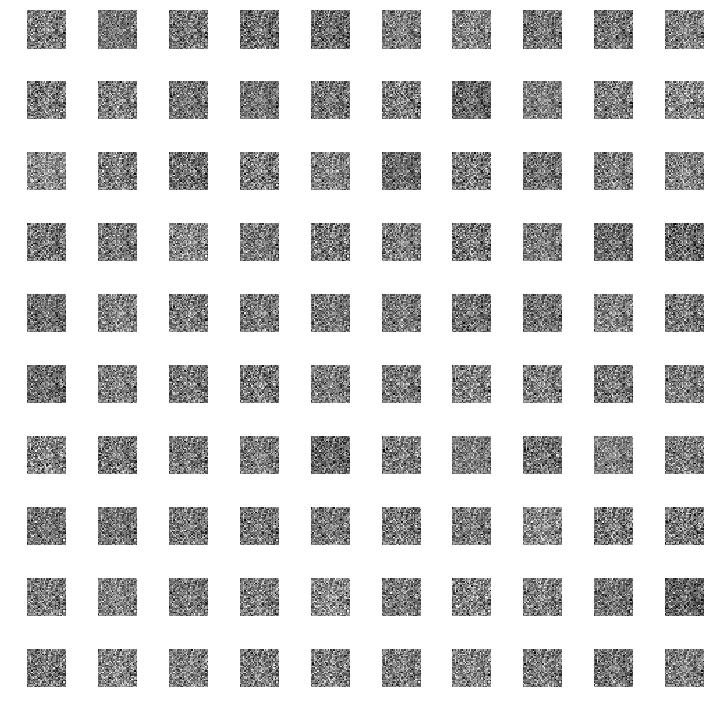

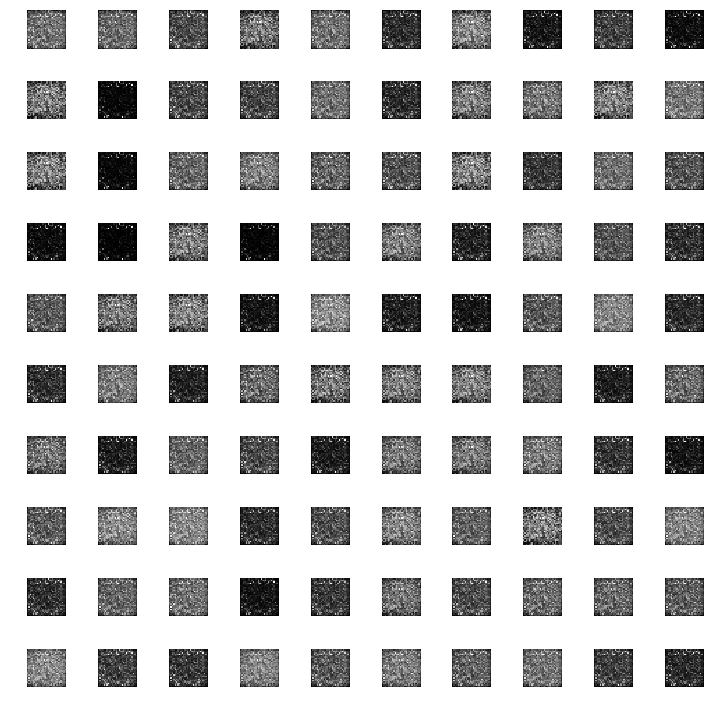

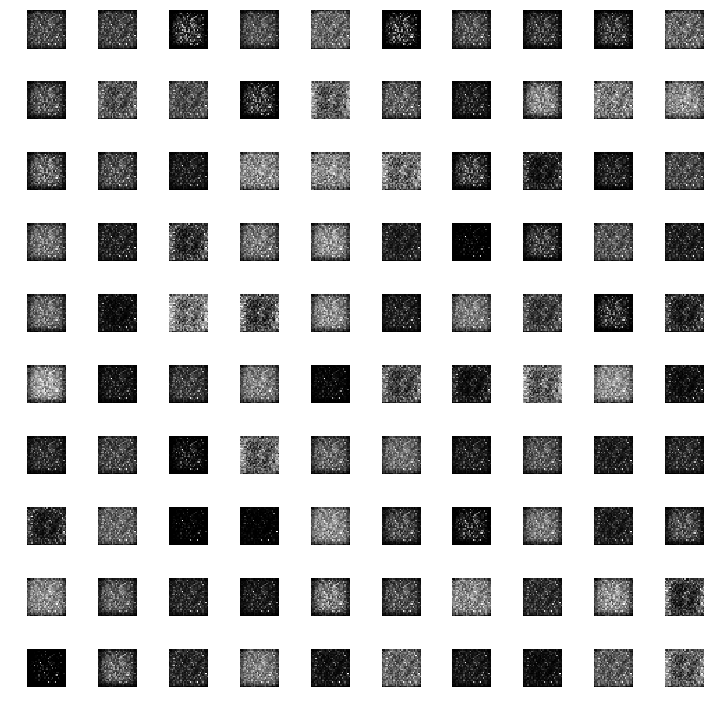

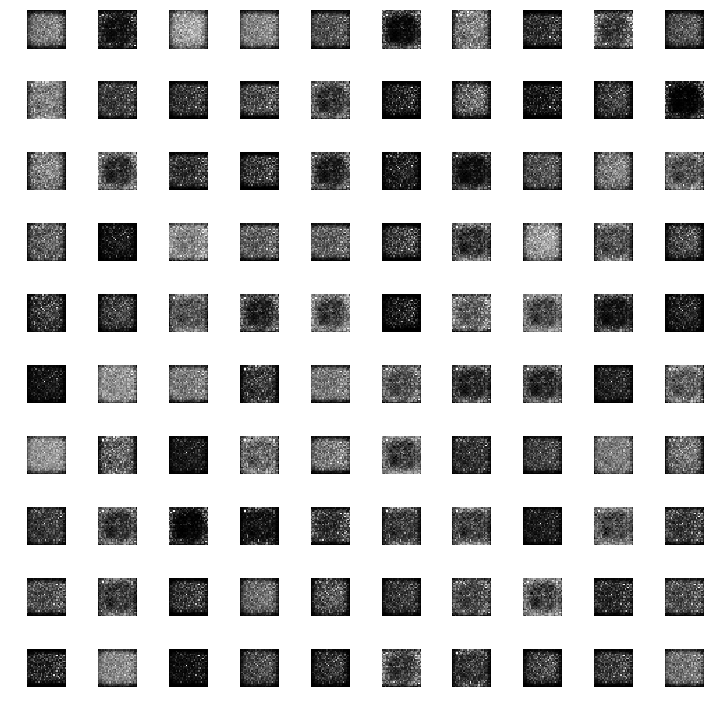

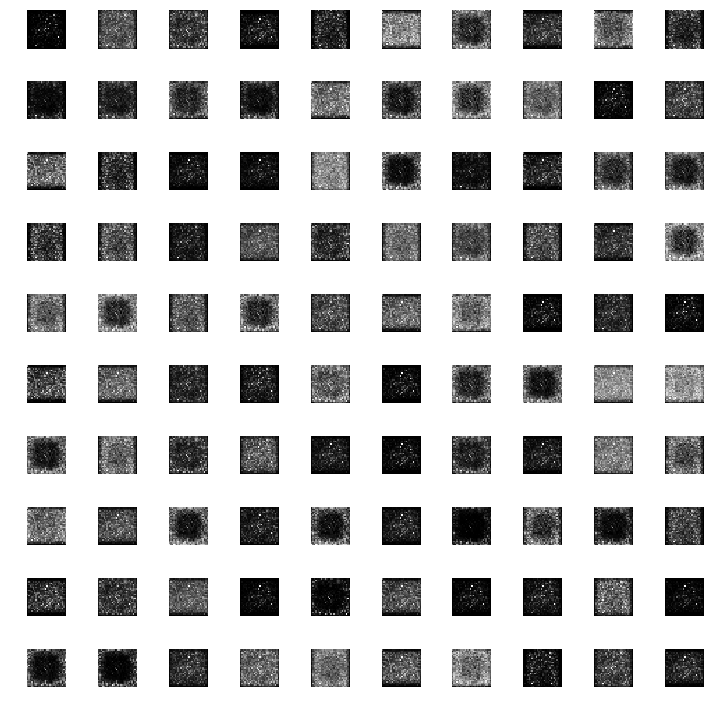

...

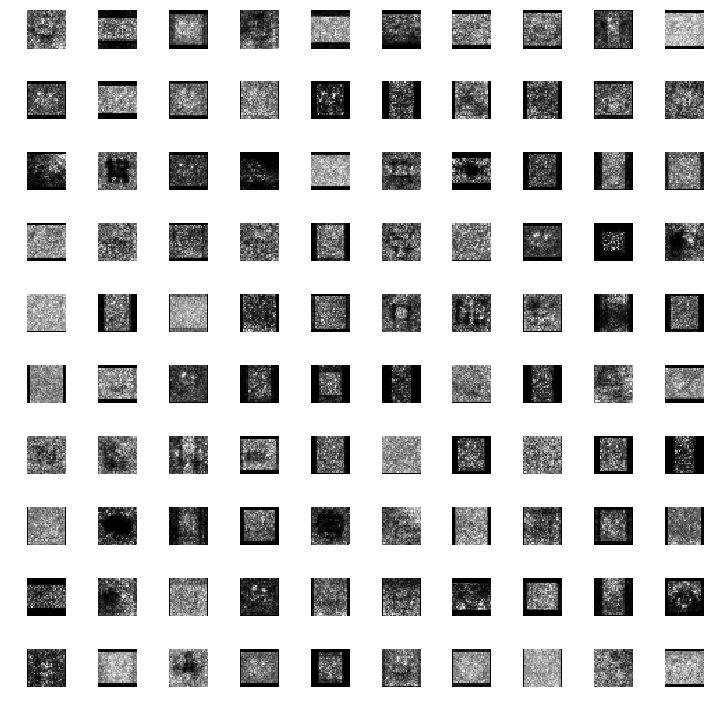

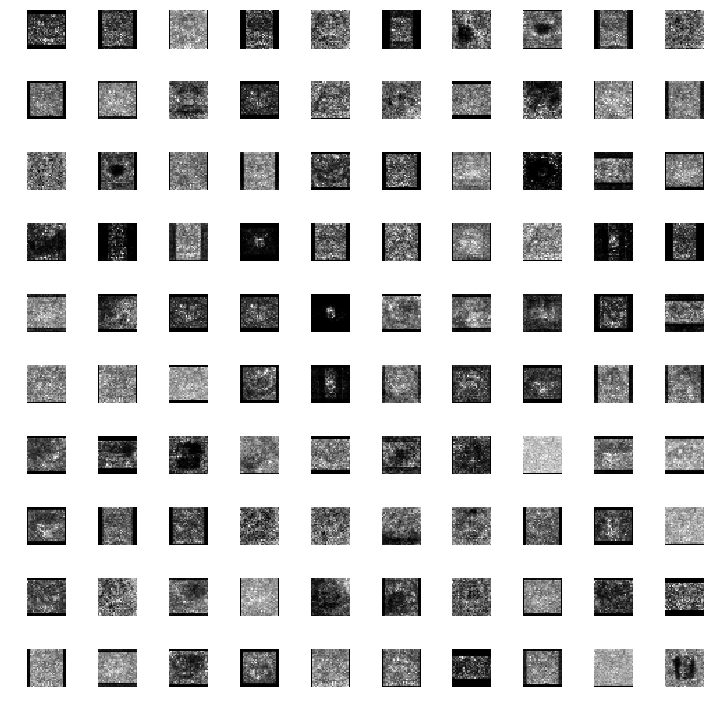

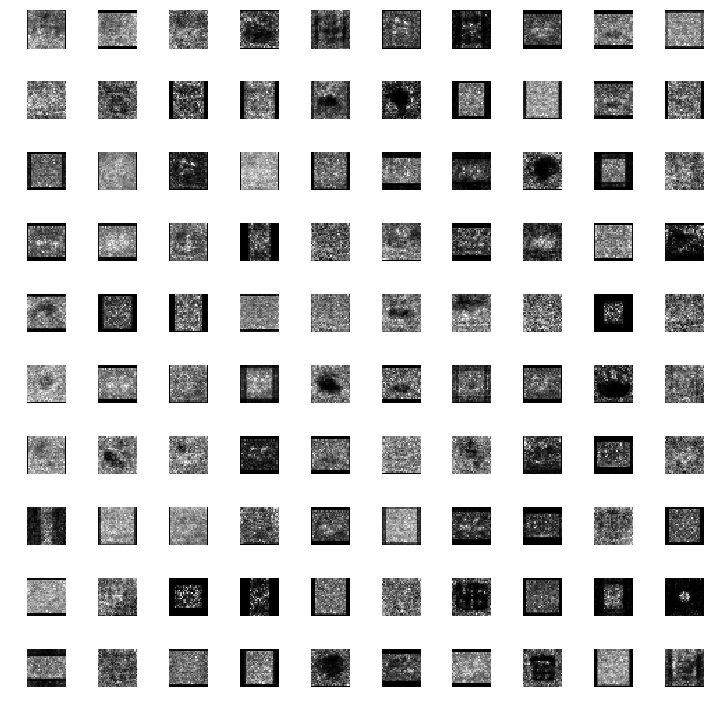

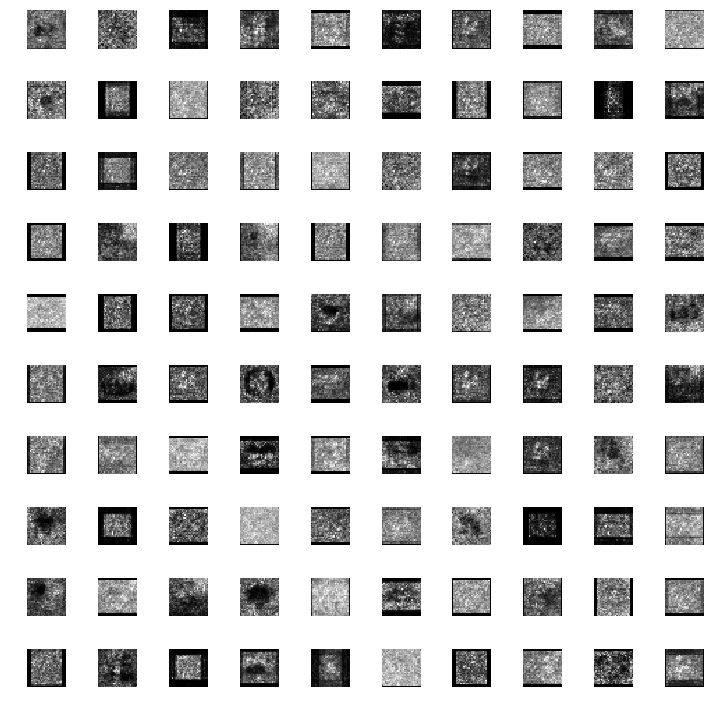

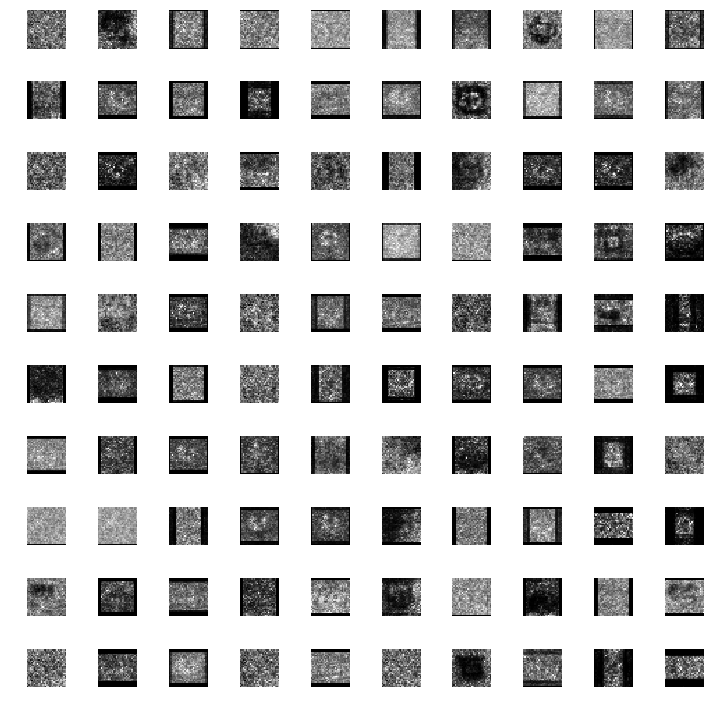

In [ ]:
train(4000, 60, grayscale_emojis)